#Preprocessing

## Install tensorflow 2.0.0-alpha0

In [0]:
!pip install -q tensorflow-gpu==2.0.0-alpha0

    100% |████████████████████████████████| 332.1MB 52kB/s 
    100% |████████████████████████████████| 61kB 28.9MB/s 
    100% |████████████████████████████████| 419kB 13.4MB/s 
    100% |████████████████████████████████| 3.0MB 8.6MB/s 


##Import Module

In [0]:
import tensorflow as tf
tf.config.gpu.set_per_process_memory_growth(True)
print("tensorflow version: %s"%tf.__version__)

tensorflow version: 2.0.0-alpha0


In [0]:
import numpy as np
import pandas as pd
from scipy.io import loadmat, savemat
import matplotlib.pyplot as plt
import zipfile
import os
import time
import zipfile
import re
import cv2
import glob
import imageio
import matplotlib.image as mpimg
from tensorflow.keras import layers
from PIL import Image
from IPython import display
import psutil
%matplotlib inline

##Load Images

In [0]:
ymu = loadmat('Makeup_YMU.mat')
vmu = loadmat('Makeup_VMU.mat')
# miw = loadmat('Makeup_MIW.mat')

In [0]:
vmu_names = vmu['VMU_filenames']
vmu_names = vmu_names.reshape(vmu_names.shape[1])
vmu_names = np.array([i[0] for i in vmu_names])
print(vmu_names.shape)
ymu_names = ymu['YMU_filenames']
ymu_names = ymu_names.reshape(ymu_names.shape[1])
ymu_names = np.array([i[0] for i in ymu_names])
print(ymu_names.shape)

(257,)
(604,)


In [0]:
def swap_image(data):
    '''
    reshape and swap the axies of the original data to make the image visble 
    '''
    new_data = data.reshape(3, 130, 150, data.shape[1])
    new_data = np.swapaxes(new_data, 0, 2)
    new_data = np.swapaxes(new_data, 2, 3)
    new_data = np.swapaxes(new_data, 1, 2)
    new_data = np.swapaxes(new_data, 0, 1)
    return new_data

In [0]:
ymu_data = swap_image(ymu['YMU_matrix'])
vmu_data = swap_image(vmu['VMU_matrix'])
# miw_data = swap_image(miw['MIW_matrix'])

In [0]:
print(cv2.__version__)

3.4.3


In [0]:
ymu_n = [i for i in range(ymu_names.shape[0]) if ymu_names[i].split("_")[2]=="n.jpg"]
print(len(ymu_n))
ymu_y = [i for i in range(ymu_names.shape[0]) if ymu_names[i].split("_")[2]=="y.jpg"]
print(len(ymu_y))
vmu_n = [i for i in range(vmu_names.shape[0]) if len(vmu_names[i].split("_"))==1]
print(len(vmu_n))
vmu_y = [i for i in range(vmu_names.shape[0]) if len(vmu_names[i].split("_"))==2 and vmu_names[i].split("_")[1]=="mu.jpg"]
print(len(vmu_y))
vmu_e = [i for i in range(vmu_names.shape[0]) if len(vmu_names[i].split("_"))==2 and vmu_names[i].split("_")[1]=="e.jpg"]
print(len(vmu_e))
vmu_l = [i for i in range(vmu_names.shape[0]) if len(vmu_names[i].split("_"))==2 and vmu_names[i].split("_")[1]=="l.jpg"]
print(len(vmu_l))

302
302
104
51
51
51


In [0]:
ymu_n_data = ymu_data[ymu_n]
ymu_y_data = ymu_data[ymu_y]
vmu_n_data = ymu_data[vmu_n]
vmu_y_data = ymu_data[vmu_y]
vmu_dict = {k.split(".")[0]: v for k, v in zip(vmu_names[vmu_n], vmu_n)}
vmu_n_n = [i.split(".")[0] for i in vmu_names[vmu_n]]
vmu_e_n = [vmu_dict[i.split("_")[0]] for i in vmu_names[vmu_y] if i.split("_")[0] in vmu_n_n]
data_n = np.concatenate((ymu_data[ymu_n], vmu_data[vmu_e_n]), axis=0)
data_y = np.concatenate((ymu_data[ymu_y], vmu_data[vmu_y]), axis=0)
data_n = np.array([cv2.resize(i, dsize=(128, 128)) for i in data_n])
data_y = np.array([cv2.resize(i, dsize=(128, 128)) for i in data_y])
data_n = np.concatenate((data_n, np.flip(data_n, 2)), axis=0)
data_y = np.concatenate((data_y, np.flip(data_y, 2)), axis=0)
print(data_n.shape)
print(data_y.shape)

(706, 128, 128, 3)
(706, 128, 128, 3)


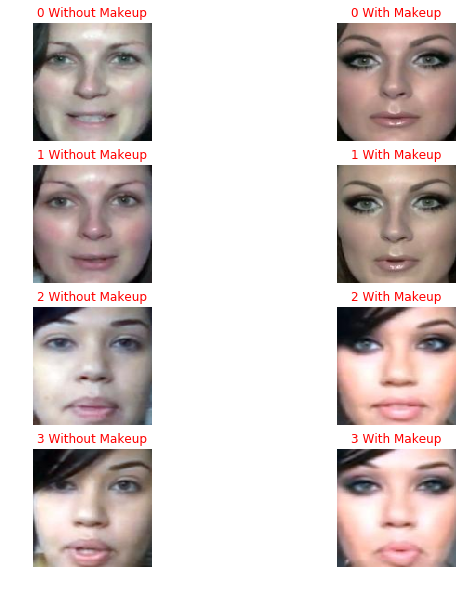

In [0]:
fig, axs = plt.subplots(4, 2, figsize=(10,10))
for i in range(4):
    axs[i,0].imshow(data_n[i])
    axs[i,1].imshow(data_y[i])
    axs[i,0].set_title("%d Without Makeup"%i, color='r')
    axs[i,1].set_title("%d With Makeup"%i, color='r')
    axs[i,0].axis("off")
    axs[i,1].axis("off")
plt.show()

In [0]:
np.save("data_y.npy", data_y)
np.save("data_n.npy", data_n)
savemat("Processed_data.mat",{"data_y":data_y, "data_n":data_n})

##Directly Load Processed Image Data

In [0]:
full_data = loadmat("Processed_data.mat")
data_y = full_data['data_y']
data_n = full_data['data_n']

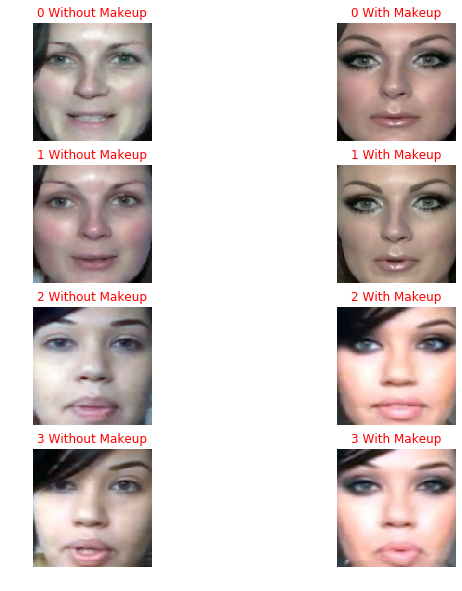

In [0]:
data_n = (data_n / 127.5) - 1.
data_y = (data_y / 127.5) - 1.
data_n = np.float32(data_n)
data_y = np.float32(data_y)
fig, axs = plt.subplots(4, 2, figsize=(10,10))
for i in range(4):
    axs[i,0].imshow(((data_n[i]+1.)*127.5).astype(int))
    axs[i,1].imshow(((data_y[i]+1.)*127.5).astype(int))
    axs[i,0].set_title("%d Without Makeup"%i, color='r')
    axs[i,1].set_title("%d With Makeup"%i, color='r')
    axs[i,0].axis("off")
    axs[i,1].axis("off")
plt.show()

#GAN

##Model Setting

In [0]:
OUTPUT_CHANNELS = 3
def downsample(filters, size, apply_batchnorm=True, apply_dropout=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2,
                            padding='same',
                             kernel_initializer=initializer,
                      use_bias=False))
    
    if apply_batchnorm:
        result.add(layers.BatchNormalization())
    result.add(layers.LeakyReLU())
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    return result

def upsample(filters, size, apply_batchnorm=True, apply_dropout=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2,
                            padding='same',
                             kernel_initializer=initializer,
                      use_bias=False))
    
    if apply_batchnorm:
        result.add(layers.BatchNormalization())
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    result.add(layers.ReLU())
    return result

In [0]:
def make_generator_model():
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(256, 4),
        downsample(256, 4),
        downsample(256, 4),
        downsample(256, 4),
    ]
    
    up_stack = [
        upsample(256, 4, apply_dropout=True),
        upsample(256, 4, apply_dropout=True),
        upsample(256, 4, apply_dropout=True),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4),
    ]
    
    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                           strides=2,
                                           padding='same',
                                           kernel_initializer=initializer,
                                           activation='tanh')
    concat = layers.Concatenate()
    
    inputs = layers.Input(shape=(128, 128, 3))
    x = inputs
    
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
        
    skips = reversed(skips[:-1])
    
    for e, (up, skip) in enumerate(zip(up_stack, skips)):
        x = up(x)
        x = concat([x, skip])
        
    x = last(x)
    
    return tf.keras.Model(inputs=inputs, outputs=x)

In [0]:
def make_discriminator_model():
    initializer = tf.random_normal_initializer(0., 0.02)
    d_input = layers.Input(shape=(128, 128, 3), name='input_image')
    d_target = layers.Input(shape=(128, 128, 3), name='target_image')
    x = layers.concatenate([d_input, d_target])
    down1 = downsample(64, 4, apply_batchnorm=False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)
    zero_pad1 = layers.ZeroPadding2D()(down3)
    conv = layers.Conv2D(512, 4, 
                      strides=1, 
                      kernel_initializer=initializer, 
                      use_bias=False)(zero_pad1)
    batchnorm1 = layers.BatchNormalization()(conv)
    leaky_relu = layers.LeakyReLU()(batchnorm1)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)
    last = layers.Conv2D(1,
                      (4, 4),
                      strides=1,
                      kernel_initializer=initializer)(zero_pad2)
    return tf.keras.Model(inputs=[d_input, d_target], outputs=last)

In [0]:
LAMBDA = 100
GP_LAMBDA = 10
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(disc_real_output, disc_generated_output, gen_output, 
                       mode="cross_entropy"):
    assert mode in [ "cross_entropy", "wasserstein"], "no such loss mode"
    if mode == "cross_entropy":
        
        real_loss = cross_entropy(tf.ones_like(disc_real_output),
                                  disc_real_output)
        generated_loss = cross_entropy(tf.zeros_like(disc_generated_output),
                                       disc_generated_output)

        total_disc_loss = real_loss + generated_loss
    else:
        generated_loss = tf.reduce_mean(disc_generated_output)
        real_loss = - tf.reduce_mean(disc_real_output)

        total_disc_loss =  real_loss + generated_loss
    return total_disc_loss

def generator_loss(disc_generated_output, gen_output, target,
                   mode="cross_entropy", extra_loss="L1"):
    assert mode in ["cross_entropy", "wasserstein"], "no such loss mode"
    assert extra_loss in ["L1", "SSIM"], "no such extra loss"
    if mode == "cross_entropy":
        gen_loss = cross_entropy(tf.ones_like(disc_generated_output),
                                 disc_generated_output)
    else:
        gen_loss = - tf.reduce_mean(disc_generated_output)
    if extra_loss == "L1":
        extra_loss = tf.reduce_mean(tf.abs(target - gen_output))
    else:
        extra_loss = -tf.image.ssim(gen_output, target, 2.0)
    total_gen_loss = gen_loss + (LAMBDA * extra_loss)

    return total_gen_loss, extra_loss

In [0]:
@tf.function
def train_step(data_y_b, data_n_b, b_iter, mode,  extra_loss, n_critic = 5):
    assert mode in ["cross_entropy", "wasserstein"], "no such loss mode"
    assert extra_loss in ["L1", "SSIM"], "no such extra loss"
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(data_y_b, training=True)
        real_output = discriminator(inputs=[data_n_b, data_y_b], training=True)
        fake_output = discriminator(inputs=[generated_images, data_y_b], training=True)
        disc_loss = discriminator_loss(real_output, fake_output, generated_images, mode)
        if mode == "wasserstein":
            grad_gen = tf.gradients(fake_output, generated_images)
            norm = tf.norm(tf.reshape(grad_gen, [tf.shape(grad_gen)[0], -1]), axis=1)
            grad_pen = tf.reduce_mean((norm - 1.)**2)
            disc_loss = disc_loss + (GP_LAMBDA*grad_pen)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
        if mode == "cross_entropy" or b_iter % 5 == 0:
            gen_loss, l1_loss = generator_loss(fake_output, generated_images, data_n_b, mode, extra_loss)
            gradients_of_generator = gen_tape.gradient(gen_loss,
                                                       generator.trainable_variables)
    if mode == "cross_entropy" or b_iter % 5 == 0:
        generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
@tf.function
def calculate_test_loss(test_input, target, mode, extra_loss):
    assert mode in ["cross_entropy", "wasserstein"], "no such loss mode"
    assert extra_loss in ["L1", "SSIM"], "no such extra loss"
    generated_images = generator(test_input, training=False) 
    real_output = discriminator(inputs=[target, test_input], training=False)
    fake_output = discriminator(inputs=[generated_images, test_input], training=False)
    disc_loss = discriminator_loss(real_output, fake_output, generated_images, mode)
    if extra_loss == "L1":
        gen_loss, mae_loss = generator_loss(fake_output, generated_images, target, mode, extra_loss)
        ssim = tf.image.ssim(generated_images, target, 2.0)
        return gen_loss, disc_loss, mae_loss, ssim
    else:
        gen_loss, ssim_loss = generator_loss(fake_output, generated_images, target, mode, extra_loss)
        mae_loss = tf.reduce_mean(tf.abs(target - generated_images))
        return gen_loss, disc_loss, mae_loss, -ssim_loss 

In [0]:
def generate_and_save_images(model, epoch, test_input, image_dir, batch=None):
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10,6))
    
    for i in range(predictions.shape[0]):
        plt.subplot(2, 4, i+1)
        plt.imshow(np.array((predictions[i]*127.5)+127.5).astype(int))
        plt.axis('off')
    if batch is not None:
        plt.suptitle('Image at Epoch {:04d} Batch {:03d}'.format(epoch, batch), fontsize=18)
        save_path = os.path.join(image_dir,
                                 'image_at_epoch_{:04d}_batch_{:03d}.png'.format(epoch, batch))
        plt.savefig(save_path)
    else:
        plt.suptitle('Image at Epoch {:04d} Batch End'.format(epoch), fontsize=18)
        save_path = os.path.join(image_dir,
                                 'image_at_epoch_{:04d}_batch_end.png'.format(epoch) )
        plt.savefig(save_path)
    plt.show()
    return predictions

In [0]:
def train(epochs, mode, extra_loss, n_critic=5):
    assert mode in [ "cross_entropy", "wasserstein"], "no such loss mode"
    assert extra_loss in ["L1", "SSIM"], "no such extra loss"
    file_path = "./{}_{}".format(mode, extra_loss)
    if not os.path.isdir(file_path):
        os.mkdir(file_path)
    checkpoint_dir = os.path.join(file_path, 'training_checkpoints')
    checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
    checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                     discriminator_optimizer=discriminator_optimizer,
                                     generator=generator,
                                     discriminator=discriminator)

    start = time.time()
    for epoch in range(epochs):
        e_start =time.time()
        print('Epoch {} starts!'.format(epoch + 1))
        for i, (data_y_b, data_n_b) in enumerate(train_data):
            train_step(data_y_b, data_n_b, i, mode, extra_loss, n_critic)

        train_g_loss, train_d_loss, train_mae, train_ssim  = calculate_test_loss(t_data_y,
                                                                     t_data_n, mode, extra_loss)
        test_g_loss, test_d_loss, test_mae, test_ssim = calculate_test_loss(t_test_data_y,
                                                                  t_test_data_n, mode, extra_loss)
        if epoch == 0:
            train_gl_list = [tf.reduce_mean(train_g_loss).numpy()]
            train_dl_list = [tf.reduce_mean(train_d_loss).numpy()]
            train_mae_list = [tf.reduce_mean(train_mae).numpy()]
            train_ssim_list = [tf.reduce_mean(train_ssim).numpy()]
            test_gl_list = [tf.reduce_mean(test_g_loss).numpy()]
            test_dl_list = [tf.reduce_mean(test_d_loss).numpy()]
            test_mae_list = [tf.reduce_mean(test_mae).numpy()]
            test_ssim_list = [tf.reduce_mean(test_ssim).numpy()]
        else:
            train_gl_list.append(tf.reduce_mean(train_g_loss).numpy())
            train_dl_list.append(tf.reduce_mean(train_d_loss).numpy())
            train_mae_list.append(tf.reduce_mean(train_mae).numpy())
            train_ssim_list.append(tf.reduce_mean(train_ssim).numpy())
            test_gl_list.append(tf.reduce_mean(test_g_loss).numpy())
            test_dl_list.append(tf.reduce_mean(test_d_loss).numpy())
            test_mae_list.append(tf.reduce_mean(test_mae).numpy())
            test_ssim_list.append(tf.reduce_mean(test_ssim).numpy())
        end = time.time()
        print('Time for epoch {} is {:03f} sec, Total time is {:03f} sec'.format(epoch + 1, end-e_start, end-start))
        print('Train SSIM: %.3f, Test SSIM %.3f, Train MAE: %.3f, Test MAE: %.3f'%(
            train_ssim_list[-1], test_ssim_list[-1],
            train_mae_list[-1], test_mae_list[-1]))
        if (epoch + 1) % 5 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)
            generator.save(file_path+'/my_gen.h5')
            discriminator.save(file_path+'/my_dis.h5')
            final_pred = generate_and_save_images(generator,
                                 epoch + 1,
                                 test_data_sample_y, file_path)

        
    generator.save(file_path+'/my_gen.h5')
    discriminator.save(file_path+'/my_dis.h5')
    return final_pred.numpy(), train_gl_list, train_dl_list, train_mae_list, train_ssim_list, test_gl_list, test_dl_list, test_mae_list, test_ssim_list     

In [0]:
def re_train(last_epoch, epochs, mode, extra_loss, n_critic=5):
    assert mode in [ "cross_entropy", "wasserstein"], "no such loss mode"
    assert extra_loss in ["L1", "SSIM"], "no such extra loss"
    file_path = "./{}_{}".format(mode, extra_loss)
    if not os.path.isdir(file_path):
        os.mkdir(file_path)
    checkpoint_dir = os.path.join(file_path, 'training_checkpoints')
    checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
    checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                     discriminator_optimizer=discriminator_optimizer,
                                     generator=generator,
                                     discriminator=discriminator)
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

    start = time.time()
#     if mode == "wasserstein":
#         clip_d = [p.assign(tf.clip_by_value(p, -0.05, 0.05)) for p in discriminator.trainable_variables]
    for epoch in range(last_epoch, last_epoch+epochs):
        e_start =time.time()
        print('Epoch {} starts!'.format(epoch + 1))
        for i, (data_y_b, data_n_b) in enumerate(train_data):
            train_step(data_y_b, data_n_b, i, mode, extra_loss, n_critic)

        train_g_loss, train_d_loss, train_mae, train_ssim  = calculate_test_loss(t_data_y,
                                                                     t_data_n, mode, extra_loss)
        test_g_loss, test_d_loss, test_mae, test_ssim = calculate_test_loss(t_test_data_y,
                                                                  t_test_data_n, mode, extra_loss)
        if epoch == last_epoch:
            train_gl_list = [tf.reduce_mean(train_g_loss).numpy()]
            train_dl_list = [tf.reduce_mean(train_d_loss).numpy()]
            train_mae_list = [tf.reduce_mean(train_mae).numpy()]
            train_ssim_list = [tf.reduce_mean(train_ssim).numpy()]
            test_gl_list = [tf.reduce_mean(test_g_loss).numpy()]
            test_dl_list = [tf.reduce_mean(test_d_loss).numpy()]
            test_mae_list = [tf.reduce_mean(test_mae).numpy()]
            test_ssim_list = [tf.reduce_mean(test_ssim).numpy()]
        else:
            train_gl_list.append(tf.reduce_mean(train_g_loss).numpy())
            train_dl_list.append(tf.reduce_mean(train_d_loss).numpy())
            train_mae_list.append(tf.reduce_mean(train_mae).numpy())
            train_ssim_list.append(tf.reduce_mean(train_ssim).numpy())
            test_gl_list.append(tf.reduce_mean(test_g_loss).numpy())
            test_dl_list.append(tf.reduce_mean(test_d_loss).numpy())
            test_mae_list.append(tf.reduce_mean(test_mae).numpy())
            test_ssim_list.append(tf.reduce_mean(test_ssim).numpy())
        end = time.time()
        print('Time for epoch {} is {:03f} sec, Total time is {:03f} sec'.format(epoch + 1, end-e_start, end-start))
        print('Train SSIM: %.3f, Test SSIM %.3f, Train MAE: %.3f, Test MAE: %.3f'%(
            train_ssim_list[-1], test_ssim_list[-1],
            train_mae_list[-1], test_mae_list[-1]))
        if (epoch + 1) % 5 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)
            generator.save(file_path+'/my_gen.h5')
            discriminator.save(file_path+'/my_dis.h5')
            final_pred = generate_and_save_images(generator,
                                 epoch + 1,
                                 test_data_sample_y, file_path)

        
    generator.save(file_path+'/my_gen.h5')
    discriminator.save(file_path+'/my_dis.h5')
    return final_pred.numpy(), train_gl_list, train_dl_list, train_mae_list, train_ssim_list, test_gl_list, test_dl_list, test_mae_list, test_ssim_list

##Processed Data

In [0]:
np.random.seed(100)
test_data_n = data_n[np.random.randint(data_n.shape[0]-1, size=100)]
test_data_y = data_y[np.random.randint(data_y.shape[0]-1, size=100)]
t_test_data_y = tf.convert_to_tensor(test_data_y)
t_test_data_n = tf.convert_to_tensor(test_data_n)
TEST_SAMPLE = [10,100,190,250,400,500,650,670]
test_data_sample_y = data_y[TEST_SAMPLE]
test_data_sample_n = data_n[TEST_SAMPLE]
t_data_y = tf.convert_to_tensor(data_y)
t_data_n = tf.convert_to_tensor(data_n)
t_test_data_sample_y = tf.convert_to_tensor(test_data_sample_y)

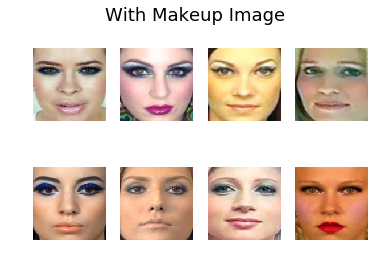

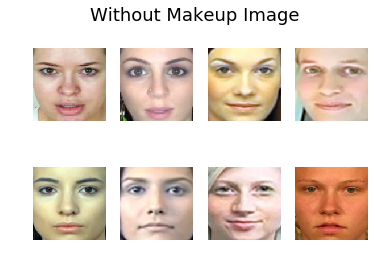

In [0]:
for i in range(test_data_sample_y.shape[0]):
    plt.subplot(2, 4, i+1)
    plt.imshow(np.array((test_data_sample_y[i]*127.5)+127.5).astype(int))
    plt.axis('off')
plt.suptitle('With Makeup Image', fontsize=18)
plt.show()
for i in range(test_data_sample_n.shape[0]):
    plt.subplot(2, 4, i+1)
    plt.imshow(np.array((test_data_sample_n[i]*127.5)+127.5).astype(int))
    plt.axis('off')
plt.suptitle('Without Makeup Image', fontsize=18)
plt.show()

In [0]:
EPOCHS = 100
BUFFER_SIZE = 720
BATCH_SIZE = 20

In [0]:
train_data = tf.data.Dataset.from_tensor_slices((data_y, data_n))
test_data = tf.data.Dataset.from_tensor_slices((test_data_y, test_data_n))
train_data = train_data.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
print(train_data)

<BatchDataset shapes: ((None, 128, 128, 3), (None, 128, 128, 3)), types: (tf.float32, tf.float32)>


##Functions to save results

In [0]:
def zip_image(mode, extra_loss):
    file_path = "./{}_{}".format(mode, extra_loss)
    filenames = glob.glob(file_path+'/image*.png')
    with zipfile.ZipFile(file_path+'/GAN_Image.zip', 'w') as z:
        for image in filenames:
            z.write(image)

def create_gif(mode, extra_loss, duration=0.5):
    file_path = "./{}_{}".format(mode, extra_loss)
    anim_file = file_path+'/gan_epoch.gif'
    with imageio.get_writer(anim_file, mode='I', duration=duration) as writer:
        filenames = glob.glob(file_path+'/image*.png')
        filenames = sorted(filenames)
        for i,filename in enumerate(filenames):
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

def save_hist(result_tuple, i, mode, extra_loss):
    file_path = "./{}_{}".format(mode, extra_loss)
    save_dir = os.path.join(file_path, 'training_his_%d.mat'%i)
    if tf.is_tensor(result_tuple[0]):
        savemat(save_dir,{"final_result":result_tuple[0].numpy(),
                          "train_gl":result_tuple[1],
                          "train_dl":result_tuple[2],
                          "train_mae":result_tuple[3],
                          "train_ssim":result_tuple[4],
                          "test_gl":result_tuple[5],
                          "test_dl":result_tuple[6],
                          "test_mae":result_tuple[7],
                          "test_ssim":result_tuple[8]})
    else:
        savemat(save_dir,{"final_result":result_tuple[0],
                          "train_gl":result_tuple[1],
                          "train_dl":result_tuple[2],
                          "train_mae":result_tuple[3],
                          "train_ssim":result_tuple[4],
                          "test_gl":result_tuple[5],
                          "test_dl":result_tuple[6],
                          "test_mae":result_tuple[7],
                          "test_ssim":result_tuple[8]})     

##'wasserstein', 'SSIM'

Epoch 1 starts!
Time for epoch 1 is 238.864788 sec, Total time is 238.864790 sec
Train SSIM: 0.037, Test SSIM 0.032, Train MAE: 0.433, Test MAE: 0.425
Epoch 2 starts!
Time for epoch 2 is 10.336490 sec, Total time is 249.201496 sec
Train SSIM: 0.081, Test SSIM 0.064, Train MAE: 0.415, Test MAE: 0.412
Epoch 3 starts!
Time for epoch 3 is 10.145785 sec, Total time is 259.347772 sec
Train SSIM: 0.138, Test SSIM 0.109, Train MAE: 0.393, Test MAE: 0.396
Epoch 4 starts!
Time for epoch 4 is 9.899627 sec, Total time is 269.248095 sec
Train SSIM: 0.196, Test SSIM 0.153, Train MAE: 0.368, Test MAE: 0.380
Epoch 5 starts!
Time for epoch 5 is 9.880445 sec, Total time is 279.129272 sec
Train SSIM: 0.242, Test SSIM 0.184, Train MAE: 0.346, Test MAE: 0.367


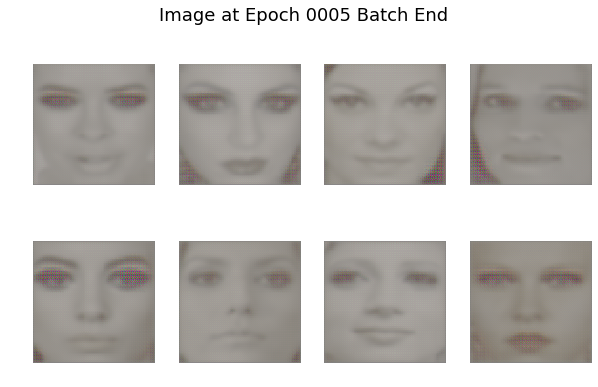

Epoch 6 starts!
Time for epoch 6 is 10.015219 sec, Total time is 290.875901 sec
Train SSIM: 0.280, Test SSIM 0.208, Train MAE: 0.326, Test MAE: 0.359
Epoch 7 starts!
Time for epoch 7 is 10.040040 sec, Total time is 300.916148 sec
Train SSIM: 0.311, Test SSIM 0.225, Train MAE: 0.310, Test MAE: 0.354
Epoch 8 starts!
Time for epoch 8 is 9.942996 sec, Total time is 310.859740 sec
Train SSIM: 0.333, Test SSIM 0.236, Train MAE: 0.298, Test MAE: 0.354
Epoch 9 starts!
Time for epoch 9 is 10.044611 sec, Total time is 320.904923 sec
Train SSIM: 0.348, Test SSIM 0.242, Train MAE: 0.290, Test MAE: 0.356
Epoch 10 starts!
Time for epoch 10 is 10.089367 sec, Total time is 330.994859 sec
Train SSIM: 0.359, Test SSIM 0.245, Train MAE: 0.286, Test MAE: 0.360


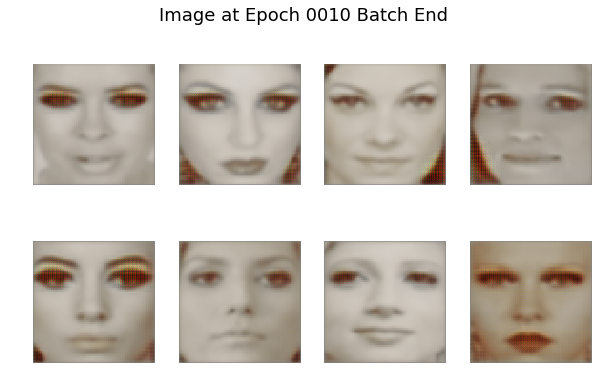

Epoch 11 starts!
Time for epoch 11 is 10.130851 sec, Total time is 342.627660 sec
Train SSIM: 0.368, Test SSIM 0.247, Train MAE: 0.284, Test MAE: 0.365
Epoch 12 starts!
Time for epoch 12 is 10.029319 sec, Total time is 352.657576 sec
Train SSIM: 0.375, Test SSIM 0.248, Train MAE: 0.283, Test MAE: 0.368
Epoch 13 starts!
Time for epoch 13 is 9.962795 sec, Total time is 362.620915 sec
Train SSIM: 0.380, Test SSIM 0.249, Train MAE: 0.283, Test MAE: 0.372
Epoch 14 starts!
Time for epoch 14 is 10.122474 sec, Total time is 372.743986 sec
Train SSIM: 0.385, Test SSIM 0.250, Train MAE: 0.282, Test MAE: 0.375
Epoch 15 starts!
Time for epoch 15 is 10.135028 sec, Total time is 382.879647 sec
Train SSIM: 0.389, Test SSIM 0.249, Train MAE: 0.280, Test MAE: 0.377


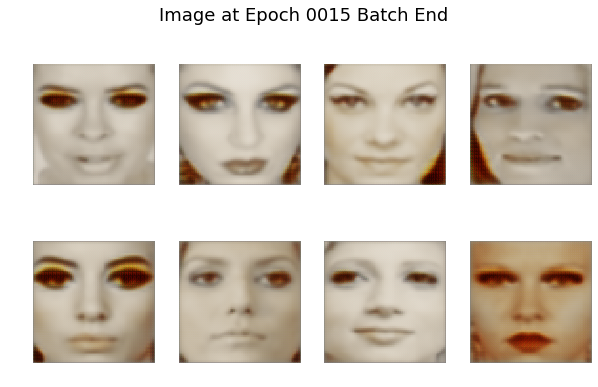

Epoch 16 starts!
Time for epoch 16 is 10.035826 sec, Total time is 394.470857 sec
Train SSIM: 0.393, Test SSIM 0.250, Train MAE: 0.278, Test MAE: 0.377
Epoch 17 starts!
Time for epoch 17 is 9.970991 sec, Total time is 404.442349 sec
Train SSIM: 0.396, Test SSIM 0.250, Train MAE: 0.276, Test MAE: 0.378
Epoch 18 starts!
Time for epoch 18 is 9.992892 sec, Total time is 414.435732 sec
Train SSIM: 0.399, Test SSIM 0.250, Train MAE: 0.273, Test MAE: 0.377
Epoch 19 starts!
Time for epoch 19 is 10.002467 sec, Total time is 424.438730 sec
Train SSIM: 0.402, Test SSIM 0.250, Train MAE: 0.271, Test MAE: 0.378
Epoch 20 starts!
Time for epoch 20 is 10.030927 sec, Total time is 434.470155 sec
Train SSIM: 0.404, Test SSIM 0.250, Train MAE: 0.270, Test MAE: 0.378


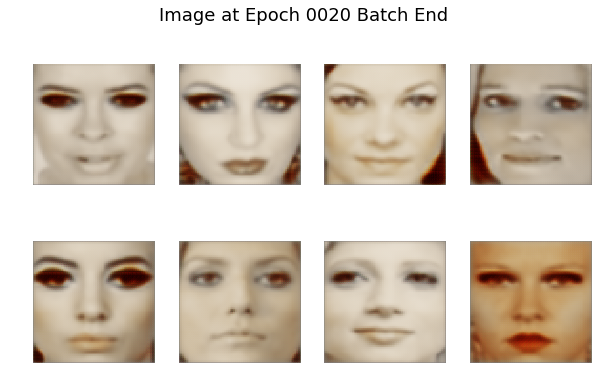

Epoch 21 starts!
Time for epoch 21 is 10.054592 sec, Total time is 446.128393 sec
Train SSIM: 0.406, Test SSIM 0.251, Train MAE: 0.268, Test MAE: 0.377
Epoch 22 starts!
Time for epoch 22 is 10.102759 sec, Total time is 456.231696 sec
Train SSIM: 0.407, Test SSIM 0.251, Train MAE: 0.266, Test MAE: 0.377
Epoch 23 starts!
Time for epoch 23 is 10.086509 sec, Total time is 466.318791 sec
Train SSIM: 0.408, Test SSIM 0.251, Train MAE: 0.265, Test MAE: 0.377
Epoch 24 starts!
Time for epoch 24 is 9.998986 sec, Total time is 476.318341 sec
Train SSIM: 0.409, Test SSIM 0.251, Train MAE: 0.264, Test MAE: 0.377
Epoch 25 starts!
Time for epoch 25 is 9.990231 sec, Total time is 486.309116 sec
Train SSIM: 0.411, Test SSIM 0.251, Train MAE: 0.263, Test MAE: 0.377


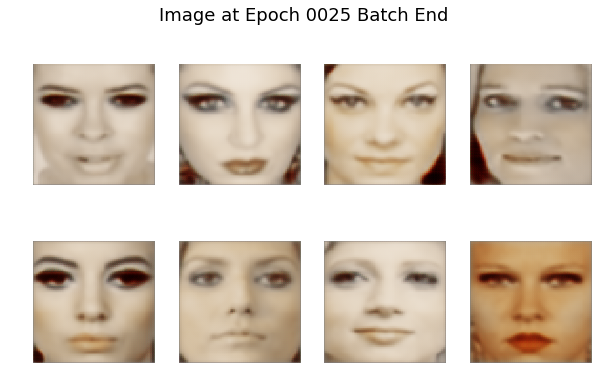

Epoch 26 starts!
Time for epoch 26 is 10.046216 sec, Total time is 498.107028 sec
Train SSIM: 0.412, Test SSIM 0.251, Train MAE: 0.261, Test MAE: 0.376
Epoch 27 starts!
Time for epoch 27 is 9.961255 sec, Total time is 508.068841 sec
Train SSIM: 0.412, Test SSIM 0.252, Train MAE: 0.263, Test MAE: 0.379
Epoch 28 starts!
Time for epoch 28 is 9.948763 sec, Total time is 518.018187 sec
Train SSIM: 0.413, Test SSIM 0.252, Train MAE: 0.262, Test MAE: 0.378
Epoch 29 starts!
Time for epoch 29 is 9.994972 sec, Total time is 528.013717 sec
Train SSIM: 0.414, Test SSIM 0.252, Train MAE: 0.260, Test MAE: 0.377
Epoch 30 starts!
Time for epoch 30 is 10.200855 sec, Total time is 538.215106 sec
Train SSIM: 0.415, Test SSIM 0.252, Train MAE: 0.259, Test MAE: 0.377


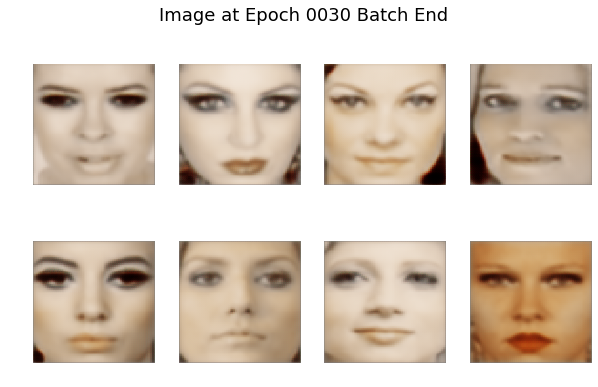

Epoch 31 starts!
Time for epoch 31 is 10.095023 sec, Total time is 549.859022 sec
Train SSIM: 0.415, Test SSIM 0.253, Train MAE: 0.259, Test MAE: 0.378
Epoch 32 starts!
Time for epoch 32 is 9.998359 sec, Total time is 559.858011 sec
Train SSIM: 0.416, Test SSIM 0.253, Train MAE: 0.258, Test MAE: 0.377
Epoch 33 starts!
Time for epoch 33 is 9.987950 sec, Total time is 569.846614 sec
Train SSIM: 0.416, Test SSIM 0.252, Train MAE: 0.259, Test MAE: 0.379
Epoch 34 starts!
Time for epoch 34 is 9.978401 sec, Total time is 579.825500 sec
Train SSIM: 0.418, Test SSIM 0.253, Train MAE: 0.258, Test MAE: 0.378
Epoch 35 starts!
Time for epoch 35 is 10.006523 sec, Total time is 589.832558 sec
Train SSIM: 0.418, Test SSIM 0.253, Train MAE: 0.258, Test MAE: 0.379


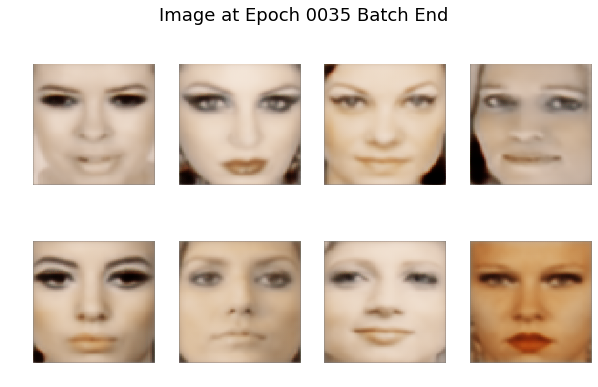

Epoch 36 starts!
Time for epoch 36 is 10.068739 sec, Total time is 601.638800 sec
Train SSIM: 0.419, Test SSIM 0.254, Train MAE: 0.257, Test MAE: 0.379
Epoch 37 starts!
Time for epoch 37 is 9.990721 sec, Total time is 611.630081 sec
Train SSIM: 0.420, Test SSIM 0.254, Train MAE: 0.256, Test MAE: 0.378
Epoch 38 starts!
Time for epoch 38 is 10.161833 sec, Total time is 621.792551 sec
Train SSIM: 0.421, Test SSIM 0.254, Train MAE: 0.254, Test MAE: 0.377
Epoch 39 starts!
Time for epoch 39 is 10.058558 sec, Total time is 631.851708 sec
Train SSIM: 0.421, Test SSIM 0.254, Train MAE: 0.255, Test MAE: 0.377
Epoch 40 starts!
Time for epoch 40 is 10.058453 sec, Total time is 641.910731 sec
Train SSIM: 0.422, Test SSIM 0.255, Train MAE: 0.254, Test MAE: 0.377


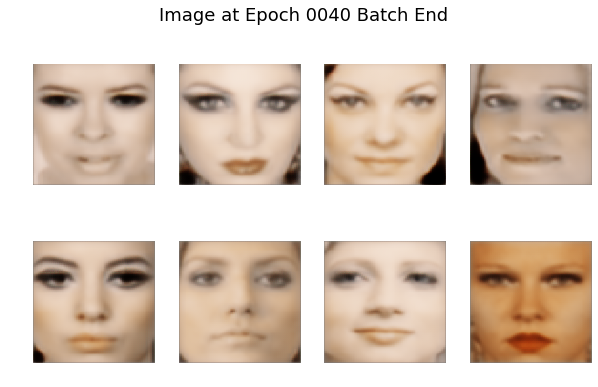

Epoch 41 starts!
Time for epoch 41 is 10.118480 sec, Total time is 653.707594 sec
Train SSIM: 0.422, Test SSIM 0.255, Train MAE: 0.256, Test MAE: 0.379
Epoch 42 starts!
Time for epoch 42 is 10.015565 sec, Total time is 663.723726 sec
Train SSIM: 0.422, Test SSIM 0.256, Train MAE: 0.255, Test MAE: 0.378
Epoch 43 starts!
Time for epoch 43 is 10.040690 sec, Total time is 673.764993 sec
Train SSIM: 0.423, Test SSIM 0.256, Train MAE: 0.253, Test MAE: 0.377
Epoch 44 starts!
Time for epoch 44 is 10.257375 sec, Total time is 684.023015 sec
Train SSIM: 0.424, Test SSIM 0.257, Train MAE: 0.253, Test MAE: 0.377
Epoch 45 starts!
Time for epoch 45 is 10.097986 sec, Total time is 694.121662 sec
Train SSIM: 0.424, Test SSIM 0.257, Train MAE: 0.254, Test MAE: 0.378


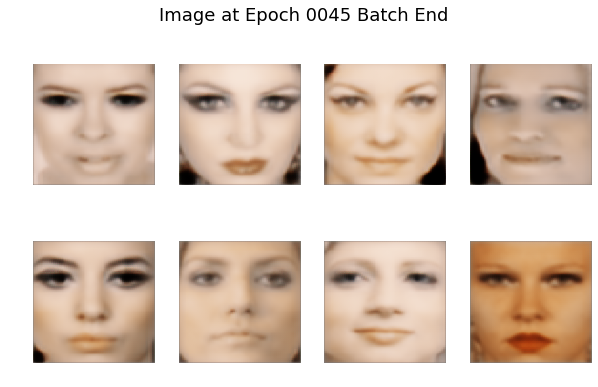

Epoch 46 starts!
Time for epoch 46 is 10.166993 sec, Total time is 706.076277 sec
Train SSIM: 0.425, Test SSIM 0.257, Train MAE: 0.252, Test MAE: 0.377
Epoch 47 starts!
Time for epoch 47 is 9.928402 sec, Total time is 716.005298 sec
Train SSIM: 0.425, Test SSIM 0.258, Train MAE: 0.252, Test MAE: 0.376
Epoch 48 starts!
Time for epoch 48 is 9.949350 sec, Total time is 725.955237 sec
Train SSIM: 0.426, Test SSIM 0.258, Train MAE: 0.251, Test MAE: 0.375
Epoch 49 starts!
Time for epoch 49 is 9.956223 sec, Total time is 735.911966 sec
Train SSIM: 0.427, Test SSIM 0.259, Train MAE: 0.251, Test MAE: 0.375
Epoch 50 starts!
Time for epoch 50 is 9.947620 sec, Total time is 745.860133 sec
Train SSIM: 0.428, Test SSIM 0.259, Train MAE: 0.250, Test MAE: 0.374


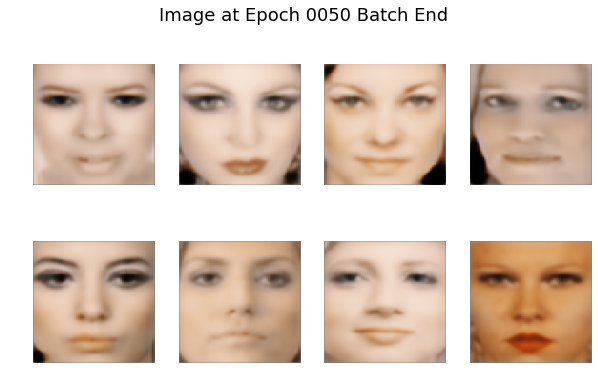

In [0]:
generator = make_generator_model()
discriminator = make_discriminator_model()
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0., beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0., beta_2=0.9)
result_tuples_0 = train(100, 'wasserstein', 'SSIM')

Epoch 51 starts!
Time for epoch 51 is 10.201214 sec, Total time is 10.201217 sec
Train SSIM: 0.427, Test SSIM 0.259, Train MAE: 0.251, Test MAE: 0.375
Epoch 52 starts!
Time for epoch 52 is 10.131262 sec, Total time is 20.332868 sec
Train SSIM: 0.427, Test SSIM 0.260, Train MAE: 0.253, Test MAE: 0.378
Epoch 53 starts!
Time for epoch 53 is 10.163457 sec, Total time is 30.496874 sec
Train SSIM: 0.428, Test SSIM 0.260, Train MAE: 0.250, Test MAE: 0.375
Epoch 54 starts!
Time for epoch 54 is 10.233869 sec, Total time is 40.731283 sec
Train SSIM: 0.429, Test SSIM 0.260, Train MAE: 0.251, Test MAE: 0.376
Epoch 55 starts!
Time for epoch 55 is 10.085052 sec, Total time is 50.816955 sec
Train SSIM: 0.428, Test SSIM 0.260, Train MAE: 0.251, Test MAE: 0.376


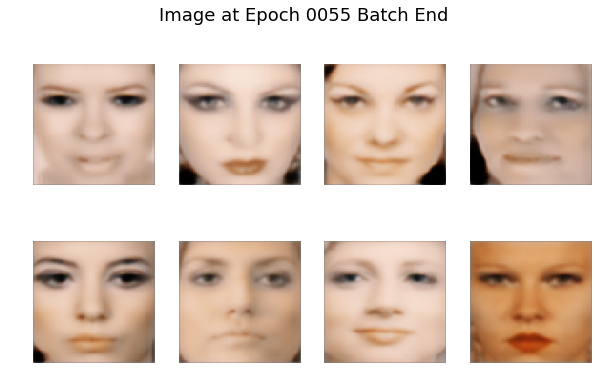

Epoch 56 starts!
Time for epoch 56 is 10.098036 sec, Total time is 62.560568 sec
Train SSIM: 0.430, Test SSIM 0.261, Train MAE: 0.249, Test MAE: 0.374
Epoch 57 starts!
Time for epoch 57 is 9.994856 sec, Total time is 72.556017 sec
Train SSIM: 0.429, Test SSIM 0.261, Train MAE: 0.250, Test MAE: 0.375
Epoch 58 starts!
Time for epoch 58 is 9.962897 sec, Total time is 82.519464 sec
Train SSIM: 0.430, Test SSIM 0.262, Train MAE: 0.248, Test MAE: 0.374
Epoch 59 starts!
Time for epoch 59 is 10.166620 sec, Total time is 92.686296 sec
Train SSIM: 0.430, Test SSIM 0.261, Train MAE: 0.249, Test MAE: 0.374
Epoch 60 starts!
Time for epoch 60 is 9.971409 sec, Total time is 102.658154 sec
Train SSIM: 0.430, Test SSIM 0.262, Train MAE: 0.249, Test MAE: 0.375


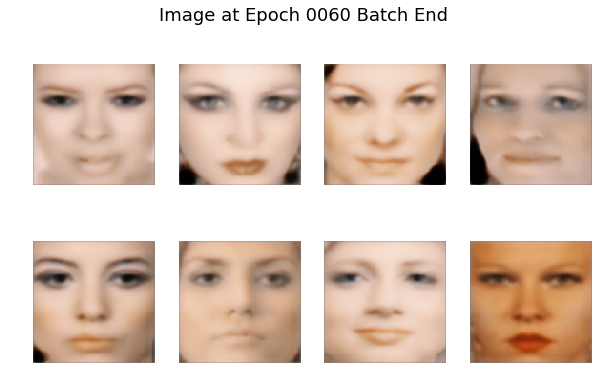

Epoch 61 starts!
Time for epoch 61 is 10.086124 sec, Total time is 114.557171 sec
Train SSIM: 0.431, Test SSIM 0.262, Train MAE: 0.249, Test MAE: 0.374
Epoch 62 starts!
Time for epoch 62 is 10.031397 sec, Total time is 124.589190 sec
Train SSIM: 0.431, Test SSIM 0.263, Train MAE: 0.249, Test MAE: 0.374
Epoch 63 starts!
Time for epoch 63 is 10.057908 sec, Total time is 134.647610 sec
Train SSIM: 0.432, Test SSIM 0.262, Train MAE: 0.248, Test MAE: 0.374
Epoch 64 starts!
Time for epoch 64 is 10.039602 sec, Total time is 144.687701 sec
Train SSIM: 0.432, Test SSIM 0.262, Train MAE: 0.248, Test MAE: 0.374
Epoch 65 starts!
Time for epoch 65 is 10.032011 sec, Total time is 154.720546 sec
Train SSIM: 0.433, Test SSIM 0.263, Train MAE: 0.247, Test MAE: 0.372


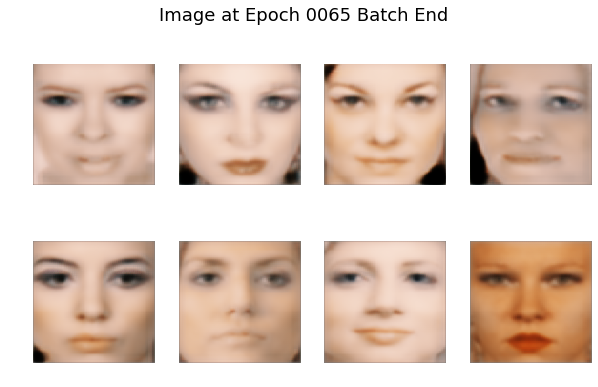

Epoch 66 starts!
Time for epoch 66 is 10.148401 sec, Total time is 166.546023 sec
Train SSIM: 0.433, Test SSIM 0.262, Train MAE: 0.246, Test MAE: 0.372
Epoch 67 starts!
Time for epoch 67 is 10.174537 sec, Total time is 176.721151 sec
Train SSIM: 0.433, Test SSIM 0.262, Train MAE: 0.247, Test MAE: 0.373
Epoch 68 starts!
Time for epoch 68 is 10.005425 sec, Total time is 186.727117 sec
Train SSIM: 0.433, Test SSIM 0.263, Train MAE: 0.247, Test MAE: 0.373
Epoch 69 starts!
Time for epoch 69 is 10.017067 sec, Total time is 196.744821 sec
Train SSIM: 0.433, Test SSIM 0.263, Train MAE: 0.248, Test MAE: 0.374
Epoch 70 starts!
Time for epoch 70 is 10.029009 sec, Total time is 206.774400 sec
Train SSIM: 0.434, Test SSIM 0.263, Train MAE: 0.247, Test MAE: 0.373


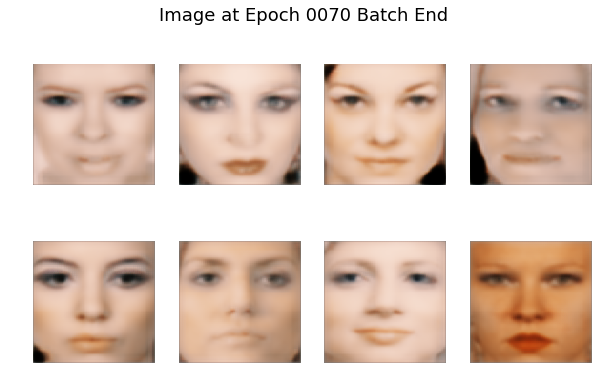

Epoch 71 starts!
Time for epoch 71 is 10.453583 sec, Total time is 218.972316 sec
Train SSIM: 0.434, Test SSIM 0.264, Train MAE: 0.246, Test MAE: 0.372
Epoch 72 starts!
Time for epoch 72 is 10.288299 sec, Total time is 229.260798 sec
Train SSIM: 0.434, Test SSIM 0.263, Train MAE: 0.246, Test MAE: 0.372
Epoch 73 starts!
Time for epoch 73 is 10.022831 sec, Total time is 239.284206 sec
Train SSIM: 0.433, Test SSIM 0.263, Train MAE: 0.248, Test MAE: 0.374
Epoch 74 starts!
Time for epoch 74 is 10.109513 sec, Total time is 249.393917 sec
Train SSIM: 0.435, Test SSIM 0.263, Train MAE: 0.244, Test MAE: 0.371
Epoch 75 starts!
Time for epoch 75 is 10.153069 sec, Total time is 259.547197 sec
Train SSIM: 0.435, Test SSIM 0.263, Train MAE: 0.246, Test MAE: 0.373


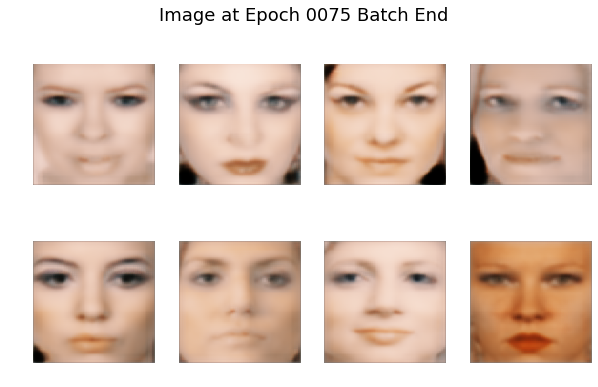

Epoch 76 starts!
Time for epoch 76 is 10.159182 sec, Total time is 271.318214 sec
Train SSIM: 0.435, Test SSIM 0.263, Train MAE: 0.246, Test MAE: 0.372
Epoch 77 starts!
Time for epoch 77 is 10.026607 sec, Total time is 281.345386 sec
Train SSIM: 0.436, Test SSIM 0.263, Train MAE: 0.246, Test MAE: 0.373
Epoch 78 starts!
Time for epoch 78 is 10.022302 sec, Total time is 291.367879 sec
Train SSIM: 0.435, Test SSIM 0.264, Train MAE: 0.246, Test MAE: 0.372
Epoch 79 starts!
Time for epoch 79 is 10.013471 sec, Total time is 301.381800 sec
Train SSIM: 0.436, Test SSIM 0.264, Train MAE: 0.244, Test MAE: 0.371
Epoch 80 starts!
Time for epoch 80 is 9.980790 sec, Total time is 311.363214 sec
Train SSIM: 0.436, Test SSIM 0.264, Train MAE: 0.245, Test MAE: 0.372


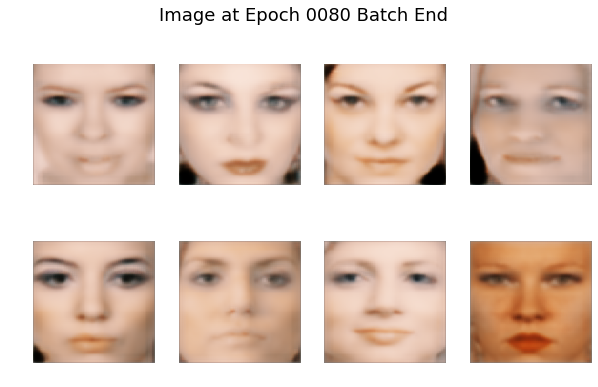

Epoch 81 starts!
Time for epoch 81 is 10.048089 sec, Total time is 323.221018 sec
Train SSIM: 0.437, Test SSIM 0.263, Train MAE: 0.244, Test MAE: 0.371
Epoch 82 starts!
Time for epoch 82 is 10.199708 sec, Total time is 333.421398 sec
Train SSIM: 0.436, Test SSIM 0.264, Train MAE: 0.245, Test MAE: 0.371
Epoch 83 starts!
Time for epoch 83 is 9.972876 sec, Total time is 343.394468 sec
Train SSIM: 0.437, Test SSIM 0.263, Train MAE: 0.244, Test MAE: 0.371
Epoch 84 starts!
Time for epoch 84 is 10.056994 sec, Total time is 353.451968 sec
Train SSIM: 0.437, Test SSIM 0.263, Train MAE: 0.245, Test MAE: 0.372
Epoch 85 starts!
Time for epoch 85 is 10.058453 sec, Total time is 363.511028 sec
Train SSIM: 0.438, Test SSIM 0.264, Train MAE: 0.244, Test MAE: 0.371


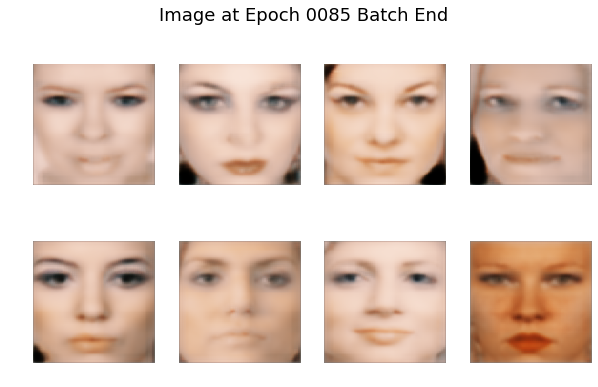

Epoch 86 starts!
Time for epoch 86 is 10.131481 sec, Total time is 375.390421 sec
Train SSIM: 0.438, Test SSIM 0.263, Train MAE: 0.243, Test MAE: 0.370
Epoch 87 starts!
Time for epoch 87 is 9.967280 sec, Total time is 385.358287 sec
Train SSIM: 0.439, Test SSIM 0.265, Train MAE: 0.243, Test MAE: 0.368
Epoch 88 starts!
Time for epoch 88 is 9.999925 sec, Total time is 395.358806 sec
Train SSIM: 0.438, Test SSIM 0.263, Train MAE: 0.244, Test MAE: 0.371
Epoch 89 starts!
Time for epoch 89 is 10.077852 sec, Total time is 405.436861 sec
Train SSIM: 0.439, Test SSIM 0.264, Train MAE: 0.244, Test MAE: 0.371
Epoch 90 starts!
Time for epoch 90 is 10.172444 sec, Total time is 415.609931 sec
Train SSIM: 0.439, Test SSIM 0.264, Train MAE: 0.244, Test MAE: 0.371


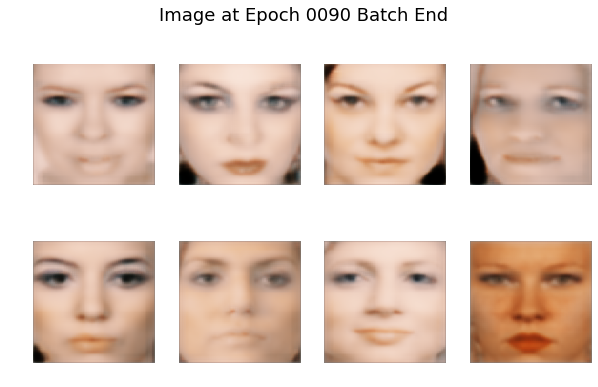

Epoch 91 starts!
Time for epoch 91 is 10.067255 sec, Total time is 427.332211 sec
Train SSIM: 0.440, Test SSIM 0.264, Train MAE: 0.243, Test MAE: 0.370
Epoch 92 starts!
Time for epoch 92 is 9.927486 sec, Total time is 437.260024 sec
Train SSIM: 0.439, Test SSIM 0.265, Train MAE: 0.244, Test MAE: 0.370
Epoch 93 starts!
Time for epoch 93 is 9.942644 sec, Total time is 447.203194 sec
Train SSIM: 0.441, Test SSIM 0.264, Train MAE: 0.242, Test MAE: 0.368
Epoch 94 starts!
Time for epoch 94 is 9.996511 sec, Total time is 457.199884 sec
Train SSIM: 0.440, Test SSIM 0.264, Train MAE: 0.243, Test MAE: 0.370
Epoch 95 starts!
Time for epoch 95 is 10.004030 sec, Total time is 467.204513 sec
Train SSIM: 0.439, Test SSIM 0.264, Train MAE: 0.244, Test MAE: 0.371


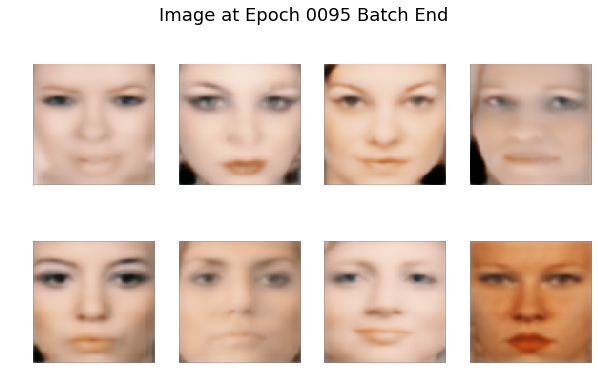

Epoch 96 starts!
Time for epoch 96 is 10.076784 sec, Total time is 478.767824 sec
Train SSIM: 0.439, Test SSIM 0.265, Train MAE: 0.243, Test MAE: 0.369
Epoch 97 starts!
Time for epoch 97 is 10.107252 sec, Total time is 488.875252 sec
Train SSIM: 0.440, Test SSIM 0.264, Train MAE: 0.243, Test MAE: 0.369
Epoch 98 starts!
Time for epoch 98 is 10.175942 sec, Total time is 499.051409 sec
Train SSIM: 0.439, Test SSIM 0.265, Train MAE: 0.244, Test MAE: 0.370
Epoch 99 starts!
Time for epoch 99 is 10.071832 sec, Total time is 509.123859 sec
Train SSIM: 0.441, Test SSIM 0.264, Train MAE: 0.242, Test MAE: 0.369
Epoch 100 starts!
Time for epoch 100 is 10.147180 sec, Total time is 519.271640 sec
Train SSIM: 0.440, Test SSIM 0.266, Train MAE: 0.244, Test MAE: 0.370


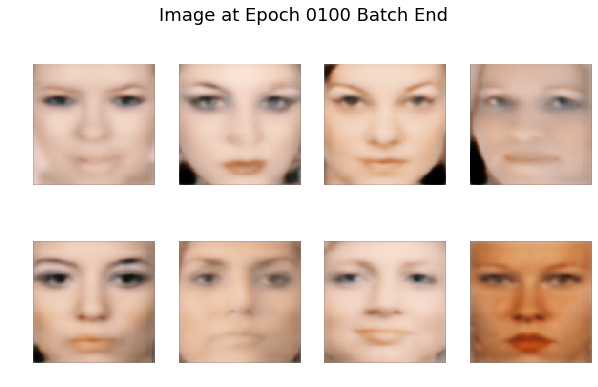

In [0]:
result_tuples_0_1 = re_train(50, 50, 'wasserstein', 'SSIM')

In [0]:
save_hist(result_tuples_0, 0, 'wasserstein', 'SSIM')
save_hist(result_tuples_0_1, 1, 'wasserstein', 'SSIM')
zip_image('wasserstein', 'SSIM')
create_gif('wasserstein', 'SSIM')

##'wasserstein', 'L1'

Epoch 1 starts!
Time for epoch 1 is 240.165285 sec, Total time is 240.165287 sec
Train SSIM: 0.059, Test SSIM 0.050, Train MAE: 0.423, Test MAE: 0.417
Epoch 2 starts!
Time for epoch 2 is 9.811410 sec, Total time is 249.977001 sec
Train SSIM: 0.092, Test SSIM 0.069, Train MAE: 0.409, Test MAE: 0.408
Epoch 3 starts!
Time for epoch 3 is 9.719765 sec, Total time is 259.697324 sec
Train SSIM: 0.131, Test SSIM 0.092, Train MAE: 0.389, Test MAE: 0.395
Epoch 4 starts!
Time for epoch 4 is 9.492343 sec, Total time is 269.190308 sec
Train SSIM: 0.181, Test SSIM 0.120, Train MAE: 0.362, Test MAE: 0.378
Epoch 5 starts!
Time for epoch 5 is 9.402881 sec, Total time is 278.593627 sec
Train SSIM: 0.240, Test SSIM 0.151, Train MAE: 0.327, Test MAE: 0.359


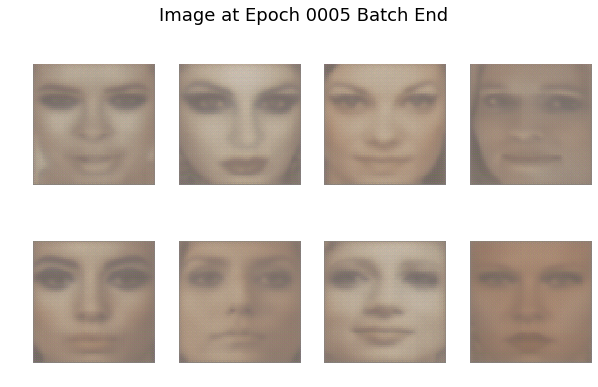

Epoch 6 starts!
Time for epoch 6 is 9.471655 sec, Total time is 289.960715 sec
Train SSIM: 0.293, Test SSIM 0.177, Train MAE: 0.290, Test MAE: 0.344
Epoch 7 starts!
Time for epoch 7 is 9.403438 sec, Total time is 299.364733 sec
Train SSIM: 0.332, Test SSIM 0.195, Train MAE: 0.262, Test MAE: 0.339
Epoch 8 starts!
Time for epoch 8 is 9.502533 sec, Total time is 308.867890 sec
Train SSIM: 0.355, Test SSIM 0.205, Train MAE: 0.247, Test MAE: 0.341
Epoch 9 starts!
Time for epoch 9 is 9.373741 sec, Total time is 318.242191 sec
Train SSIM: 0.369, Test SSIM 0.210, Train MAE: 0.240, Test MAE: 0.348
Epoch 10 starts!
Time for epoch 10 is 9.370385 sec, Total time is 327.613128 sec
Train SSIM: 0.376, Test SSIM 0.214, Train MAE: 0.239, Test MAE: 0.356


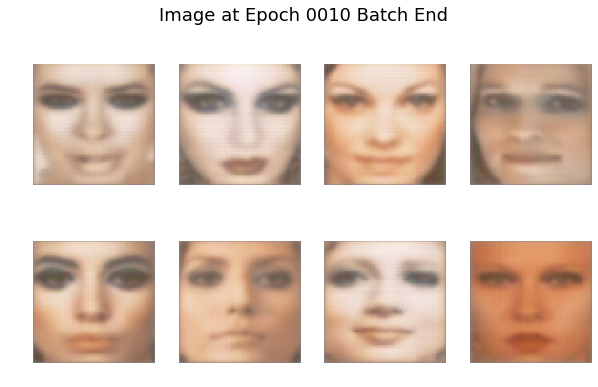

Epoch 11 starts!
Time for epoch 11 is 9.529233 sec, Total time is 338.845908 sec
Train SSIM: 0.382, Test SSIM 0.215, Train MAE: 0.239, Test MAE: 0.363
Epoch 12 starts!
Time for epoch 12 is 9.443650 sec, Total time is 348.290116 sec
Train SSIM: 0.385, Test SSIM 0.217, Train MAE: 0.241, Test MAE: 0.369
Epoch 13 starts!
Time for epoch 13 is 9.439170 sec, Total time is 357.729887 sec
Train SSIM: 0.388, Test SSIM 0.219, Train MAE: 0.243, Test MAE: 0.372
Epoch 14 starts!
Time for epoch 14 is 9.438596 sec, Total time is 367.168973 sec
Train SSIM: 0.390, Test SSIM 0.220, Train MAE: 0.243, Test MAE: 0.374
Epoch 15 starts!
Time for epoch 15 is 9.444798 sec, Total time is 376.614154 sec
Train SSIM: 0.392, Test SSIM 0.221, Train MAE: 0.243, Test MAE: 0.375


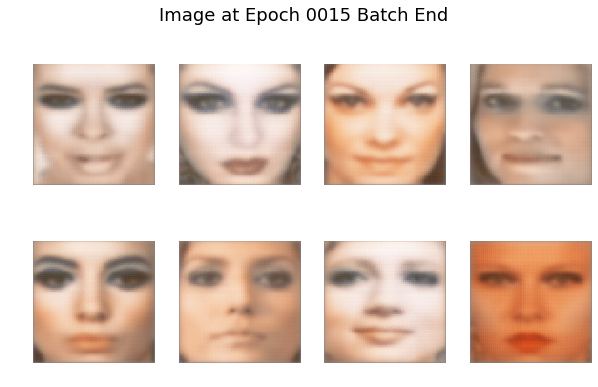

Epoch 16 starts!
Time for epoch 16 is 9.647037 sec, Total time is 388.022818 sec
Train SSIM: 0.395, Test SSIM 0.222, Train MAE: 0.242, Test MAE: 0.376
Epoch 17 starts!
Time for epoch 17 is 9.367404 sec, Total time is 397.390780 sec
Train SSIM: 0.397, Test SSIM 0.223, Train MAE: 0.242, Test MAE: 0.376
Epoch 18 starts!
Time for epoch 18 is 9.379535 sec, Total time is 406.770520 sec
Train SSIM: 0.399, Test SSIM 0.225, Train MAE: 0.242, Test MAE: 0.376
Epoch 19 starts!
Time for epoch 19 is 9.368752 sec, Total time is 416.139727 sec
Train SSIM: 0.401, Test SSIM 0.225, Train MAE: 0.241, Test MAE: 0.376
Epoch 20 starts!
Time for epoch 20 is 9.375560 sec, Total time is 425.515821 sec
Train SSIM: 0.403, Test SSIM 0.227, Train MAE: 0.240, Test MAE: 0.375


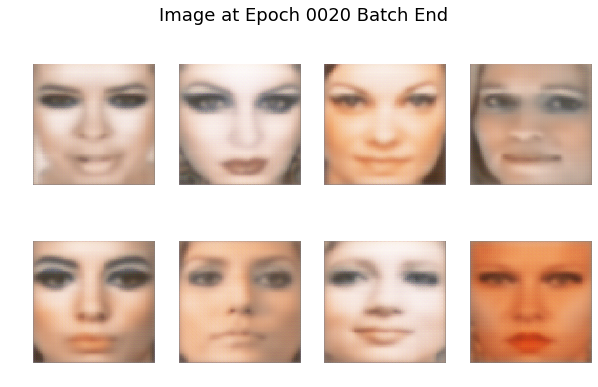

Epoch 21 starts!
Time for epoch 21 is 9.578375 sec, Total time is 436.874931 sec
Train SSIM: 0.404, Test SSIM 0.228, Train MAE: 0.240, Test MAE: 0.374
Epoch 22 starts!
Time for epoch 22 is 9.451529 sec, Total time is 446.327047 sec
Train SSIM: 0.406, Test SSIM 0.229, Train MAE: 0.239, Test MAE: 0.373
Epoch 23 starts!
Time for epoch 23 is 9.445237 sec, Total time is 455.772812 sec
Train SSIM: 0.407, Test SSIM 0.229, Train MAE: 0.239, Test MAE: 0.373
Epoch 24 starts!
Time for epoch 24 is 9.668792 sec, Total time is 465.442480 sec
Train SSIM: 0.408, Test SSIM 0.230, Train MAE: 0.238, Test MAE: 0.373
Epoch 25 starts!
Time for epoch 25 is 9.417573 sec, Total time is 474.860745 sec
Train SSIM: 0.409, Test SSIM 0.231, Train MAE: 0.238, Test MAE: 0.372


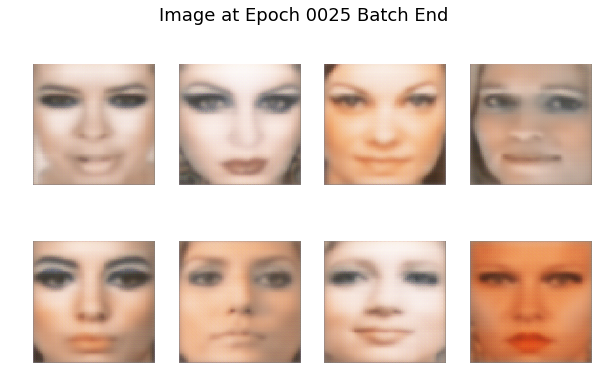

Epoch 26 starts!
Time for epoch 26 is 9.447063 sec, Total time is 486.035440 sec
Train SSIM: 0.410, Test SSIM 0.231, Train MAE: 0.237, Test MAE: 0.372
Epoch 27 starts!
Time for epoch 27 is 9.361724 sec, Total time is 495.397718 sec
Train SSIM: 0.411, Test SSIM 0.232, Train MAE: 0.237, Test MAE: 0.372
Epoch 28 starts!
Time for epoch 28 is 9.373776 sec, Total time is 504.772044 sec
Train SSIM: 0.412, Test SSIM 0.232, Train MAE: 0.237, Test MAE: 0.372
Epoch 29 starts!
Time for epoch 29 is 9.473066 sec, Total time is 514.245687 sec
Train SSIM: 0.413, Test SSIM 0.233, Train MAE: 0.237, Test MAE: 0.373
Epoch 30 starts!
Time for epoch 30 is 9.630037 sec, Total time is 523.875921 sec
Train SSIM: 0.413, Test SSIM 0.233, Train MAE: 0.237, Test MAE: 0.373


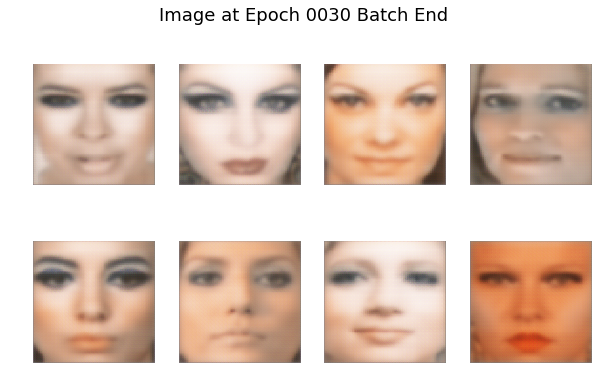

Epoch 31 starts!
Time for epoch 31 is 9.504086 sec, Total time is 535.129403 sec
Train SSIM: 0.415, Test SSIM 0.234, Train MAE: 0.236, Test MAE: 0.372
Epoch 32 starts!
Time for epoch 32 is 9.581455 sec, Total time is 544.711410 sec
Train SSIM: 0.415, Test SSIM 0.234, Train MAE: 0.237, Test MAE: 0.373
Epoch 33 starts!
Time for epoch 33 is 9.511681 sec, Total time is 554.223729 sec
Train SSIM: 0.416, Test SSIM 0.234, Train MAE: 0.236, Test MAE: 0.373
Epoch 34 starts!
Time for epoch 34 is 9.406518 sec, Total time is 563.630752 sec
Train SSIM: 0.416, Test SSIM 0.234, Train MAE: 0.236, Test MAE: 0.372
Epoch 35 starts!
Time for epoch 35 is 9.405111 sec, Total time is 573.036436 sec
Train SSIM: 0.417, Test SSIM 0.235, Train MAE: 0.237, Test MAE: 0.374


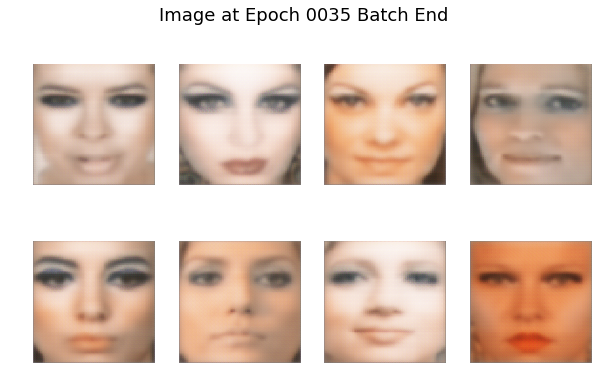

Epoch 36 starts!
Time for epoch 36 is 9.483621 sec, Total time is 584.259282 sec
Train SSIM: 0.418, Test SSIM 0.235, Train MAE: 0.236, Test MAE: 0.372
Epoch 37 starts!
Time for epoch 37 is 9.418756 sec, Total time is 593.678472 sec
Train SSIM: 0.418, Test SSIM 0.235, Train MAE: 0.236, Test MAE: 0.374
Epoch 38 starts!
Time for epoch 38 is 9.416250 sec, Total time is 603.095309 sec
Train SSIM: 0.419, Test SSIM 0.236, Train MAE: 0.235, Test MAE: 0.372
Epoch 39 starts!
Time for epoch 39 is 9.429333 sec, Total time is 612.524824 sec
Train SSIM: 0.418, Test SSIM 0.235, Train MAE: 0.238, Test MAE: 0.376
Epoch 40 starts!
Time for epoch 40 is 9.512177 sec, Total time is 622.037614 sec
Train SSIM: 0.419, Test SSIM 0.236, Train MAE: 0.236, Test MAE: 0.374


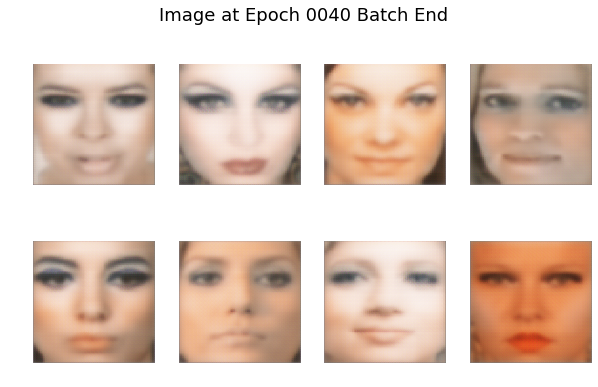

Epoch 41 starts!
Time for epoch 41 is 9.642667 sec, Total time is 633.588048 sec
Train SSIM: 0.420, Test SSIM 0.236, Train MAE: 0.236, Test MAE: 0.374
Epoch 42 starts!
Time for epoch 42 is 9.414982 sec, Total time is 643.003222 sec
Train SSIM: 0.420, Test SSIM 0.236, Train MAE: 0.236, Test MAE: 0.374
Epoch 43 starts!
Time for epoch 43 is 9.424284 sec, Total time is 652.428098 sec
Train SSIM: 0.420, Test SSIM 0.237, Train MAE: 0.236, Test MAE: 0.375
Epoch 44 starts!
Time for epoch 44 is 9.413013 sec, Total time is 661.841707 sec
Train SSIM: 0.421, Test SSIM 0.237, Train MAE: 0.236, Test MAE: 0.375
Epoch 45 starts!
Time for epoch 45 is 9.436286 sec, Total time is 671.278610 sec
Train SSIM: 0.420, Test SSIM 0.237, Train MAE: 0.238, Test MAE: 0.377


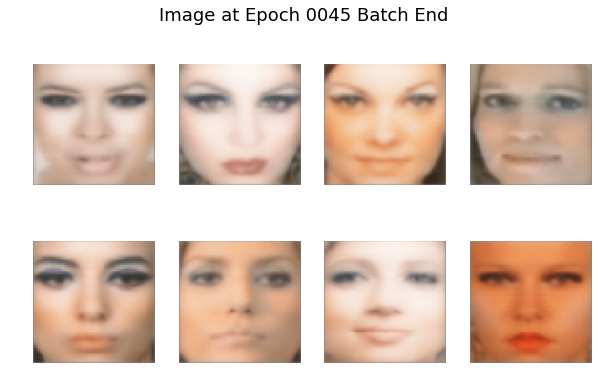

Epoch 46 starts!
Time for epoch 46 is 9.417960 sec, Total time is 682.473481 sec
Train SSIM: 0.421, Test SSIM 0.237, Train MAE: 0.237, Test MAE: 0.376
Epoch 47 starts!
Time for epoch 47 is 9.404237 sec, Total time is 691.878226 sec
Train SSIM: 0.421, Test SSIM 0.238, Train MAE: 0.237, Test MAE: 0.376
Epoch 48 starts!
Time for epoch 48 is 9.453465 sec, Total time is 701.332186 sec
Train SSIM: 0.421, Test SSIM 0.238, Train MAE: 0.237, Test MAE: 0.377
Epoch 49 starts!
Time for epoch 49 is 9.608904 sec, Total time is 710.941723 sec
Train SSIM: 0.421, Test SSIM 0.237, Train MAE: 0.239, Test MAE: 0.380
Epoch 50 starts!
Time for epoch 50 is 9.461696 sec, Total time is 720.403935 sec
Train SSIM: 0.421, Test SSIM 0.238, Train MAE: 0.237, Test MAE: 0.376


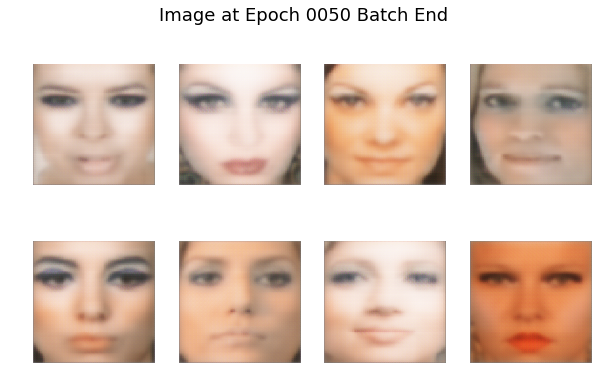

In [0]:
generator = make_generator_model()
discriminator = make_discriminator_model()
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0., beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0., beta_2=0.9)
result_tuples_1 = train(EPOCHS, 'wasserstein', 'L1')

Epoch 51 starts!
Time for epoch 51 is 9.612883 sec, Total time is 9.612886 sec
Train SSIM: 0.421, Test SSIM 0.237, Train MAE: 0.239, Test MAE: 0.379
Epoch 52 starts!
Time for epoch 52 is 9.490544 sec, Total time is 19.103959 sec
Train SSIM: 0.422, Test SSIM 0.238, Train MAE: 0.235, Test MAE: 0.373
Epoch 53 starts!
Time for epoch 53 is 9.543133 sec, Total time is 28.647731 sec
Train SSIM: 0.422, Test SSIM 0.239, Train MAE: 0.236, Test MAE: 0.374
Epoch 54 starts!
Time for epoch 54 is 9.636570 sec, Total time is 38.284858 sec
Train SSIM: 0.421, Test SSIM 0.237, Train MAE: 0.240, Test MAE: 0.381
Epoch 55 starts!
Time for epoch 55 is 9.793611 sec, Total time is 48.079090 sec
Train SSIM: 0.421, Test SSIM 0.238, Train MAE: 0.240, Test MAE: 0.381


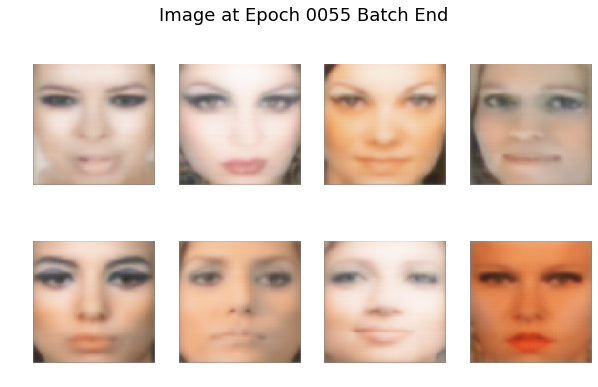

Epoch 56 starts!
Time for epoch 56 is 9.606236 sec, Total time is 59.464350 sec
Train SSIM: 0.419, Test SSIM 0.237, Train MAE: 0.244, Test MAE: 0.386
Epoch 57 starts!
Time for epoch 57 is 9.410197 sec, Total time is 68.875134 sec
Train SSIM: 0.421, Test SSIM 0.239, Train MAE: 0.241, Test MAE: 0.381
Epoch 58 starts!
Time for epoch 58 is 9.417981 sec, Total time is 78.293688 sec
Train SSIM: 0.420, Test SSIM 0.239, Train MAE: 0.242, Test MAE: 0.383
Epoch 59 starts!
Time for epoch 59 is 9.532737 sec, Total time is 87.827025 sec
Train SSIM: 0.421, Test SSIM 0.239, Train MAE: 0.241, Test MAE: 0.381
Epoch 60 starts!
Time for epoch 60 is 9.363467 sec, Total time is 97.191070 sec
Train SSIM: 0.421, Test SSIM 0.239, Train MAE: 0.239, Test MAE: 0.378


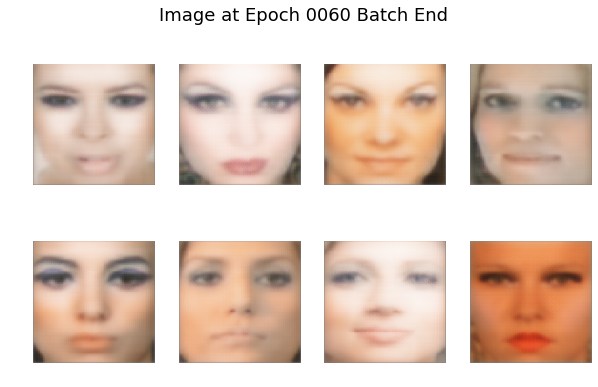

Epoch 61 starts!
Time for epoch 61 is 9.483497 sec, Total time is 108.391466 sec
Train SSIM: 0.418, Test SSIM 0.236, Train MAE: 0.246, Test MAE: 0.390
Epoch 62 starts!
Time for epoch 62 is 9.426531 sec, Total time is 117.818581 sec
Train SSIM: 0.419, Test SSIM 0.238, Train MAE: 0.246, Test MAE: 0.389
Epoch 63 starts!
Time for epoch 63 is 9.458227 sec, Total time is 127.277002 sec
Train SSIM: 0.420, Test SSIM 0.239, Train MAE: 0.243, Test MAE: 0.384
Epoch 64 starts!
Time for epoch 64 is 9.473063 sec, Total time is 136.750544 sec
Train SSIM: 0.419, Test SSIM 0.239, Train MAE: 0.244, Test MAE: 0.386
Epoch 65 starts!
Time for epoch 65 is 9.417686 sec, Total time is 146.168757 sec
Train SSIM: 0.418, Test SSIM 0.240, Train MAE: 0.245, Test MAE: 0.386


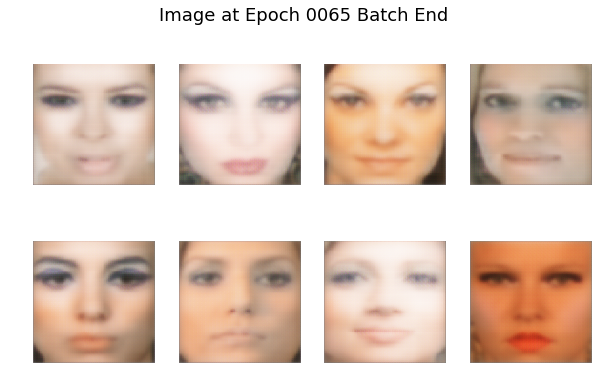

Epoch 66 starts!
Time for epoch 66 is 9.552480 sec, Total time is 157.439446 sec
Train SSIM: 0.418, Test SSIM 0.241, Train MAE: 0.244, Test MAE: 0.384
Epoch 67 starts!
Time for epoch 67 is 9.561426 sec, Total time is 167.001341 sec
Train SSIM: 0.416, Test SSIM 0.239, Train MAE: 0.251, Test MAE: 0.394
Epoch 68 starts!
Time for epoch 68 is 9.379748 sec, Total time is 176.381270 sec
Train SSIM: 0.417, Test SSIM 0.238, Train MAE: 0.248, Test MAE: 0.390
Epoch 69 starts!
Time for epoch 69 is 9.367124 sec, Total time is 185.748952 sec
Train SSIM: 0.419, Test SSIM 0.241, Train MAE: 0.242, Test MAE: 0.381
Epoch 70 starts!
Time for epoch 70 is 9.385228 sec, Total time is 195.134690 sec
Train SSIM: 0.418, Test SSIM 0.240, Train MAE: 0.248, Test MAE: 0.390


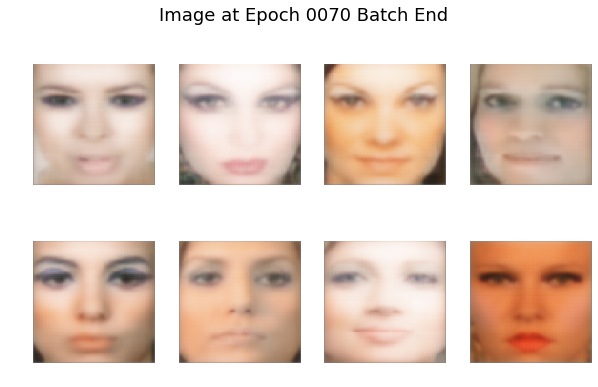

Epoch 71 starts!
Time for epoch 71 is 9.641937 sec, Total time is 206.396871 sec
Train SSIM: 0.417, Test SSIM 0.239, Train MAE: 0.247, Test MAE: 0.390
Epoch 72 starts!
Time for epoch 72 is 9.550373 sec, Total time is 215.947417 sec
Train SSIM: 0.418, Test SSIM 0.242, Train MAE: 0.247, Test MAE: 0.386
Epoch 73 starts!
Time for epoch 73 is 9.491124 sec, Total time is 225.439126 sec
Train SSIM: 0.415, Test SSIM 0.240, Train MAE: 0.252, Test MAE: 0.393
Epoch 74 starts!
Time for epoch 74 is 9.487279 sec, Total time is 234.926964 sec
Train SSIM: 0.416, Test SSIM 0.241, Train MAE: 0.249, Test MAE: 0.389
Epoch 75 starts!
Time for epoch 75 is 9.700401 sec, Total time is 244.628015 sec
Train SSIM: 0.417, Test SSIM 0.242, Train MAE: 0.249, Test MAE: 0.388


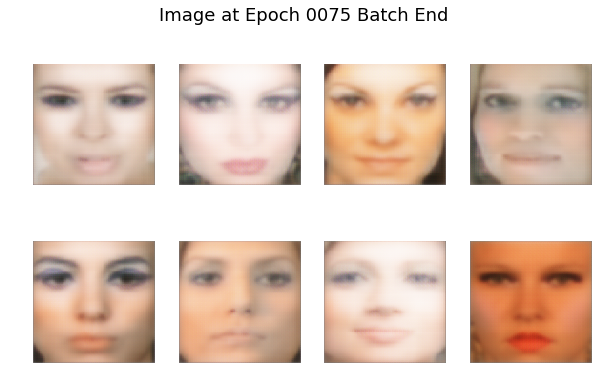

Epoch 76 starts!
Time for epoch 76 is 9.557452 sec, Total time is 255.855343 sec
Train SSIM: 0.416, Test SSIM 0.243, Train MAE: 0.251, Test MAE: 0.391
Epoch 77 starts!
Time for epoch 77 is 9.626939 sec, Total time is 265.482942 sec
Train SSIM: 0.419, Test SSIM 0.243, Train MAE: 0.244, Test MAE: 0.383
Epoch 78 starts!
Time for epoch 78 is 9.444765 sec, Total time is 274.928313 sec
Train SSIM: 0.418, Test SSIM 0.243, Train MAE: 0.244, Test MAE: 0.381
Epoch 79 starts!
Time for epoch 79 is 9.455821 sec, Total time is 284.384696 sec
Train SSIM: 0.418, Test SSIM 0.244, Train MAE: 0.242, Test MAE: 0.380
Epoch 80 starts!
Time for epoch 80 is 9.422367 sec, Total time is 293.807602 sec
Train SSIM: 0.416, Test SSIM 0.240, Train MAE: 0.252, Test MAE: 0.393


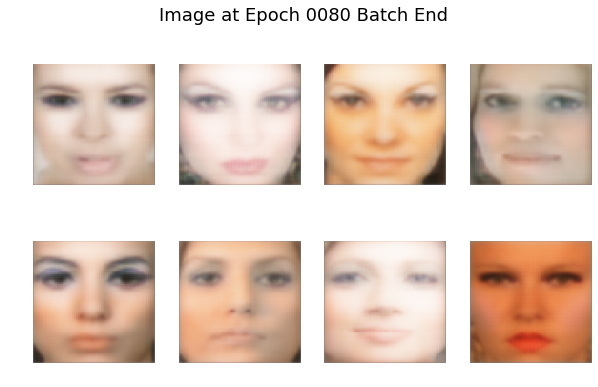

Epoch 81 starts!
Time for epoch 81 is 9.511161 sec, Total time is 305.095774 sec
Train SSIM: 0.418, Test SSIM 0.243, Train MAE: 0.249, Test MAE: 0.387
Epoch 82 starts!
Time for epoch 82 is 9.391180 sec, Total time is 314.487803 sec
Train SSIM: 0.417, Test SSIM 0.241, Train MAE: 0.247, Test MAE: 0.388
Epoch 83 starts!
Time for epoch 83 is 9.676857 sec, Total time is 324.165318 sec
Train SSIM: 0.417, Test SSIM 0.241, Train MAE: 0.250, Test MAE: 0.392
Epoch 84 starts!
Time for epoch 84 is 9.522425 sec, Total time is 333.688368 sec
Train SSIM: 0.416, Test SSIM 0.244, Train MAE: 0.254, Test MAE: 0.393
Epoch 85 starts!
Time for epoch 85 is 9.491845 sec, Total time is 343.180769 sec
Train SSIM: 0.415, Test SSIM 0.240, Train MAE: 0.257, Test MAE: 0.400


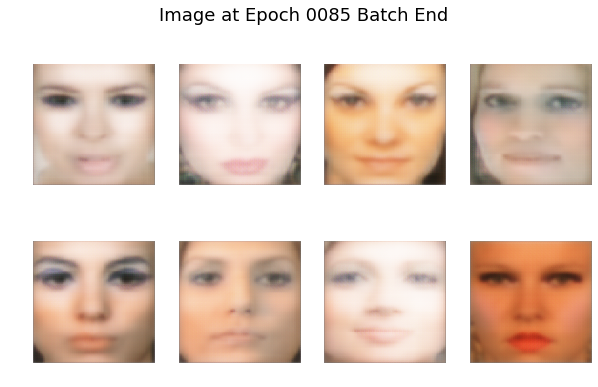

Epoch 86 starts!
Time for epoch 86 is 9.668927 sec, Total time is 354.469341 sec
Train SSIM: 0.415, Test SSIM 0.241, Train MAE: 0.255, Test MAE: 0.397
Epoch 87 starts!
Time for epoch 87 is 9.575289 sec, Total time is 364.044833 sec
Train SSIM: 0.416, Test SSIM 0.240, Train MAE: 0.251, Test MAE: 0.394
Epoch 88 starts!
Time for epoch 88 is 9.433655 sec, Total time is 373.479027 sec
Train SSIM: 0.416, Test SSIM 0.241, Train MAE: 0.251, Test MAE: 0.393
Epoch 89 starts!
Time for epoch 89 is 9.465207 sec, Total time is 382.944593 sec
Train SSIM: 0.415, Test SSIM 0.240, Train MAE: 0.256, Test MAE: 0.400
Epoch 90 starts!
Time for epoch 90 is 9.525049 sec, Total time is 392.470219 sec
Train SSIM: 0.417, Test SSIM 0.242, Train MAE: 0.248, Test MAE: 0.388


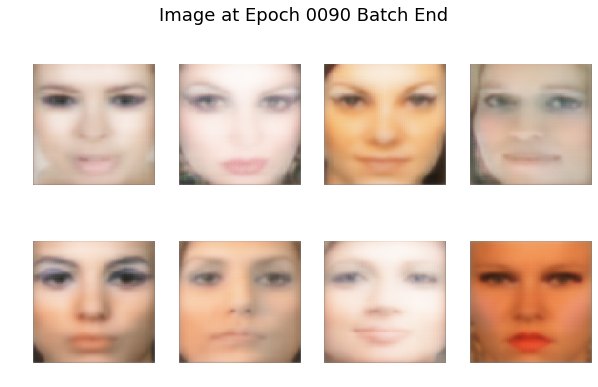

Epoch 91 starts!
Time for epoch 91 is 9.705032 sec, Total time is 403.949271 sec
Train SSIM: 0.420, Test SSIM 0.242, Train MAE: 0.247, Test MAE: 0.389
Epoch 92 starts!
Time for epoch 92 is 9.545686 sec, Total time is 413.495589 sec
Train SSIM: 0.419, Test SSIM 0.243, Train MAE: 0.249, Test MAE: 0.391
Epoch 93 starts!
Time for epoch 93 is 9.451658 sec, Total time is 422.947816 sec
Train SSIM: 0.417, Test SSIM 0.243, Train MAE: 0.252, Test MAE: 0.394
Epoch 94 starts!
Time for epoch 94 is 9.422854 sec, Total time is 432.371198 sec
Train SSIM: 0.418, Test SSIM 0.244, Train MAE: 0.247, Test MAE: 0.386
Epoch 95 starts!
Time for epoch 95 is 9.395112 sec, Total time is 441.766671 sec
Train SSIM: 0.417, Test SSIM 0.242, Train MAE: 0.252, Test MAE: 0.395


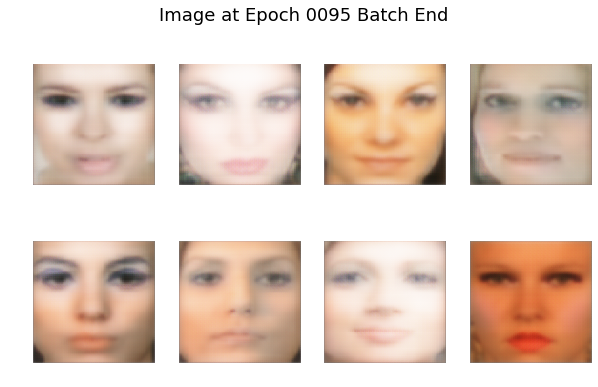

Epoch 96 starts!
Time for epoch 96 is 9.528362 sec, Total time is 452.864574 sec
Train SSIM: 0.421, Test SSIM 0.245, Train MAE: 0.241, Test MAE: 0.380
Epoch 97 starts!
Time for epoch 97 is 9.395641 sec, Total time is 462.260706 sec
Train SSIM: 0.420, Test SSIM 0.244, Train MAE: 0.244, Test MAE: 0.384
Epoch 98 starts!
Time for epoch 98 is 9.364243 sec, Total time is 471.625501 sec
Train SSIM: 0.420, Test SSIM 0.243, Train MAE: 0.248, Test MAE: 0.392
Epoch 99 starts!
Time for epoch 99 is 9.465357 sec, Total time is 481.091397 sec
Train SSIM: 0.424, Test SSIM 0.243, Train MAE: 0.242, Test MAE: 0.384
Epoch 100 starts!
Time for epoch 100 is 9.599815 sec, Total time is 490.691792 sec
Train SSIM: 0.423, Test SSIM 0.245, Train MAE: 0.240, Test MAE: 0.380


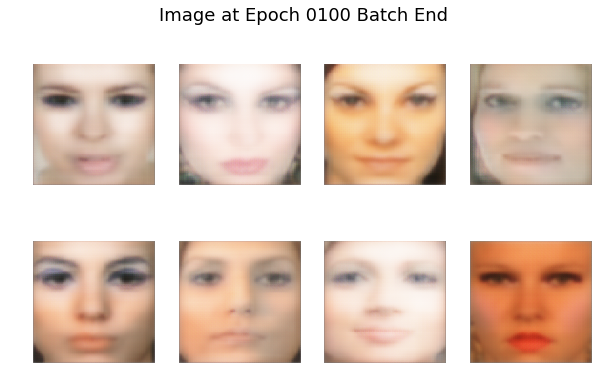

In [0]:
result_tuples_1_1 = re_train(50, 50, 'wasserstein', 'L1')

In [0]:
save_hist(result_tuples_1, 0, 'wasserstein', 'L1')
save_hist(result_tuples_1_1, 1, 'wasserstein', 'L1')
zip_image('wasserstein', 'L1')
create_gif('wasserstein', 'L1')

##'cross_entropy', 'SSIM'

Epoch 1 starts!
Time for epoch 1 is 213.407319 sec, Total time is 213.407320 sec
Train SSIM: 0.150, Test SSIM 0.108, Train MAE: 0.387, Test MAE: 0.397
Epoch 2 starts!
Time for epoch 2 is 11.980304 sec, Total time is 225.388291 sec
Train SSIM: 0.301, Test SSIM 0.199, Train MAE: 0.319, Test MAE: 0.365
Epoch 3 starts!
Time for epoch 3 is 11.688400 sec, Total time is 237.077094 sec
Train SSIM: 0.365, Test SSIM 0.228, Train MAE: 0.292, Test MAE: 0.368
Epoch 4 starts!
Time for epoch 4 is 11.440693 sec, Total time is 248.518288 sec
Train SSIM: 0.392, Test SSIM 0.233, Train MAE: 0.266, Test MAE: 0.372
Epoch 5 starts!
Time for epoch 5 is 11.403802 sec, Total time is 259.922720 sec
Train SSIM: 0.398, Test SSIM 0.231, Train MAE: 0.275, Test MAE: 0.400


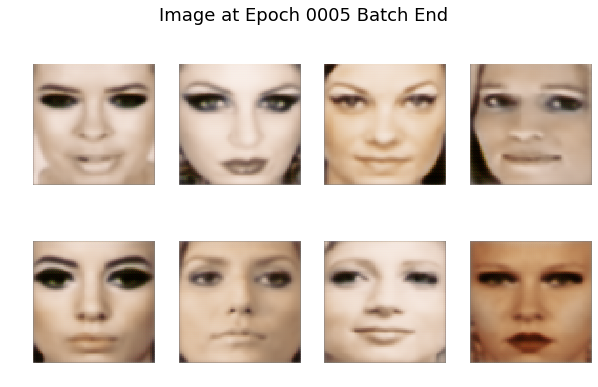

Epoch 6 starts!
Time for epoch 6 is 11.383772 sec, Total time is 273.046717 sec
Train SSIM: 0.409, Test SSIM 0.231, Train MAE: 0.271, Test MAE: 0.402
Epoch 7 starts!
Time for epoch 7 is 11.268554 sec, Total time is 284.315861 sec
Train SSIM: 0.421, Test SSIM 0.237, Train MAE: 0.247, Test MAE: 0.379
Epoch 8 starts!
Time for epoch 8 is 11.447672 sec, Total time is 295.763732 sec
Train SSIM: 0.423, Test SSIM 0.237, Train MAE: 0.242, Test MAE: 0.375
Epoch 9 starts!
Time for epoch 9 is 11.423493 sec, Total time is 307.187848 sec
Train SSIM: 0.420, Test SSIM 0.239, Train MAE: 0.243, Test MAE: 0.375
Epoch 10 starts!
Time for epoch 10 is 11.467098 sec, Total time is 318.655539 sec
Train SSIM: 0.415, Test SSIM 0.247, Train MAE: 0.258, Test MAE: 0.380


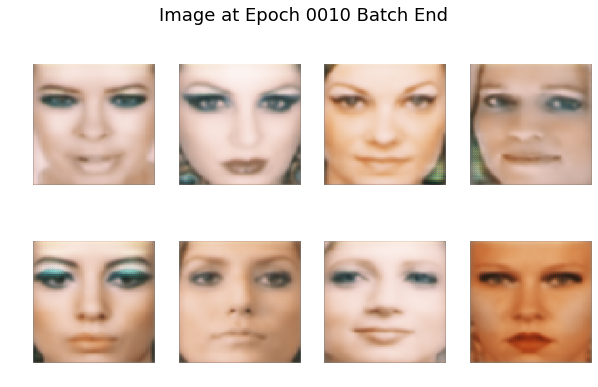

Epoch 11 starts!
Time for epoch 11 is 11.471560 sec, Total time is 331.924622 sec
Train SSIM: 0.417, Test SSIM 0.247, Train MAE: 0.255, Test MAE: 0.372
Epoch 12 starts!
Time for epoch 12 is 11.412283 sec, Total time is 343.337498 sec
Train SSIM: 0.421, Test SSIM 0.247, Train MAE: 0.249, Test MAE: 0.369
Epoch 13 starts!
Time for epoch 13 is 11.353283 sec, Total time is 354.691324 sec
Train SSIM: 0.425, Test SSIM 0.249, Train MAE: 0.246, Test MAE: 0.370
Epoch 14 starts!
Time for epoch 14 is 11.395143 sec, Total time is 366.086954 sec
Train SSIM: 0.427, Test SSIM 0.249, Train MAE: 0.243, Test MAE: 0.369
Epoch 15 starts!
Time for epoch 15 is 11.589869 sec, Total time is 377.677375 sec
Train SSIM: 0.428, Test SSIM 0.248, Train MAE: 0.242, Test MAE: 0.367


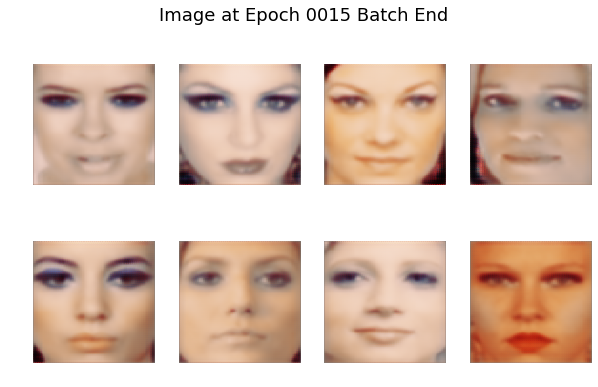

Epoch 16 starts!
Time for epoch 16 is 11.416066 sec, Total time is 390.770234 sec
Train SSIM: 0.429, Test SSIM 0.245, Train MAE: 0.239, Test MAE: 0.370
Epoch 17 starts!
Time for epoch 17 is 11.378342 sec, Total time is 402.149197 sec
Train SSIM: 0.427, Test SSIM 0.241, Train MAE: 0.242, Test MAE: 0.373
Epoch 18 starts!
Time for epoch 18 is 11.340240 sec, Total time is 413.490075 sec
Train SSIM: 0.428, Test SSIM 0.238, Train MAE: 0.243, Test MAE: 0.380
Epoch 19 starts!
Time for epoch 19 is 11.464095 sec, Total time is 424.954731 sec
Train SSIM: 0.430, Test SSIM 0.241, Train MAE: 0.242, Test MAE: 0.376
Epoch 20 starts!
Time for epoch 20 is 11.337825 sec, Total time is 436.293267 sec
Train SSIM: 0.429, Test SSIM 0.239, Train MAE: 0.241, Test MAE: 0.371


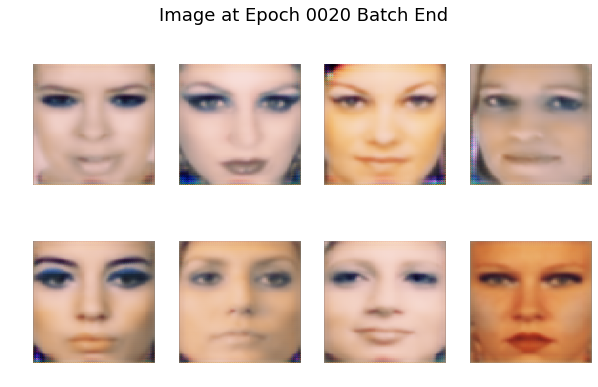

Epoch 21 starts!
Time for epoch 21 is 11.397947 sec, Total time is 449.398374 sec
Train SSIM: 0.427, Test SSIM 0.235, Train MAE: 0.245, Test MAE: 0.373
Epoch 22 starts!
Time for epoch 22 is 11.635651 sec, Total time is 461.034679 sec
Train SSIM: 0.430, Test SSIM 0.240, Train MAE: 0.242, Test MAE: 0.369
Epoch 23 starts!
Time for epoch 23 is 11.328788 sec, Total time is 472.364030 sec
Train SSIM: 0.430, Test SSIM 0.238, Train MAE: 0.243, Test MAE: 0.371
Epoch 24 starts!
Time for epoch 24 is 11.317589 sec, Total time is 483.682198 sec
Train SSIM: 0.434, Test SSIM 0.239, Train MAE: 0.242, Test MAE: 0.371
Epoch 25 starts!
Time for epoch 25 is 11.337916 sec, Total time is 495.020475 sec
Train SSIM: 0.435, Test SSIM 0.240, Train MAE: 0.239, Test MAE: 0.365


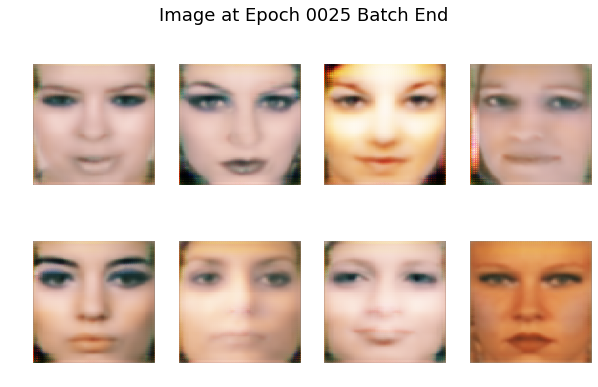

Epoch 26 starts!
Time for epoch 26 is 11.333931 sec, Total time is 507.982979 sec
Train SSIM: 0.429, Test SSIM 0.241, Train MAE: 0.248, Test MAE: 0.376
Epoch 27 starts!
Time for epoch 27 is 11.390491 sec, Total time is 519.373994 sec
Train SSIM: 0.431, Test SSIM 0.231, Train MAE: 0.248, Test MAE: 0.382
Epoch 28 starts!
Time for epoch 28 is 11.491789 sec, Total time is 530.866328 sec
Train SSIM: 0.438, Test SSIM 0.234, Train MAE: 0.239, Test MAE: 0.368
Epoch 29 starts!
Time for epoch 29 is 11.708416 sec, Total time is 542.575415 sec
Train SSIM: 0.434, Test SSIM 0.235, Train MAE: 0.242, Test MAE: 0.375
Epoch 30 starts!
Time for epoch 30 is 11.387527 sec, Total time is 553.963499 sec
Train SSIM: 0.432, Test SSIM 0.233, Train MAE: 0.247, Test MAE: 0.378


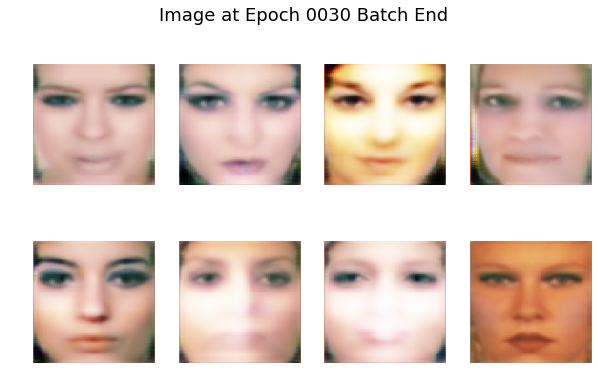

Epoch 31 starts!
Time for epoch 31 is 11.563463 sec, Total time is 567.258255 sec
Train SSIM: 0.437, Test SSIM 0.234, Train MAE: 0.240, Test MAE: 0.370
Epoch 32 starts!
Time for epoch 32 is 11.334099 sec, Total time is 578.593014 sec
Train SSIM: 0.432, Test SSIM 0.228, Train MAE: 0.244, Test MAE: 0.373
Epoch 33 starts!
Time for epoch 33 is 11.291670 sec, Total time is 589.885242 sec
Train SSIM: 0.438, Test SSIM 0.229, Train MAE: 0.238, Test MAE: 0.370
Epoch 34 starts!
Time for epoch 34 is 11.368861 sec, Total time is 601.254696 sec
Train SSIM: 0.440, Test SSIM 0.229, Train MAE: 0.234, Test MAE: 0.366
Epoch 35 starts!
Time for epoch 35 is 11.428064 sec, Total time is 612.683260 sec
Train SSIM: 0.439, Test SSIM 0.229, Train MAE: 0.234, Test MAE: 0.364


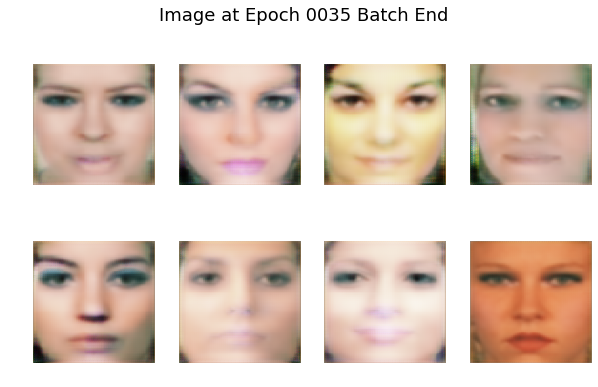

Epoch 36 starts!
Time for epoch 36 is 11.693685 sec, Total time is 626.177076 sec
Train SSIM: 0.443, Test SSIM 0.231, Train MAE: 0.231, Test MAE: 0.361
Epoch 37 starts!
Time for epoch 37 is 11.366547 sec, Total time is 637.544201 sec
Train SSIM: 0.445, Test SSIM 0.231, Train MAE: 0.230, Test MAE: 0.360
Epoch 38 starts!
Time for epoch 38 is 11.386179 sec, Total time is 648.930948 sec
Train SSIM: 0.445, Test SSIM 0.228, Train MAE: 0.232, Test MAE: 0.365
Epoch 39 starts!
Time for epoch 39 is 11.340924 sec, Total time is 660.272470 sec
Train SSIM: 0.440, Test SSIM 0.220, Train MAE: 0.236, Test MAE: 0.368
Epoch 40 starts!
Time for epoch 40 is 11.402160 sec, Total time is 671.675226 sec
Train SSIM: 0.442, Test SSIM 0.226, Train MAE: 0.234, Test MAE: 0.365


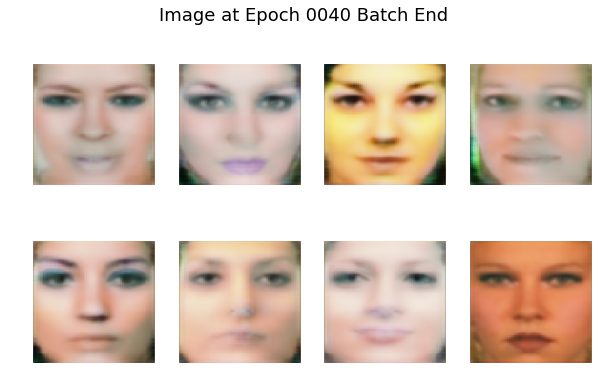

Epoch 41 starts!
Time for epoch 41 is 11.443476 sec, Total time is 685.278095 sec
Train SSIM: 0.422, Test SSIM 0.215, Train MAE: 0.249, Test MAE: 0.369
Epoch 42 starts!
Time for epoch 42 is 11.477831 sec, Total time is 696.756403 sec
Train SSIM: 0.431, Test SSIM 0.218, Train MAE: 0.243, Test MAE: 0.370
Epoch 43 starts!
Time for epoch 43 is 11.569137 sec, Total time is 708.326228 sec
Train SSIM: 0.435, Test SSIM 0.222, Train MAE: 0.242, Test MAE: 0.362
Epoch 44 starts!
Time for epoch 44 is 11.394449 sec, Total time is 719.721247 sec
Train SSIM: 0.438, Test SSIM 0.223, Train MAE: 0.236, Test MAE: 0.365
Epoch 45 starts!
Time for epoch 45 is 11.522517 sec, Total time is 731.244364 sec
Train SSIM: 0.450, Test SSIM 0.234, Train MAE: 0.232, Test MAE: 0.363


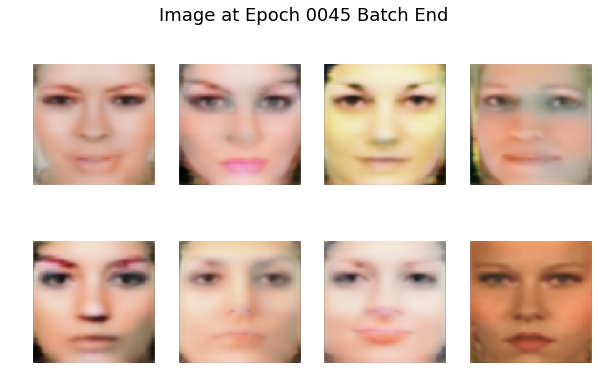

Epoch 46 starts!
Time for epoch 46 is 11.407667 sec, Total time is 744.395229 sec
Train SSIM: 0.445, Test SSIM 0.227, Train MAE: 0.231, Test MAE: 0.363
Epoch 47 starts!
Time for epoch 47 is 11.429082 sec, Total time is 755.824932 sec
Train SSIM: 0.446, Test SSIM 0.231, Train MAE: 0.232, Test MAE: 0.367
Epoch 48 starts!
Time for epoch 48 is 11.437351 sec, Total time is 767.262816 sec
Train SSIM: 0.444, Test SSIM 0.225, Train MAE: 0.233, Test MAE: 0.363
Epoch 49 starts!
Time for epoch 49 is 11.557764 sec, Total time is 778.821175 sec
Train SSIM: 0.437, Test SSIM 0.218, Train MAE: 0.237, Test MAE: 0.368
Epoch 50 starts!
Time for epoch 50 is 11.502815 sec, Total time is 790.324548 sec
Train SSIM: 0.462, Test SSIM 0.231, Train MAE: 0.224, Test MAE: 0.363


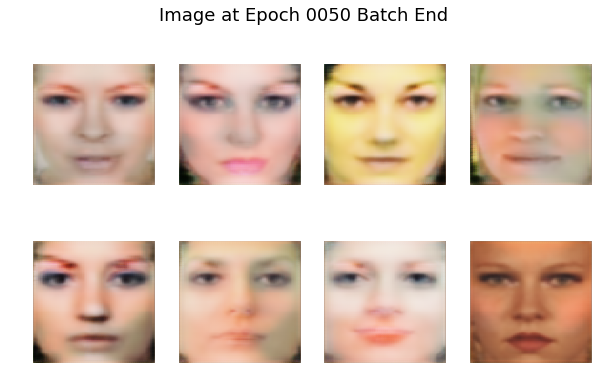

In [0]:
generator = make_generator_model()
discriminator = make_discriminator_model()
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0., beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0., beta_2=0.9)
result_tuples_2 = train(EPOCHS, 'cross_entropy', 'SSIM')

Epoch 51 starts!
Time for epoch 51 is 11.480884 sec, Total time is 11.480887 sec
Train SSIM: 0.457, Test SSIM 0.228, Train MAE: 0.228, Test MAE: 0.365
Epoch 52 starts!
Time for epoch 52 is 11.585127 sec, Total time is 23.066663 sec
Train SSIM: 0.467, Test SSIM 0.233, Train MAE: 0.220, Test MAE: 0.364
Epoch 53 starts!
Time for epoch 53 is 11.458889 sec, Total time is 34.525740 sec
Train SSIM: 0.460, Test SSIM 0.229, Train MAE: 0.225, Test MAE: 0.366
Epoch 54 starts!
Time for epoch 54 is 11.424505 sec, Total time is 45.950798 sec
Train SSIM: 0.458, Test SSIM 0.229, Train MAE: 0.223, Test MAE: 0.366
Epoch 55 starts!
Time for epoch 55 is 11.340172 sec, Total time is 57.291440 sec
Train SSIM: 0.472, Test SSIM 0.232, Train MAE: 0.218, Test MAE: 0.367


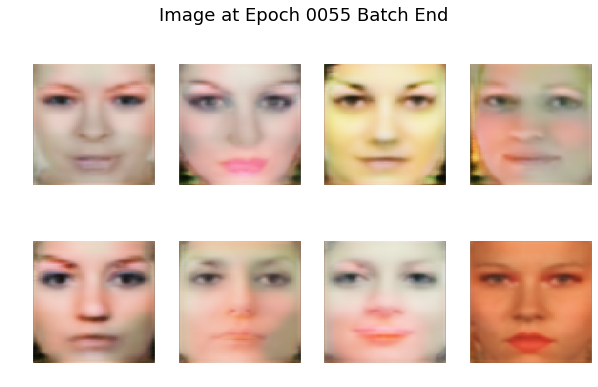

Epoch 56 starts!
Time for epoch 56 is 11.295222 sec, Total time is 70.468775 sec
Train SSIM: 0.470, Test SSIM 0.235, Train MAE: 0.218, Test MAE: 0.361
Epoch 57 starts!
Time for epoch 57 is 11.315579 sec, Total time is 81.784879 sec
Train SSIM: 0.478, Test SSIM 0.237, Train MAE: 0.215, Test MAE: 0.366
Epoch 58 starts!
Time for epoch 58 is 11.543009 sec, Total time is 93.328415 sec
Train SSIM: 0.468, Test SSIM 0.229, Train MAE: 0.221, Test MAE: 0.366
Epoch 59 starts!
Time for epoch 59 is 11.593791 sec, Total time is 104.922856 sec
Train SSIM: 0.469, Test SSIM 0.232, Train MAE: 0.221, Test MAE: 0.364
Epoch 60 starts!
Time for epoch 60 is 11.613414 sec, Total time is 116.536458 sec
Train SSIM: 0.465, Test SSIM 0.228, Train MAE: 0.221, Test MAE: 0.364


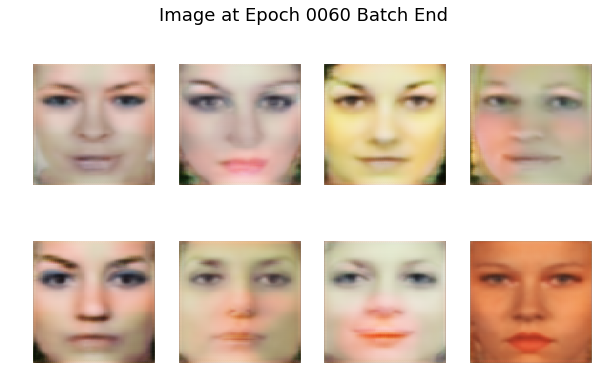

Epoch 61 starts!
Time for epoch 61 is 11.528821 sec, Total time is 129.877766 sec
Train SSIM: 0.477, Test SSIM 0.239, Train MAE: 0.216, Test MAE: 0.362
Epoch 62 starts!
Time for epoch 62 is 11.495061 sec, Total time is 141.373390 sec
Train SSIM: 0.476, Test SSIM 0.232, Train MAE: 0.216, Test MAE: 0.364
Epoch 63 starts!
Time for epoch 63 is 11.443744 sec, Total time is 152.817659 sec
Train SSIM: 0.472, Test SSIM 0.233, Train MAE: 0.218, Test MAE: 0.364
Epoch 64 starts!
Time for epoch 64 is 11.477488 sec, Total time is 164.295700 sec
Train SSIM: 0.464, Test SSIM 0.225, Train MAE: 0.223, Test MAE: 0.370
Epoch 65 starts!
Time for epoch 65 is 11.684093 sec, Total time is 175.980351 sec
Train SSIM: 0.487, Test SSIM 0.241, Train MAE: 0.210, Test MAE: 0.361


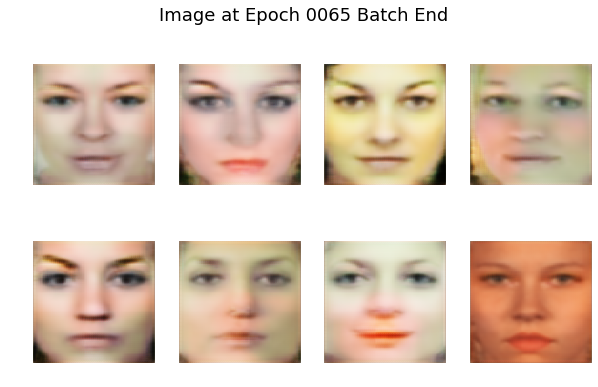

Epoch 66 starts!
Time for epoch 66 is 11.581522 sec, Total time is 189.378744 sec
Train SSIM: 0.474, Test SSIM 0.230, Train MAE: 0.219, Test MAE: 0.366
Epoch 67 starts!
Time for epoch 67 is 11.429386 sec, Total time is 200.808666 sec
Train SSIM: 0.479, Test SSIM 0.231, Train MAE: 0.216, Test MAE: 0.368
Epoch 68 starts!
Time for epoch 68 is 11.406076 sec, Total time is 212.215237 sec
Train SSIM: 0.480, Test SSIM 0.232, Train MAE: 0.214, Test MAE: 0.364
Epoch 69 starts!
Time for epoch 69 is 11.492928 sec, Total time is 223.708968 sec
Train SSIM: 0.473, Test SSIM 0.226, Train MAE: 0.218, Test MAE: 0.363
Epoch 70 starts!
Time for epoch 70 is 11.688752 sec, Total time is 235.398350 sec
Train SSIM: 0.492, Test SSIM 0.241, Train MAE: 0.208, Test MAE: 0.360


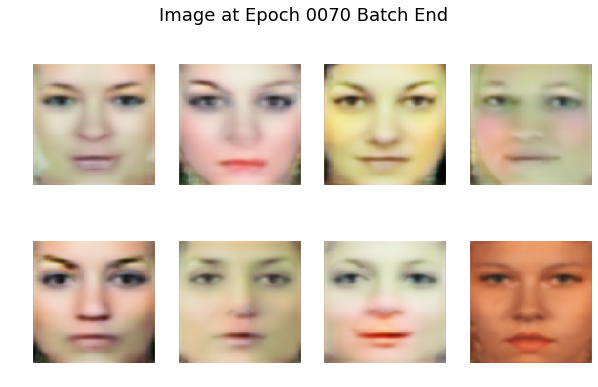

Epoch 71 starts!
Time for epoch 71 is 11.594917 sec, Total time is 248.819700 sec
Train SSIM: 0.493, Test SSIM 0.241, Train MAE: 0.208, Test MAE: 0.361
Epoch 72 starts!
Time for epoch 72 is 11.623240 sec, Total time is 260.443132 sec
Train SSIM: 0.479, Test SSIM 0.235, Train MAE: 0.216, Test MAE: 0.361
Epoch 73 starts!
Time for epoch 73 is 11.368893 sec, Total time is 271.812531 sec
Train SSIM: 0.485, Test SSIM 0.233, Train MAE: 0.212, Test MAE: 0.363
Epoch 74 starts!
Time for epoch 74 is 11.400801 sec, Total time is 283.213895 sec
Train SSIM: 0.489, Test SSIM 0.234, Train MAE: 0.209, Test MAE: 0.365
Epoch 75 starts!
Time for epoch 75 is 11.411705 sec, Total time is 294.626246 sec
Train SSIM: 0.484, Test SSIM 0.229, Train MAE: 0.213, Test MAE: 0.365


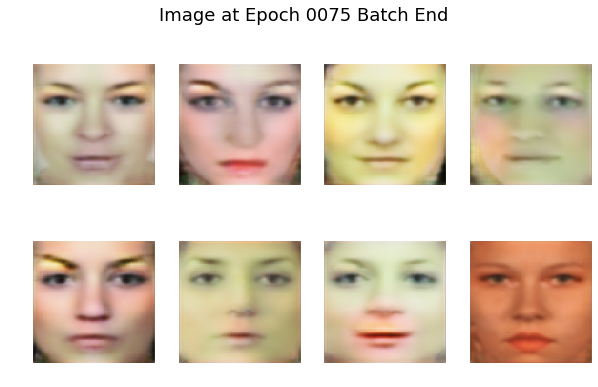

Epoch 76 starts!
Time for epoch 76 is 11.397966 sec, Total time is 307.844836 sec
Train SSIM: 0.486, Test SSIM 0.228, Train MAE: 0.211, Test MAE: 0.366
Epoch 77 starts!
Time for epoch 77 is 11.344040 sec, Total time is 319.189376 sec
Train SSIM: 0.489, Test SSIM 0.236, Train MAE: 0.209, Test MAE: 0.363
Epoch 78 starts!
Time for epoch 78 is 11.496556 sec, Total time is 330.686465 sec
Train SSIM: 0.493, Test SSIM 0.238, Train MAE: 0.207, Test MAE: 0.365
Epoch 79 starts!
Time for epoch 79 is 11.590315 sec, Total time is 342.277407 sec
Train SSIM: 0.492, Test SSIM 0.235, Train MAE: 0.208, Test MAE: 0.370
Epoch 80 starts!
Time for epoch 80 is 11.375755 sec, Total time is 353.653742 sec
Train SSIM: 0.503, Test SSIM 0.241, Train MAE: 0.204, Test MAE: 0.365


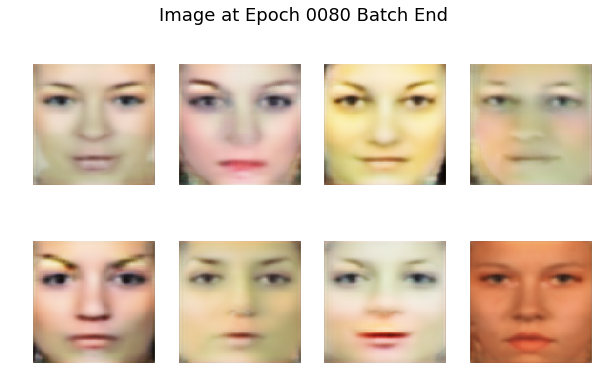

Epoch 81 starts!
Time for epoch 81 is 11.403439 sec, Total time is 366.921676 sec
Train SSIM: 0.494, Test SSIM 0.236, Train MAE: 0.207, Test MAE: 0.365
Epoch 82 starts!
Time for epoch 82 is 11.428894 sec, Total time is 378.351102 sec
Train SSIM: 0.472, Test SSIM 0.225, Train MAE: 0.214, Test MAE: 0.369
Epoch 83 starts!
Time for epoch 83 is 11.441935 sec, Total time is 389.793411 sec
Train SSIM: 0.495, Test SSIM 0.231, Train MAE: 0.206, Test MAE: 0.367
Epoch 84 starts!
Time for epoch 84 is 11.400361 sec, Total time is 401.194315 sec
Train SSIM: 0.491, Test SSIM 0.229, Train MAE: 0.207, Test MAE: 0.369
Epoch 85 starts!
Time for epoch 85 is 11.457966 sec, Total time is 412.652881 sec
Train SSIM: 0.493, Test SSIM 0.231, Train MAE: 0.206, Test MAE: 0.368


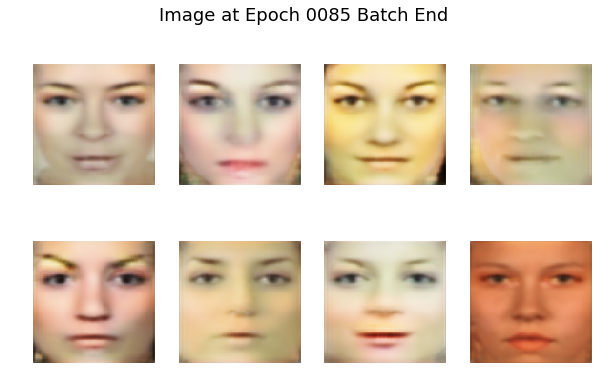

Epoch 86 starts!
Time for epoch 86 is 11.416656 sec, Total time is 426.064012 sec
Train SSIM: 0.498, Test SSIM 0.234, Train MAE: 0.204, Test MAE: 0.367
Epoch 87 starts!
Time for epoch 87 is 11.333606 sec, Total time is 437.398189 sec
Train SSIM: 0.509, Test SSIM 0.238, Train MAE: 0.197, Test MAE: 0.365
Epoch 88 starts!
Time for epoch 88 is 11.396535 sec, Total time is 448.795288 sec
Train SSIM: 0.490, Test SSIM 0.226, Train MAE: 0.206, Test MAE: 0.372
Epoch 89 starts!
Time for epoch 89 is 11.436307 sec, Total time is 460.232096 sec
Train SSIM: 0.512, Test SSIM 0.241, Train MAE: 0.195, Test MAE: 0.362
Epoch 90 starts!
Time for epoch 90 is 11.401827 sec, Total time is 471.634487 sec
Train SSIM: 0.505, Test SSIM 0.239, Train MAE: 0.199, Test MAE: 0.365


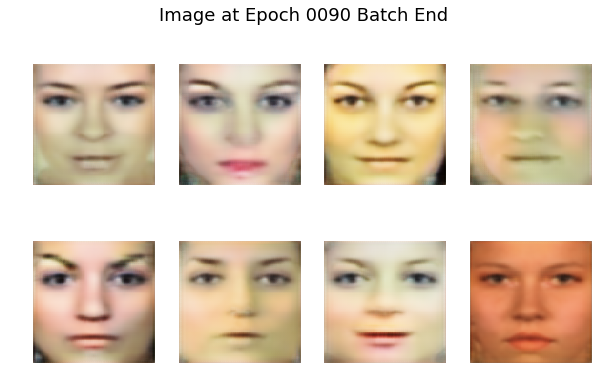

Epoch 91 starts!
Time for epoch 91 is 11.408294 sec, Total time is 484.918508 sec
Train SSIM: 0.512, Test SSIM 0.241, Train MAE: 0.195, Test MAE: 0.362
Epoch 92 starts!
Time for epoch 92 is 11.588758 sec, Total time is 496.507782 sec
Train SSIM: 0.506, Test SSIM 0.236, Train MAE: 0.199, Test MAE: 0.365
Epoch 93 starts!
Time for epoch 93 is 11.352066 sec, Total time is 507.860467 sec
Train SSIM: 0.505, Test SSIM 0.237, Train MAE: 0.199, Test MAE: 0.364
Epoch 94 starts!
Time for epoch 94 is 11.364312 sec, Total time is 519.225289 sec
Train SSIM: 0.514, Test SSIM 0.241, Train MAE: 0.195, Test MAE: 0.365
Epoch 95 starts!
Time for epoch 95 is 11.354985 sec, Total time is 530.580901 sec
Train SSIM: 0.521, Test SSIM 0.244, Train MAE: 0.193, Test MAE: 0.364


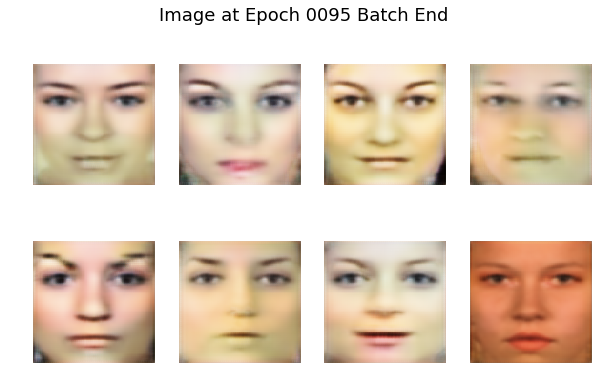

Epoch 96 starts!
Time for epoch 96 is 11.829518 sec, Total time is 544.495528 sec
Train SSIM: 0.515, Test SSIM 0.241, Train MAE: 0.194, Test MAE: 0.363
Epoch 97 starts!
Time for epoch 97 is 11.374794 sec, Total time is 555.870862 sec
Train SSIM: 0.506, Test SSIM 0.236, Train MAE: 0.199, Test MAE: 0.364
Epoch 98 starts!
Time for epoch 98 is 11.353653 sec, Total time is 567.225086 sec
Train SSIM: 0.500, Test SSIM 0.233, Train MAE: 0.201, Test MAE: 0.366
Epoch 99 starts!
Time for epoch 99 is 11.775136 sec, Total time is 579.000816 sec
Train SSIM: 0.513, Test SSIM 0.237, Train MAE: 0.196, Test MAE: 0.367
Epoch 100 starts!
Time for epoch 100 is 11.338715 sec, Total time is 590.340111 sec
Train SSIM: 0.510, Test SSIM 0.234, Train MAE: 0.197, Test MAE: 0.365


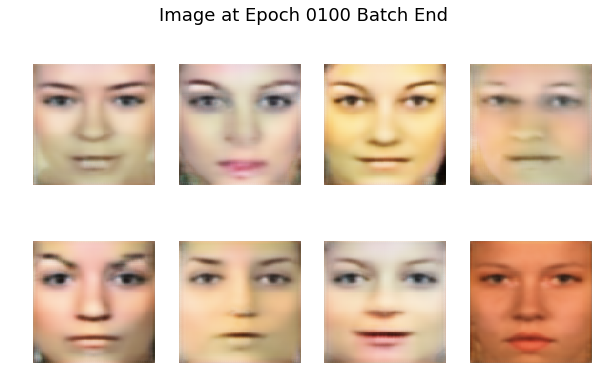

In [0]:
result_tuples_2_1 = re_train(50, 50, 'cross_entropy', 'SSIM')

In [0]:
save_hist(result_tuples_2, 0, 'cross_entropy', 'SSIM')
save_hist(result_tuples_2_1, 1, 'cross_entropy', 'SSIM')
zip_image('cross_entropy', 'SSIM')
create_gif('cross_entropy', 'SSIM')

##'cross_entropy', 'L1'

Epoch 1 starts!
Time for epoch 1 is 206.204047 sec, Total time is 206.204048 sec
Train SSIM: 0.140, Test SSIM 0.089, Train MAE: 0.384, Test MAE: 0.394
Epoch 2 starts!
Time for epoch 2 is 13.461056 sec, Total time is 219.665725 sec
Train SSIM: 0.278, Test SSIM 0.167, Train MAE: 0.296, Test MAE: 0.344
Epoch 3 starts!
Time for epoch 3 is 13.777067 sec, Total time is 233.443490 sec
Train SSIM: 0.358, Test SSIM 0.216, Train MAE: 0.256, Test MAE: 0.334
Epoch 4 starts!
Time for epoch 4 is 13.718024 sec, Total time is 247.162150 sec
Train SSIM: 0.375, Test SSIM 0.221, Train MAE: 0.246, Test MAE: 0.342
Epoch 5 starts!
Time for epoch 5 is 13.234597 sec, Total time is 260.397350 sec
Train SSIM: 0.376, Test SSIM 0.220, Train MAE: 0.245, Test MAE: 0.345


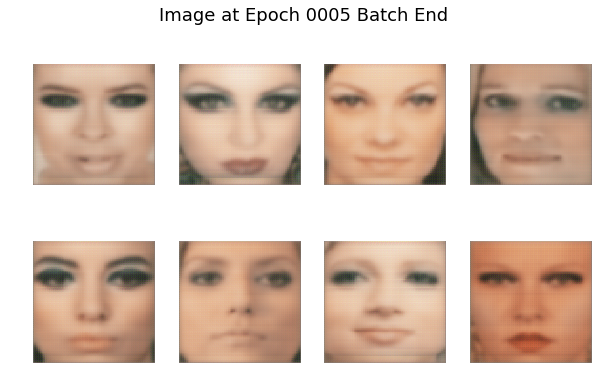

Epoch 6 starts!
Time for epoch 6 is 13.154512 sec, Total time is 275.920496 sec
Train SSIM: 0.394, Test SSIM 0.226, Train MAE: 0.239, Test MAE: 0.349
Epoch 7 starts!
Time for epoch 7 is 13.355218 sec, Total time is 289.276303 sec
Train SSIM: 0.399, Test SSIM 0.233, Train MAE: 0.236, Test MAE: 0.353
Epoch 8 starts!
Time for epoch 8 is 13.250979 sec, Total time is 302.527937 sec
Train SSIM: 0.401, Test SSIM 0.232, Train MAE: 0.236, Test MAE: 0.358
Epoch 9 starts!
Time for epoch 9 is 13.383555 sec, Total time is 315.912047 sec
Train SSIM: 0.400, Test SSIM 0.236, Train MAE: 0.238, Test MAE: 0.364
Epoch 10 starts!
Time for epoch 10 is 13.530360 sec, Total time is 329.443120 sec
Train SSIM: 0.404, Test SSIM 0.230, Train MAE: 0.237, Test MAE: 0.368


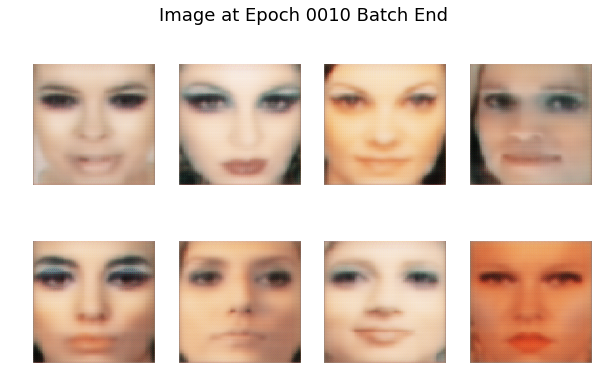

Epoch 11 starts!
Time for epoch 11 is 13.067067 sec, Total time is 344.983523 sec
Train SSIM: 0.405, Test SSIM 0.235, Train MAE: 0.237, Test MAE: 0.369
Epoch 12 starts!
Time for epoch 12 is 12.913415 sec, Total time is 357.897513 sec
Train SSIM: 0.398, Test SSIM 0.225, Train MAE: 0.241, Test MAE: 0.377
Epoch 13 starts!
Time for epoch 13 is 12.993261 sec, Total time is 370.891382 sec
Train SSIM: 0.401, Test SSIM 0.231, Train MAE: 0.244, Test MAE: 0.381
Epoch 14 starts!
Time for epoch 14 is 12.878599 sec, Total time is 383.770496 sec
Train SSIM: 0.400, Test SSIM 0.233, Train MAE: 0.243, Test MAE: 0.383
Epoch 15 starts!
Time for epoch 15 is 12.944085 sec, Total time is 396.715136 sec
Train SSIM: 0.393, Test SSIM 0.221, Train MAE: 0.245, Test MAE: 0.390


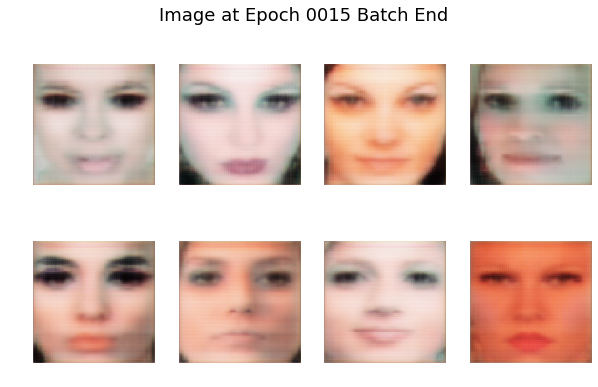

Epoch 16 starts!
Time for epoch 16 is 12.994964 sec, Total time is 411.813118 sec
Train SSIM: 0.402, Test SSIM 0.234, Train MAE: 0.252, Test MAE: 0.398
Epoch 17 starts!
Time for epoch 17 is 12.876191 sec, Total time is 424.689857 sec
Train SSIM: 0.397, Test SSIM 0.238, Train MAE: 0.266, Test MAE: 0.406
Epoch 18 starts!
Time for epoch 18 is 12.936952 sec, Total time is 437.627388 sec
Train SSIM: 0.401, Test SSIM 0.247, Train MAE: 0.258, Test MAE: 0.395
Epoch 19 starts!
Time for epoch 19 is 12.960865 sec, Total time is 450.588785 sec
Train SSIM: 0.402, Test SSIM 0.250, Train MAE: 0.263, Test MAE: 0.399
Epoch 20 starts!
Time for epoch 20 is 12.877006 sec, Total time is 463.466362 sec
Train SSIM: 0.399, Test SSIM 0.242, Train MAE: 0.268, Test MAE: 0.410


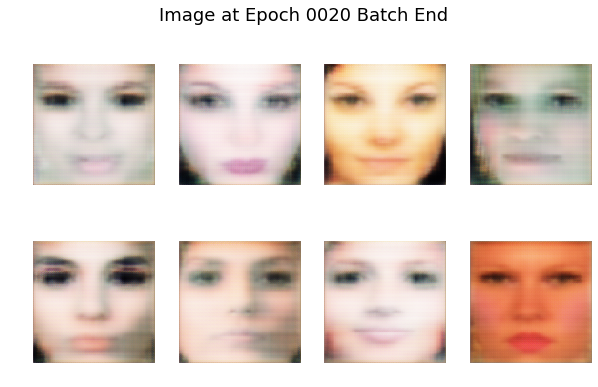

Epoch 21 starts!
Time for epoch 21 is 13.357289 sec, Total time is 478.935650 sec
Train SSIM: 0.401, Test SSIM 0.245, Train MAE: 0.265, Test MAE: 0.403
Epoch 22 starts!
Time for epoch 22 is 13.149854 sec, Total time is 492.086153 sec
Train SSIM: 0.397, Test SSIM 0.242, Train MAE: 0.277, Test MAE: 0.417
Epoch 23 starts!
Time for epoch 23 is 12.949281 sec, Total time is 505.035974 sec
Train SSIM: 0.394, Test SSIM 0.245, Train MAE: 0.265, Test MAE: 0.403
Epoch 24 starts!
Time for epoch 24 is 12.932969 sec, Total time is 517.969510 sec
Train SSIM: 0.393, Test SSIM 0.248, Train MAE: 0.269, Test MAE: 0.406
Epoch 25 starts!
Time for epoch 25 is 12.915011 sec, Total time is 530.885137 sec
Train SSIM: 0.394, Test SSIM 0.241, Train MAE: 0.271, Test MAE: 0.414


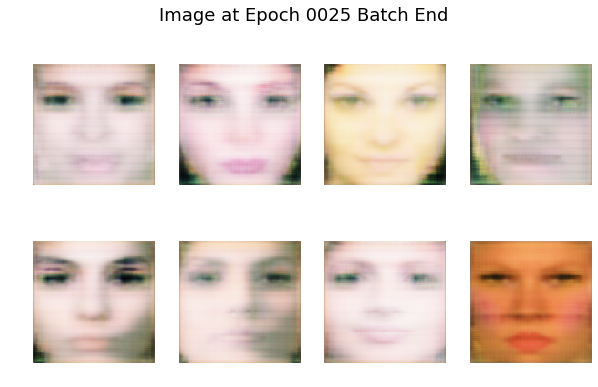

Epoch 26 starts!
Time for epoch 26 is 12.923806 sec, Total time is 545.949555 sec
Train SSIM: 0.387, Test SSIM 0.248, Train MAE: 0.281, Test MAE: 0.416
Epoch 27 starts!
Time for epoch 27 is 13.029937 sec, Total time is 558.979700 sec
Train SSIM: 0.396, Test SSIM 0.248, Train MAE: 0.261, Test MAE: 0.399
Epoch 28 starts!
Time for epoch 28 is 13.136453 sec, Total time is 572.116365 sec
Train SSIM: 0.395, Test SSIM 0.241, Train MAE: 0.257, Test MAE: 0.399
Epoch 29 starts!
Time for epoch 29 is 12.937424 sec, Total time is 585.054365 sec
Train SSIM: 0.393, Test SSIM 0.247, Train MAE: 0.256, Test MAE: 0.394
Epoch 30 starts!
Time for epoch 30 is 12.952456 sec, Total time is 598.007391 sec
Train SSIM: 0.405, Test SSIM 0.242, Train MAE: 0.260, Test MAE: 0.410


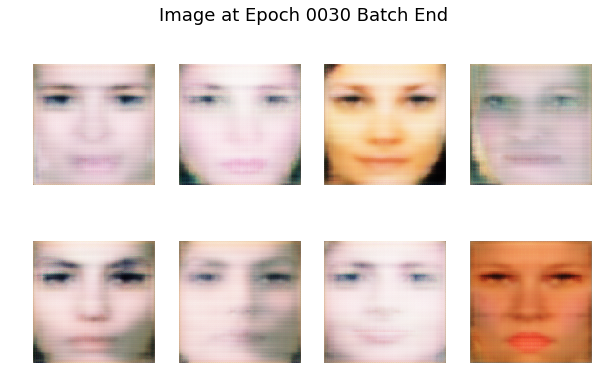

Epoch 31 starts!
Time for epoch 31 is 13.022596 sec, Total time is 613.201306 sec
Train SSIM: 0.402, Test SSIM 0.245, Train MAE: 0.256, Test MAE: 0.400
Epoch 32 starts!
Time for epoch 32 is 12.949898 sec, Total time is 626.151810 sec
Train SSIM: 0.404, Test SSIM 0.245, Train MAE: 0.260, Test MAE: 0.405
Epoch 33 starts!
Time for epoch 33 is 13.027025 sec, Total time is 639.179422 sec
Train SSIM: 0.409, Test SSIM 0.245, Train MAE: 0.256, Test MAE: 0.401
Epoch 34 starts!
Time for epoch 34 is 13.118014 sec, Total time is 652.298030 sec
Train SSIM: 0.413, Test SSIM 0.241, Train MAE: 0.257, Test MAE: 0.407
Epoch 35 starts!
Time for epoch 35 is 12.904186 sec, Total time is 665.202765 sec
Train SSIM: 0.418, Test SSIM 0.238, Train MAE: 0.252, Test MAE: 0.406


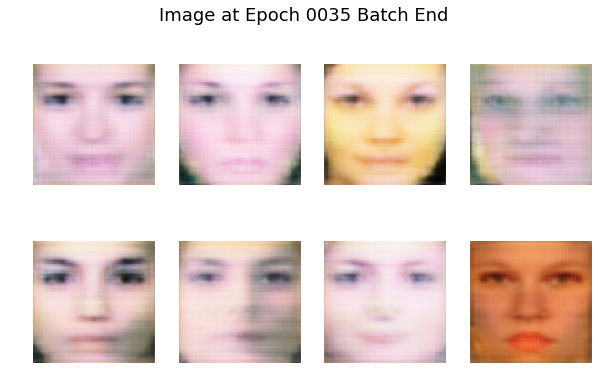

Epoch 36 starts!
Time for epoch 36 is 12.924036 sec, Total time is 680.336590 sec
Train SSIM: 0.418, Test SSIM 0.244, Train MAE: 0.256, Test MAE: 0.411
Epoch 37 starts!
Time for epoch 37 is 12.917709 sec, Total time is 693.254879 sec
Train SSIM: 0.416, Test SSIM 0.243, Train MAE: 0.254, Test MAE: 0.406
Epoch 38 starts!
Time for epoch 38 is 13.019941 sec, Total time is 706.275192 sec
Train SSIM: 0.413, Test SSIM 0.239, Train MAE: 0.250, Test MAE: 0.405
Epoch 39 starts!
Time for epoch 39 is 13.082409 sec, Total time is 719.357818 sec
Train SSIM: 0.413, Test SSIM 0.242, Train MAE: 0.252, Test MAE: 0.404
Epoch 40 starts!
Time for epoch 40 is 13.155199 sec, Total time is 732.513527 sec
Train SSIM: 0.422, Test SSIM 0.235, Train MAE: 0.258, Test MAE: 0.418


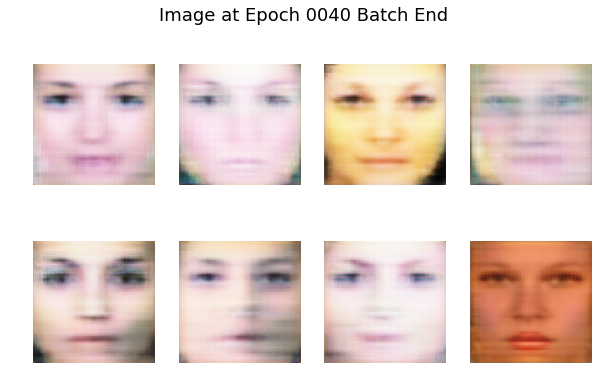

Epoch 41 starts!
Time for epoch 41 is 13.048399 sec, Total time is 747.803587 sec
Train SSIM: 0.421, Test SSIM 0.241, Train MAE: 0.253, Test MAE: 0.412
Epoch 42 starts!
Time for epoch 42 is 12.991016 sec, Total time is 760.795143 sec
Train SSIM: 0.422, Test SSIM 0.240, Train MAE: 0.249, Test MAE: 0.405
Epoch 43 starts!
Time for epoch 43 is 13.011000 sec, Total time is 773.806732 sec
Train SSIM: 0.420, Test SSIM 0.247, Train MAE: 0.245, Test MAE: 0.395
Epoch 44 starts!
Time for epoch 44 is 13.105278 sec, Total time is 786.912212 sec
Train SSIM: 0.429, Test SSIM 0.243, Train MAE: 0.250, Test MAE: 0.404
Epoch 45 starts!
Time for epoch 45 is 13.212439 sec, Total time is 800.124844 sec
Train SSIM: 0.430, Test SSIM 0.243, Train MAE: 0.245, Test MAE: 0.402


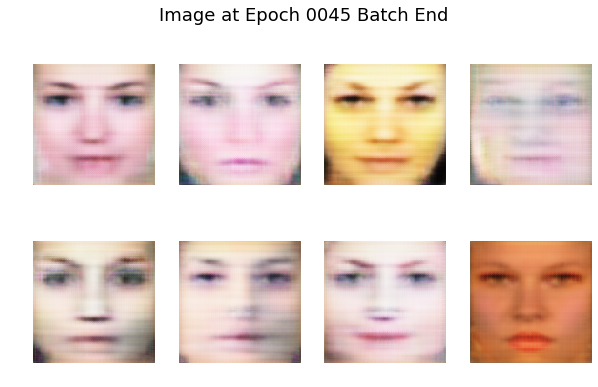

Epoch 46 starts!
Time for epoch 46 is 13.094820 sec, Total time is 815.605226 sec
Train SSIM: 0.435, Test SSIM 0.242, Train MAE: 0.239, Test MAE: 0.397
Epoch 47 starts!
Time for epoch 47 is 12.957242 sec, Total time is 828.563014 sec
Train SSIM: 0.429, Test SSIM 0.241, Train MAE: 0.245, Test MAE: 0.402
Epoch 48 starts!
Time for epoch 48 is 12.965029 sec, Total time is 841.528667 sec
Train SSIM: 0.434, Test SSIM 0.240, Train MAE: 0.248, Test MAE: 0.410
Epoch 49 starts!
Time for epoch 49 is 12.918912 sec, Total time is 854.448315 sec
Train SSIM: 0.426, Test SSIM 0.243, Train MAE: 0.245, Test MAE: 0.402
Epoch 50 starts!
Time for epoch 50 is 12.891333 sec, Total time is 867.340264 sec
Train SSIM: 0.440, Test SSIM 0.237, Train MAE: 0.238, Test MAE: 0.403


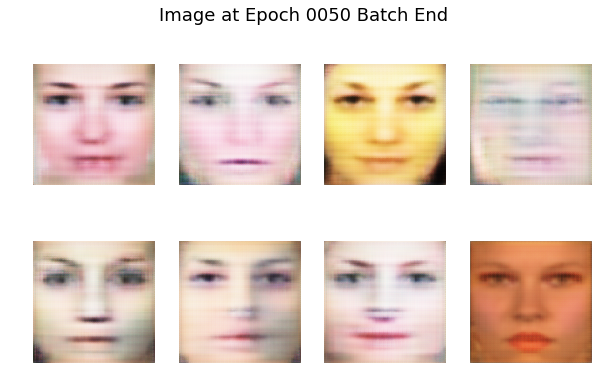

In [0]:
generator = make_generator_model()
discriminator = make_discriminator_model()
generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0., beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0., beta_2=0.9)
result_tuples_3 = train(EPOCHS, 'cross_entropy', 'L1')

Epoch 51 starts!
Time for epoch 51 is 13.547054 sec, Total time is 13.547061 sec
Train SSIM: 0.443, Test SSIM 0.237, Train MAE: 0.231, Test MAE: 0.399
Epoch 52 starts!
Time for epoch 52 is 12.972939 sec, Total time is 26.520489 sec
Train SSIM: 0.443, Test SSIM 0.236, Train MAE: 0.228, Test MAE: 0.395
Epoch 53 starts!
Time for epoch 53 is 13.063471 sec, Total time is 39.584606 sec
Train SSIM: 0.444, Test SSIM 0.238, Train MAE: 0.228, Test MAE: 0.390
Epoch 54 starts!
Time for epoch 54 is 13.037390 sec, Total time is 52.622552 sec
Train SSIM: 0.442, Test SSIM 0.239, Train MAE: 0.235, Test MAE: 0.404
Epoch 55 starts!
Time for epoch 55 is 12.971280 sec, Total time is 65.594427 sec
Train SSIM: 0.453, Test SSIM 0.241, Train MAE: 0.227, Test MAE: 0.396


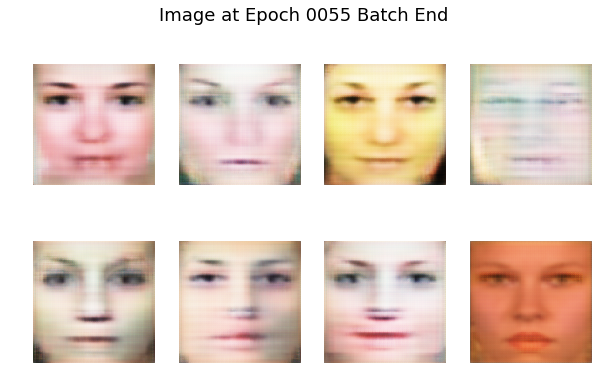

Epoch 56 starts!
Time for epoch 56 is 13.058207 sec, Total time is 80.990349 sec
Train SSIM: 0.450, Test SSIM 0.239, Train MAE: 0.229, Test MAE: 0.398
Epoch 57 starts!
Time for epoch 57 is 13.238241 sec, Total time is 94.229176 sec
Train SSIM: 0.444, Test SSIM 0.239, Train MAE: 0.228, Test MAE: 0.390
Epoch 58 starts!
Time for epoch 58 is 12.907408 sec, Total time is 107.137136 sec
Train SSIM: 0.458, Test SSIM 0.238, Train MAE: 0.226, Test MAE: 0.402
Epoch 59 starts!
Time for epoch 59 is 12.996811 sec, Total time is 120.134699 sec
Train SSIM: 0.452, Test SSIM 0.245, Train MAE: 0.226, Test MAE: 0.394
Epoch 60 starts!
Time for epoch 60 is 12.853743 sec, Total time is 132.989090 sec
Train SSIM: 0.454, Test SSIM 0.236, Train MAE: 0.218, Test MAE: 0.393


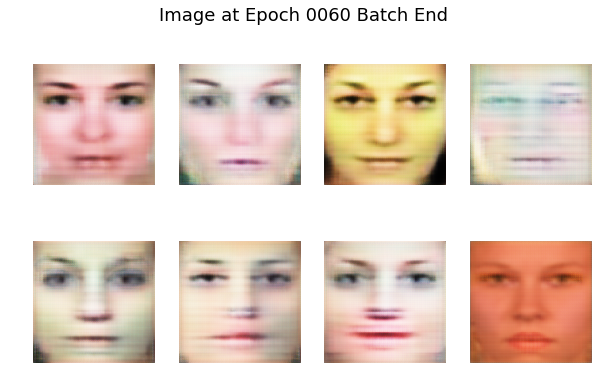

Epoch 61 starts!
Time for epoch 61 is 13.398195 sec, Total time is 148.831928 sec
Train SSIM: 0.454, Test SSIM 0.244, Train MAE: 0.221, Test MAE: 0.388
Epoch 62 starts!
Time for epoch 62 is 13.017392 sec, Total time is 161.849538 sec
Train SSIM: 0.453, Test SSIM 0.243, Train MAE: 0.218, Test MAE: 0.386
Epoch 63 starts!
Time for epoch 63 is 13.247522 sec, Total time is 175.097674 sec
Train SSIM: 0.460, Test SSIM 0.242, Train MAE: 0.218, Test MAE: 0.391
Epoch 64 starts!
Time for epoch 64 is 12.894961 sec, Total time is 187.993212 sec
Train SSIM: 0.458, Test SSIM 0.243, Train MAE: 0.213, Test MAE: 0.384
Epoch 65 starts!
Time for epoch 65 is 12.865973 sec, Total time is 200.859689 sec
Train SSIM: 0.462, Test SSIM 0.241, Train MAE: 0.215, Test MAE: 0.389


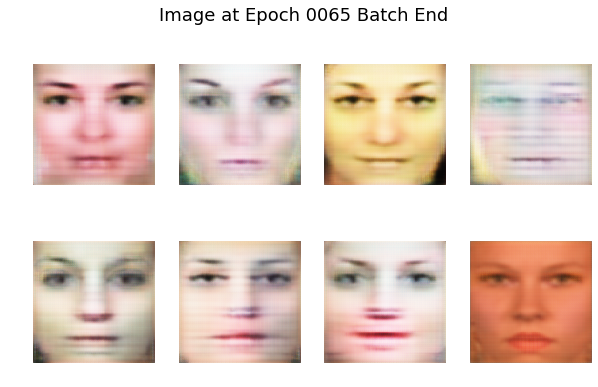

Epoch 66 starts!
Time for epoch 66 is 12.921871 sec, Total time is 216.089174 sec
Train SSIM: 0.459, Test SSIM 0.241, Train MAE: 0.219, Test MAE: 0.393
Epoch 67 starts!
Time for epoch 67 is 12.868164 sec, Total time is 228.957699 sec
Train SSIM: 0.467, Test SSIM 0.242, Train MAE: 0.206, Test MAE: 0.383
Epoch 68 starts!
Time for epoch 68 is 12.847221 sec, Total time is 241.805115 sec
Train SSIM: 0.460, Test SSIM 0.245, Train MAE: 0.218, Test MAE: 0.392
Epoch 69 starts!
Time for epoch 69 is 13.209229 sec, Total time is 255.014943 sec
Train SSIM: 0.462, Test SSIM 0.243, Train MAE: 0.213, Test MAE: 0.387
Epoch 70 starts!
Time for epoch 70 is 12.829349 sec, Total time is 267.844814 sec
Train SSIM: 0.465, Test SSIM 0.242, Train MAE: 0.212, Test MAE: 0.390


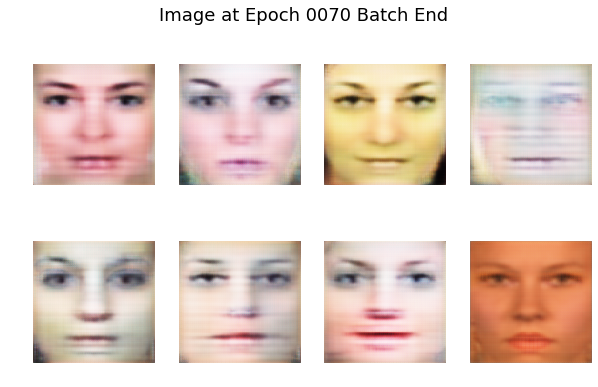

Epoch 71 starts!
Time for epoch 71 is 13.094743 sec, Total time is 283.207107 sec
Train SSIM: 0.467, Test SSIM 0.243, Train MAE: 0.211, Test MAE: 0.388
Epoch 72 starts!
Time for epoch 72 is 13.091425 sec, Total time is 296.299103 sec
Train SSIM: 0.470, Test SSIM 0.239, Train MAE: 0.205, Test MAE: 0.386
Epoch 73 starts!
Time for epoch 73 is 12.939772 sec, Total time is 309.239427 sec
Train SSIM: 0.469, Test SSIM 0.240, Train MAE: 0.206, Test MAE: 0.386
Epoch 74 starts!
Time for epoch 74 is 12.997467 sec, Total time is 322.237414 sec
Train SSIM: 0.472, Test SSIM 0.240, Train MAE: 0.208, Test MAE: 0.389
Epoch 75 starts!
Time for epoch 75 is 13.263578 sec, Total time is 335.501457 sec
Train SSIM: 0.472, Test SSIM 0.239, Train MAE: 0.206, Test MAE: 0.387


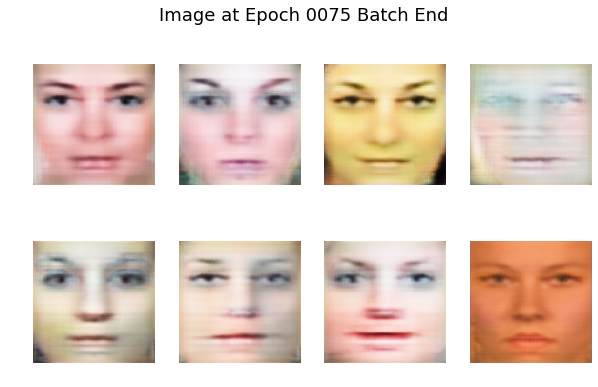

Epoch 76 starts!
Time for epoch 76 is 13.057581 sec, Total time is 350.931540 sec
Train SSIM: 0.474, Test SSIM 0.244, Train MAE: 0.206, Test MAE: 0.388
Epoch 77 starts!
Time for epoch 77 is 13.013276 sec, Total time is 363.945019 sec
Train SSIM: 0.472, Test SSIM 0.242, Train MAE: 0.205, Test MAE: 0.384
Epoch 78 starts!
Time for epoch 78 is 12.996026 sec, Total time is 376.941638 sec
Train SSIM: 0.479, Test SSIM 0.238, Train MAE: 0.199, Test MAE: 0.387
Epoch 79 starts!
Time for epoch 79 is 13.033916 sec, Total time is 389.976164 sec
Train SSIM: 0.474, Test SSIM 0.246, Train MAE: 0.208, Test MAE: 0.390
Epoch 80 starts!
Time for epoch 80 is 13.040142 sec, Total time is 403.016835 sec
Train SSIM: 0.477, Test SSIM 0.243, Train MAE: 0.205, Test MAE: 0.387


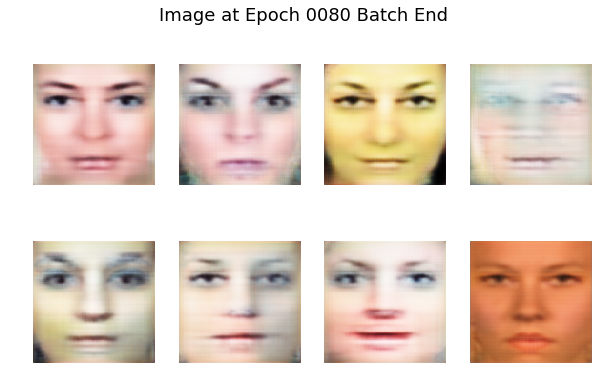

Epoch 81 starts!
Time for epoch 81 is 13.306681 sec, Total time is 418.810039 sec
Train SSIM: 0.477, Test SSIM 0.242, Train MAE: 0.205, Test MAE: 0.389
Epoch 82 starts!
Time for epoch 82 is 12.953901 sec, Total time is 431.764523 sec
Train SSIM: 0.480, Test SSIM 0.243, Train MAE: 0.200, Test MAE: 0.382
Epoch 83 starts!
Time for epoch 83 is 12.954803 sec, Total time is 444.719873 sec
Train SSIM: 0.477, Test SSIM 0.240, Train MAE: 0.200, Test MAE: 0.383
Epoch 84 starts!
Time for epoch 84 is 13.318362 sec, Total time is 458.038905 sec
Train SSIM: 0.479, Test SSIM 0.244, Train MAE: 0.199, Test MAE: 0.380
Epoch 85 starts!
Time for epoch 85 is 12.893485 sec, Total time is 470.932972 sec
Train SSIM: 0.485, Test SSIM 0.242, Train MAE: 0.195, Test MAE: 0.381


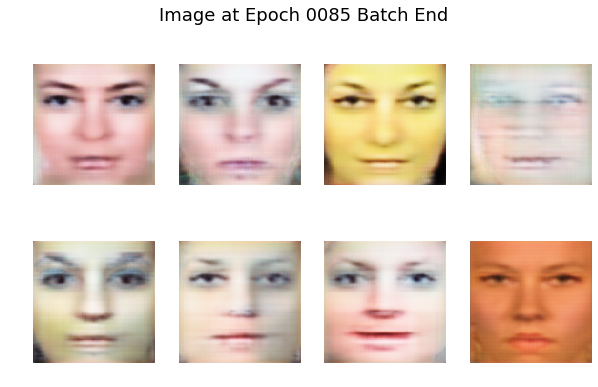

Epoch 86 starts!
Time for epoch 86 is 13.204396 sec, Total time is 486.488552 sec
Train SSIM: 0.484, Test SSIM 0.241, Train MAE: 0.199, Test MAE: 0.386
Epoch 87 starts!
Time for epoch 87 is 13.354751 sec, Total time is 499.843947 sec
Train SSIM: 0.485, Test SSIM 0.241, Train MAE: 0.195, Test MAE: 0.382
Epoch 88 starts!
Time for epoch 88 is 13.022124 sec, Total time is 512.866283 sec
Train SSIM: 0.485, Test SSIM 0.238, Train MAE: 0.195, Test MAE: 0.384
Epoch 89 starts!
Time for epoch 89 is 12.980107 sec, Total time is 525.846953 sec
Train SSIM: 0.486, Test SSIM 0.240, Train MAE: 0.198, Test MAE: 0.391
Epoch 90 starts!
Time for epoch 90 is 12.963489 sec, Total time is 538.811067 sec
Train SSIM: 0.488, Test SSIM 0.245, Train MAE: 0.197, Test MAE: 0.383


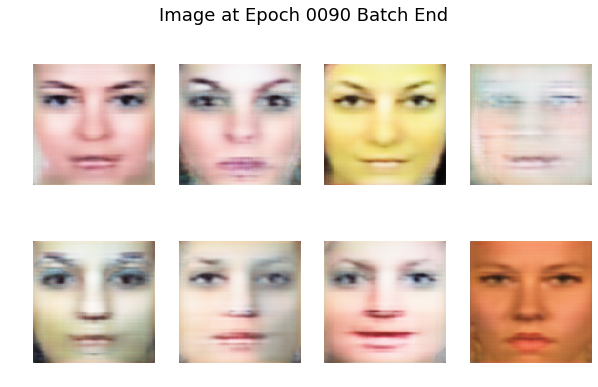

Epoch 91 starts!
Time for epoch 91 is 13.073747 sec, Total time is 554.274046 sec
Train SSIM: 0.485, Test SSIM 0.241, Train MAE: 0.193, Test MAE: 0.381
Epoch 92 starts!
Time for epoch 92 is 13.177396 sec, Total time is 567.451992 sec
Train SSIM: 0.488, Test SSIM 0.245, Train MAE: 0.195, Test MAE: 0.383
Epoch 93 starts!
Time for epoch 93 is 13.273908 sec, Total time is 580.726110 sec
Train SSIM: 0.487, Test SSIM 0.246, Train MAE: 0.193, Test MAE: 0.380
Epoch 94 starts!
Time for epoch 94 is 13.078072 sec, Total time is 593.804790 sec
Train SSIM: 0.495, Test SSIM 0.241, Train MAE: 0.190, Test MAE: 0.382
Epoch 95 starts!
Time for epoch 95 is 13.136551 sec, Total time is 606.941863 sec
Train SSIM: 0.494, Test SSIM 0.245, Train MAE: 0.192, Test MAE: 0.384


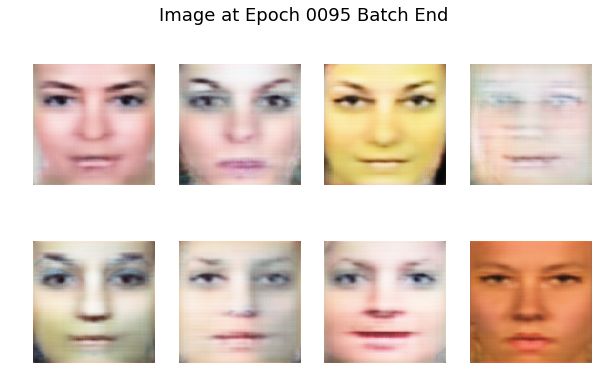

Epoch 96 starts!
Time for epoch 96 is 13.099075 sec, Total time is 622.433500 sec
Train SSIM: 0.494, Test SSIM 0.240, Train MAE: 0.192, Test MAE: 0.384
Epoch 97 starts!
Time for epoch 97 is 13.076908 sec, Total time is 635.510970 sec
Train SSIM: 0.498, Test SSIM 0.243, Train MAE: 0.189, Test MAE: 0.379
Epoch 98 starts!
Time for epoch 98 is 13.145681 sec, Total time is 648.657227 sec
Train SSIM: 0.497, Test SSIM 0.241, Train MAE: 0.188, Test MAE: 0.381
Epoch 99 starts!
Time for epoch 99 is 13.145430 sec, Total time is 661.803221 sec
Train SSIM: 0.494, Test SSIM 0.246, Train MAE: 0.193, Test MAE: 0.382
Epoch 100 starts!
Time for epoch 100 is 12.952119 sec, Total time is 674.755801 sec
Train SSIM: 0.501, Test SSIM 0.245, Train MAE: 0.188, Test MAE: 0.382


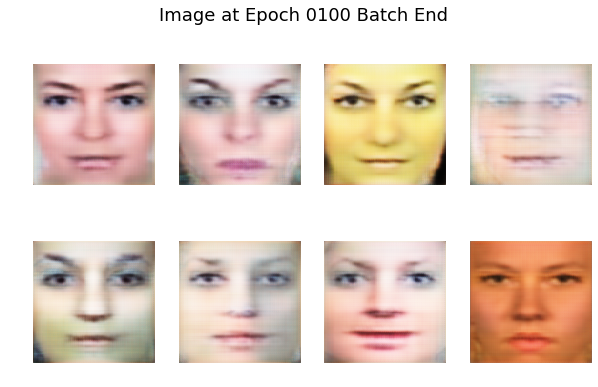

In [0]:
result_tuples_3_1 = re_train(50, 50, 'cross_entropy', 'L1')

In [0]:
save_hist(result_tuples_3, 0, 'cross_entropy', 'L1')
save_hist(result_tuples_3_1, 1, 'cross_entropy', 'L1')
zip_image('cross_entropy', 'L1')
create_gif('cross_entropy', 'L1')

## Show results

In [0]:
def read_result_from_mat(matfile):
    result_0 = loadmat(matfile)
    result_tuple_0 = []
    for e, i in enumerate(result_0.keys()):
        if e>2:
            result_tuple_0.append(result_0[i])
    result_tuple_0 = tuple(result_tuple_0)
    result_tuple_0 = []
    for e, i in enumerate(result_0.keys()):
        if e>2:
            result_tuple_0.append(result_0[i])
    result_tuple_0 = tuple(result_tuple_0)
    return result_tuple_0

In [0]:
def combine_result(r0, r1):
    c_r = []
    for e, (x, y) in enumerate(zip(r0, r1)):
        if e==0:
            c_r.append(y)
        else:
            c_r.append(np.concatenate([x, y], axis=0))
    return tuple(c_r)

In [0]:
def show_loss(result_tuple, suptitle):
    (_, train_gl_list, train_dl_list, train_mae_list,
     train_ssim_list, test_gl_list, test_dl_list,
     test_mae_list, test_ssim_list) = result_tuple
    fig, ax = plt.subplots(2, 2, figsize=(10, 8))
    plt.suptitle(suptitle, fontsize=18)
    ax[0,0].plot(train_gl_list, linestyle='--', label="Train Generator Loss")
    ax[0,1].plot(train_dl_list, linestyle='--', label="Train Discriminator Loss")
    ax[0,0].plot(test_gl_list, linestyle='-', label="Test Generator Loss")
    ax[0,1].plot(test_dl_list, linestyle='-', label="Test Discriminator Loss")
    ax[0,0].legend()
    ax[0,1].legend()
    ax[0,0].set_xticks([])
    ax[0,1].set_xticks([])
    ax[1,0].plot(train_ssim_list, linestyle='--', label="Train SSIM")
    ax[1,1].plot(train_mae_list, linestyle='--', label="Train MAE")
    ax[1,0].plot(test_ssim_list, linestyle='-', label="Test SSIM")
    ax[1,1].plot(test_mae_list, linestyle='-', label="Test MAE")
    ax[1,0].legend()
    ax[1,1].legend()
    plt.show()
    plt.savefig(suptitle+".png", dpi=600)

In [0]:
rt0 = read_result_from_mat('training_his_0.mat')
rt1 = read_result_from_mat('training_his_1.mat')

In [0]:
r_t = combine_result(rt0, rt1)

In [0]:
show_loss(r_t, "Cross Entropy with MAE Loss")

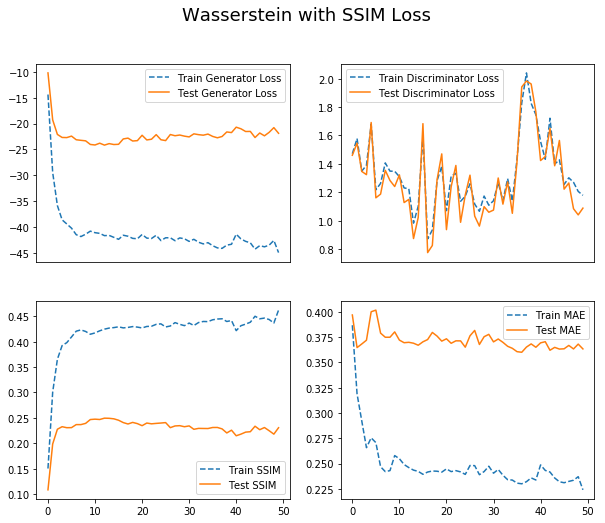

In [0]:
show_loss(result_tuples_0, "Wasserstein with SSIM Loss")
# show_loss(result_tuples_1, "Wasserstein with MAE Loss")
# show_loss(result_tuples_2, "Cross Entropy with SSIM Loss")
# show_loss(result_tuples_3, "Cross Entropy with MAE Loss")

In [0]:
def load_image(filename):
    img = Image.open(filename)
    img.load()
    data = np.asarray(img, dtype="float32")
    return data

In [0]:
def img_comparision(gen_input, gen_output, target=None, filename=None):
    if target is None:
        fig, axs = plt.subplots(1,2, figsize=(8,8))
        axs[0].imshow(np.int32((gen_input[0]+1)*127.5))
        axs[0].axis('off')
        axs[0].set_title("Original With Makeup", color='r')
        
        axs[1].imshow(np.array((gen_output[0]+1)*127.5).astype(int))
        axs[1].axis('off')
        axs[1].set_title("Generated Without Makeup", color='g')
        plt.show()
    else:
        fig, axs = plt.subplots(1,3, figsize=(8,12))
        axs[0].imshow(np.int32((gen_input[0]+1)*127.5))
        axs[0].axis('off')
        axs[0].set_title("Original With Makeup", color='r')
        axs[1].imshow(np.array((gen_output[0]*127.5)+127.5).astype(int))
        axs[1].axis('off')
        axs[1].set_title("Generated Without Makeup", color='g')
        axs[2].imshow(np.array((target[0]*127.5)+127.5).astype(int))
        axs[2].axis('off')
        axs[2].set_title("Real Without Makeup", color='y')        
        plt.show()

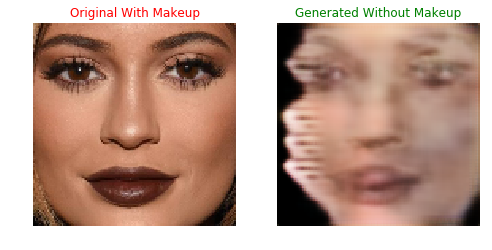

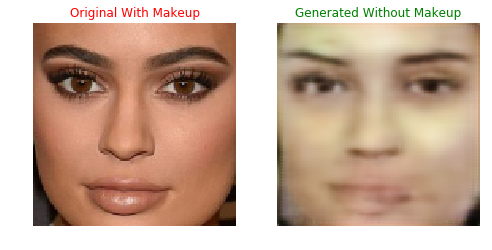

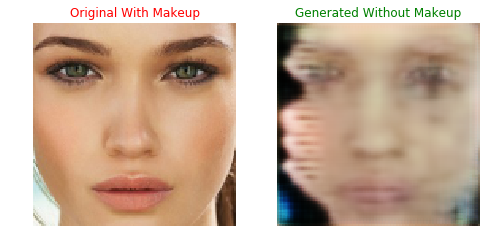

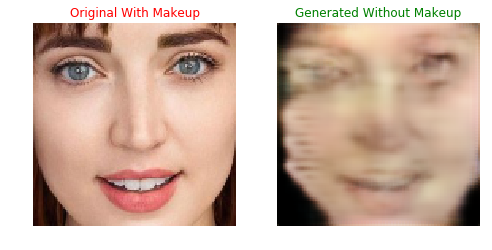

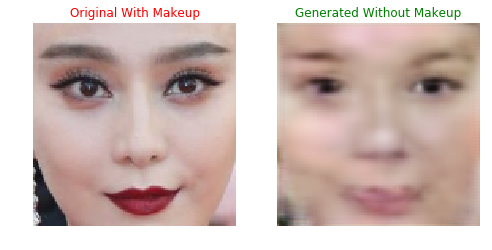

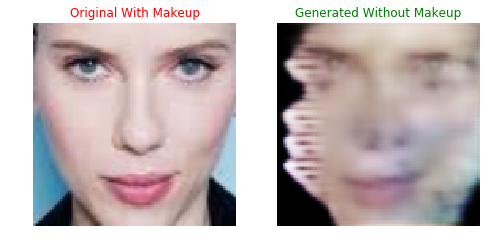

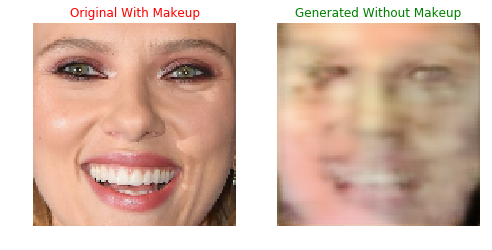

In [0]:
for i in range(1,8):
    im = load_image('%d-1.jpg'%i)
    im = np.array([cv2.resize(im, dsize=(128, 128))])
    im = np.float32((im / 127.5)-1)
    new_image = generator(im, training=False)
    img_comparision(im, new_image)

In [0]:
def calculate_test_ssim_loss(model, test_input, real_output):
    predictions = model(test_input, training=False)
    test_L1 = tf.image.ssim(predictions, real_output, 2.0)
    return test_L1

In [0]:
ssim = calculate_test_ssim_loss(generator, t_data_y, t_data_n)

In [0]:
ssim.numpy().argsort()[-10:]

array([342, 301, 686,  44, 333, 372, 207, 546,   6, 545])

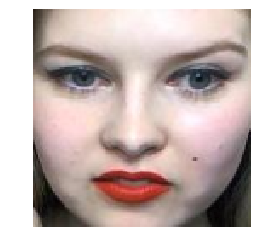

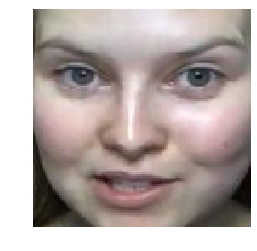

In [0]:
plt.imshow(np.int32((data_y[222]+1)*127.5))
plt.axis("off")
plt.show()
plt.imshow(np.int32((data_n[222]+1)*127.5))
plt.axis("off")
plt.show()

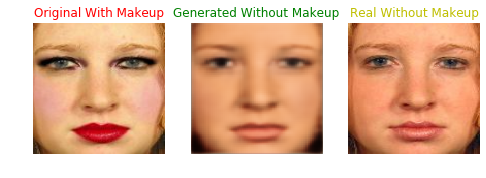

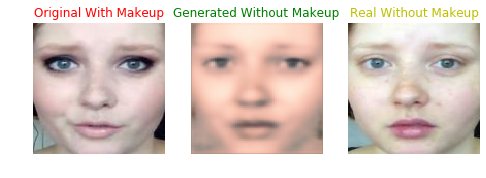

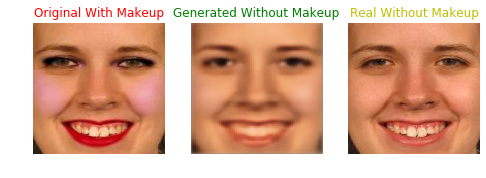

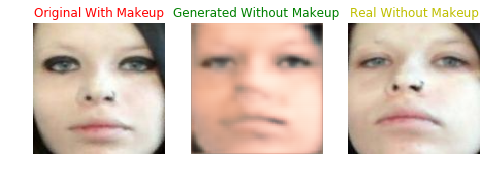

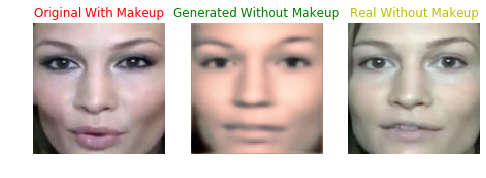

...

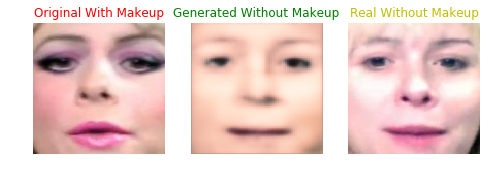

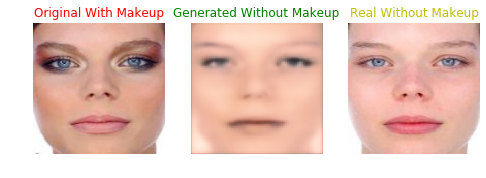

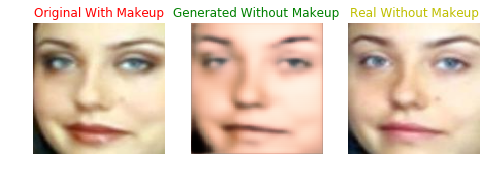

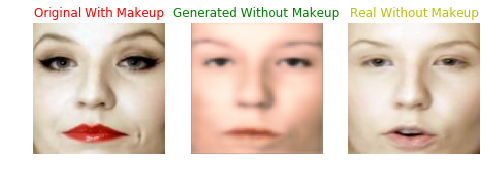

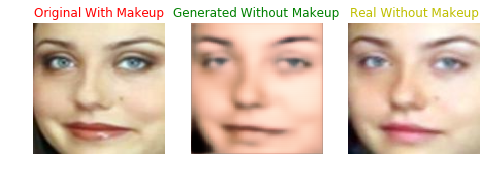

In [0]:
np.random.seed(9)
for_show = ssim.numpy().argsort()[-20:]
for i in for_show:
    im = data_y[i:i+1,:,:,:]
    im_n = data_n[i:i+1,:,:,:]
    new_image = generator(im, training=False)
    img_comparision(im, new_image, im_n)

In [0]:
t1 = tf.constant([1,2,3])
t2 = tf.convert_to_tensor(np.array([1,2,3]), dtype=tf.int32)
tf.reduce_mean(tf.concat([t1, t2], -1)).numpy()

2

In [0]:
generator.save('my_gen.h5')
discriminator.save('my_dis.h5')

In [0]:
# Display a single image using the epoch number
def display_image(epoch_no):
    return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

In [0]:
anim_file = 'gan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    filenames = [i for i in filenames if i not in image_file]
    last = -1
    for i,filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

import IPython
if IPython.version_info > (6,2,0,''):
    display.Image(filename=anim_file)

In [0]:
anim_file = 'gan_all.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    for i,filename in enumerate(filenames):
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

In [0]:
anim_file = 'gan_epoch.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    for i,filename in enumerate(filenames):
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

In [0]:
with zipfile.ZipFile('GAN_Image.zip', 'w') as z:
    for image in filenames:
        z.write(image)

In [0]:
test_data_sample_n.min()

-1.0

In [0]:
value =tf.image.ssim(final_pred, tf.cast(test_data_sample_n, tf.float32), 2.0)
print(value)

tf.Tensor(
[0.5585507  0.6136067  0.6670673  0.653909   0.6127401  0.6011997
 0.529983   0.55564594], shape=(8,), dtype=float32)


In [0]:
tf.reduce_mean(tf.abs(final_pred - tf.cast(test_data_sample_n, tf.float32)))

<tf.Tensor: id=213957, shape=(), dtype=float32, numpy=0.14066555>

In [0]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
gan_loss = cross_entropy(tf.ones_like(final_pred),final_pred)
print(gan_loss)

tf.Tensor(0.56303835, shape=(), dtype=float32)


In [0]:
np.array((pred[0]*127.5)+127.5).astype(int).max()

231

In [0]:
plt.imshow(np.array((pred[3]*127.5)+127.5).astype(int))
plt.show()

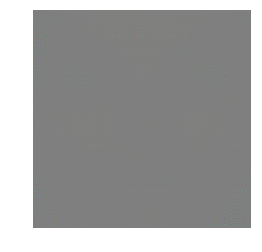

In [0]:
gg = generator(data_n[1:2], training=False)
hehe = discriminator(inputs=[gg, data_y[1:2]], training=False)
plt.imshow(tf.cast(((gg[0]+1.)*127.5),  dtype=tf.int32))
plt.axis('off')
plt.show()

In [0]:
def make_generator_model():
    initializer = tf.keras.initializers.RandomNormal(0., 0.02)
    main_input = layers.Input(shape=(256, 256, 3))
    model.add(layers.Conv2D(input_shape=(256, 256, 3),
                            filters=64, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.Conv2D(filters=128, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(filters=256, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(filters=512, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(filters=512, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(filters=512, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(filters=512, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.Conv2D(filters=512, kernel_size=4,
                            padding='same',
                            kernel_initializer = initializer,
                            use_bias=False))
    model.add(layers.BatchNormalization())
    model = tf.keras.Model(inputs=)
    
    

#Old Version

In [0]:
def downsample(x, filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    x = layers.Conv2D(filters,
                      kernel_size=(size, size),
                      strides=2,
                      padding='same',
                      kernel_initializer=initializer,
                      use_bias=False)(x)
    if apply_batchnorm:
        x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    return x

def upsample(x1, x2, filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    x1 = layers.Conv2DTranspose(filters,
                              kernel_size=(size, size),
                              strides=2,
                              padding='same',
                              kernel_initializer=initializer,
                              use_bias=False)(x1)
    x1 = layers.BatchNormalization()(x1)
    if apply_dropout:
        x1 = layers.Dropout(0.5)(x1)
    x1 = layers.ReLU()(x1)
    x = layers.concatenate([x1, x2])
    return x

def upsample_single(x, filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    x = layers.Conv2DTranspose(filters,
                              kernel_size=(size, size),
                              strides=2,
                              padding='same',
                              kernel_initializer=initializer,
                              use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    if apply_dropout:
        x = layers.Dropout(0.5)(x)
    x = layers.LeakyReLU()(x)
    return x

In [0]:
def make_generator_model():
    initializer = tf.random_normal_initializer(0., 0.02)
    g_input = layers.Input(shape=(128, 128, 3))
    down1 = downsample(g_input, 64, 4, apply_batchnorm=False)
    down2 = downsample(down1, 128, 4)
    down3 = downsample(down2, 256, 4)
    down4 = downsample(down3, 256, 4)
    down5 = downsample(down4, 256, 4)
    down6 = downsample(down5, 256, 4)
    down7 = downsample(down6, 256, 4)

    up1 = upsample(down7, down6, 256, 4, apply_dropout=True)
    up2 = upsample(up1, down5, 256, 4, apply_dropout=True)
    up3 = upsample(up2, down4, 256, 4, apply_dropout=True)
    up4 = upsample(up3, down3, 128, 4)
    up5 = upsample(up4, down2, 64, 4)
    up6 = upsample(up5, down1, 32, 4)

    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 
                                                (4, 4), 
                                                strides=2, 
                                                padding='same',
                                                kernel_initializer=initializer)(up6)
    out = layers.Activation('tanh')(last)
    model = tf.keras.Model(inputs=g_input, outputs=out)
    return model

In [0]:
def make_discriminator_model():
    initializer = tf.random_normal_initializer(0., 0.02)
    d_input = layers.Input(shape=(128, 128, 3))
    d_target = layers.Input(shape=(128, 128, 3))
    x = layers.concatenate([d_input, d_target])
    x = downsample(x, 64, 4, apply_batchnorm=False)
    x = downsample(x, 128, 4)
    x = layers.ZeroPadding2D()(x)
    x = layers.Conv2D(256,
                      (4, 4), 
                      strides=1, 
                      kernel_initializer=initializer, 
                      use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ZeroPadding2D()(x)
    out = layers.Conv2D(1,
                      (4, 4),
                      strides=1,
                      kernel_initializer=initializer)(x)
    model = tf.keras.Model(inputs=[d_input, d_target], outputs=out)
    return model

#试一试

In [0]:
OUTPUT_CHANNELS = 3

In [0]:
class Downsample(tf.keras.Model):
    
    def __init__(self, filters, size, apply_batchnorm=True):
        super(Downsample, self).__init__()
        self.apply_batchnorm = apply_batchnorm
        initializer = tf.random_normal_initializer(0., 0.02)

        self.conv1 = tf.keras.layers.Conv2D(filters, 
                                            (size, size), 
                                            strides=2, 
                                            padding='same',
                                            kernel_initializer=initializer,
                                            use_bias=False)
        if self.apply_batchnorm:
            self.batchnorm = tf.keras.layers.BatchNormalization()
            
    
    def call(self, x, training):
        x = self.conv1(x)
        if self.apply_batchnorm:
            x = self.batchnorm(x, training=training)
        x = tf.nn.leaky_relu(x)
        return x 


class Upsample(tf.keras.Model):
    
    def __init__(self, filters, size, apply_dropout=False):
        super(Upsample, self).__init__()
        self.apply_dropout = apply_dropout
        initializer = tf.random_normal_initializer(0., 0.02)

        self.up_conv = tf.keras.layers.Conv2DTranspose(filters, 
                                                       (size, size), 
                                                       strides=2, 
                                                       padding='same',
                                                       kernel_initializer=initializer,
                                                       use_bias=False)
        self.batchnorm = tf.keras.layers.BatchNormalization()
        if self.apply_dropout:
            self.dropout = tf.keras.layers.Dropout(0.5)

    def call(self, x1, x2, training):
        x = self.up_conv(x1)
        x = self.batchnorm(x, training=training)
        if self.apply_dropout:
            x = self.dropout(x, training=training)
        x = tf.nn.relu(x)
        x = tf.concat([x, x2], axis=-1)
        return x


class Generator(tf.keras.Model):
    
    def __init__(self):
        super(Generator, self).__init__()
        initializer = tf.random_normal_initializer(0., 0.02)
        

        self.down1 = Downsample(64, 4, apply_batchnorm=False)
        self.down2 = Downsample(128, 4)
        self.down3 = Downsample(256, 4)
        self.down4 = Downsample(512, 4)
        self.down5 = Downsample(512, 4)
        self.down6 = Downsample(512, 4)
        self.down7 = Downsample(512, 4)
        self.down8 = Downsample(512, 4)

        self.up1 = Upsample(512, 4, apply_dropout=True)
        self.up2 = Upsample(512, 4, apply_dropout=True)
        self.up3 = Upsample(512, 4, apply_dropout=True)
        self.up4 = Upsample(512, 4)
        self.up5 = Upsample(256, 4)
        self.up6 = Upsample(128, 4)
        self.up7 = Upsample(64, 4)

        self.last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 
                                                    (4, 4), 
                                                    strides=2, 
                                                    padding='same',
                                                    kernel_initializer=initializer)


    def call(self, x, training):
        # x shape == (bs, 256, 256, 3)    
        x1 = self.down1(x, training=training) # (bs, 128, 128, 64)
        x2 = self.down2(x1, training=training) # (bs, 64, 64, 128)
        x3 = self.down3(x2, training=training) # (bs, 32, 32, 256)
        x4 = self.down4(x3, training=training) # (bs, 16, 16, 512)
        x5 = self.down5(x4, training=training) # (bs, 8, 8, 512)
        x6 = self.down6(x5, training=training) # (bs, 4, 4, 512)
        x7 = self.down7(x6, training=training) # (bs, 2, 2, 512)
        x8 = self.down8(x7, training=training) # (bs, 1, 1, 512)

        x9 = self.up1(x8, x7, training=training) # (bs, 2, 2, 1024)
        x10 = self.up2(x9, x6, training=training) # (bs, 4, 4, 1024)
        x11 = self.up3(x10, x5, training=training) # (bs, 8, 8, 1024)
        x12 = self.up4(x11, x4, training=training) # (bs, 16, 16, 1024)
        x13 = self.up5(x12, x3, training=training) # (bs, 32, 32, 512)
        x14 = self.up6(x13, x2, training=training) # (bs, 64, 64, 256)
        x15 = self.up7(x14, x1, training=training) # (bs, 128, 128, 128)

        x16 = self.last(x15) # (bs, 256, 256, 3)
        x16 = tf.nn.tanh(x16)

        return x16

In [0]:
class DiscDownsample(tf.keras.Model):
    
    def __init__(self, filters, size, apply_batchnorm=True):
        super(DiscDownsample, self).__init__()
        self.apply_batchnorm = apply_batchnorm
        initializer = tf.random_normal_initializer(0., 0.02)

        self.conv1 = tf.keras.layers.Conv2D(filters, 
                                            (size, size), 
                                            strides=2, 
                                            padding='same',
                                            kernel_initializer=initializer,
                                            use_bias=False)
        if self.apply_batchnorm:
            self.batchnorm = tf.keras.layers.BatchNormalization()
            
    def call(self, x, training):
        x = self.conv1(x)
        if self.apply_batchnorm:
            x = self.batchnorm(x, training=training)
        x = tf.nn.leaky_relu(x)
        return x 

class Discriminator(tf.keras.Model):
    
    def __init__(self):
        super(Discriminator, self).__init__()
        initializer = tf.random_normal_initializer(0., 0.02)

        self.down1 = DiscDownsample(64, 4, False)
        self.down2 = DiscDownsample(128, 4)
        self.down3 = DiscDownsample(256, 4)

        # we are zero padding here with 1 because we need our shape to 
        # go from (batch_size, 32, 32, 256) to (batch_size, 31, 31, 512)
        self.zero_pad1 = tf.keras.layers.ZeroPadding2D()
        self.conv = tf.keras.layers.Conv2D(512, 
                                           (4, 4), 
                                           strides=1, 
                                           kernel_initializer=initializer, 
                                           use_bias=False)
        self.batchnorm1 = tf.keras.layers.BatchNormalization()

        # shape change from (batch_size, 31, 31, 512) to (batch_size, 30, 30, 1)
        self.zero_pad2 = tf.keras.layers.ZeroPadding2D()
        self.last = tf.keras.layers.Conv2D(1, 
                                           (4, 4), 
                                           strides=1,
                                           kernel_initializer=initializer)

#     @tf.contrib.eager.defun
    def call(self, inp, tar, training):
        # concatenating the input and the target
        x = tf.concat([inp, tar], axis=-1) # (bs, 256, 256, channels*2)
        x = self.down1(x, training=training) # (bs, 128, 128, 64)
        x = self.down2(x, training=training) # (bs, 64, 64, 128)
        x = self.down3(x, training=training) # (bs, 32, 32, 256)

        x = self.zero_pad1(x) # (bs, 34, 34, 256)
        x = self.conv(x)      # (bs, 31, 31, 512)
        x = self.batchnorm1(x, training=training)
        x = tf.nn.leaky_relu(x)

        x = self.zero_pad2(x) # (bs, 33, 33, 512)
        # don't add a sigmoid activation here since
        # the loss function expects raw logits.
        x = self.last(x)      # (bs, 30, 30, 1)

        return x

In [0]:
# The call function of Generator and Discriminator have been decorated
# with tf.contrib.eager.defun()
# We get a performance speedup if defun is used (~25 seconds per epoch)
generator = Generator()
discriminator = Discriminator()

In [0]:
LAMBDA = 100

In [0]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = tf.losses.sigmoid_cross_entropy(multi_class_labels = tf.ones_like(disc_real_output), 
                                              logits = disc_real_output)
    generated_loss = tf.losses.sigmoid_cross_entropy(multi_class_labels = tf.zeros_like(disc_generated_output), 
                                                   logits = disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

In [0]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = tf.losses.sigmoid_cross_entropy(multi_class_labels = tf.ones_like(disc_generated_output),
                                             logits = disc_generated_output) 
    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss

In [0]:
generator_optimizer = tf.train.AdamOptimizer(2e-4, beta1=0.5)
discriminator_optimizer = tf.train.AdamOptimizer(2e-4, beta1=0.5)

In [0]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [0]:
EPOCHS = 200

In [0]:
def generate_images(model, test_input, tar):
    # the training=True is intentional here since
    # we want the batch statistics while running the model
    # on the test dataset. If we use training=False, we will get 
    # the accumulated statistics learned from the training dataset
    # (which we don't want)
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15,15))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()

In [0]:
def train(dataset, epochs):  
    for epoch in range(epochs):
        start = time.time()

    for input_image, target in dataset:
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            gen_output = generator(input_image, training=True)

            disc_real_output = discriminator(input_image, target, training=True)
            disc_generated_output = discriminator(input_image, gen_output, training=True)

            gen_loss = generator_loss(disc_generated_output, gen_output, target)
            disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

        generator_gradients = gen_tape.gradient(gen_loss, 
                                              generator.variables)
        discriminator_gradients = disc_tape.gradient(disc_loss, 
                                                   discriminator.variables)

        generator_optimizer.apply_gradients(zip(generator_gradients, 
                                              generator.variables))
        discriminator_optimizer.apply_gradients(zip(discriminator_gradients, 
                                                  discriminator.variables))

    if epoch % 1 == 0:
        clear_output(wait=True)
        for inp, tar in test_dataset.take(1):
            generate_images(generator, inp, tar)

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
        checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))

In [0]:
def train(dataset, epochs):  
    for epoch in range(epochs):
        start = time.time()

    for input_image, target in dataset:
        
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            with tf.Session(config=config) as sess:
                gen_output = sess.run(generator(input_image, training=True))
            gen_output = generator(input_image, training=True)

            disc_real_output = discriminator(input_image, target, training=True)
            disc_generated_output = discriminator(input_image, gen_output, training=True)

            gen_loss = generator_loss(disc_generated_output, gen_output, target)
            disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

        generator_gradients = gen_tape.gradient(gen_loss, 
                                              generator.variables)
        discriminator_gradients = disc_tape.gradient(disc_loss, 
                                                   discriminator.variables)

        generator_optimizer.apply_gradients(zip(generator_gradients, 
                                              generator.variables))
        discriminator_optimizer.apply_gradients(zip(discriminator_gradients, 
                                                  discriminator.variables))

    if epoch % 1 == 0:
        clear_output(wait=True)
        for inp, tar in test_dataset.take(1):
            generate_images(generator, inp, tar)

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
        checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))

In [0]:
def train(data_n, data_y, epochs):
    input_image = tf.placeholder(tf.float32, shape=[None, 256, 256, 3])
    target = tf.placeholder(tf.float32, shape=[None, 256, 256, 3])
    for epoch in range(epochs):
        start = time.time()
        with tf.Session(config=config) as sess:
            generator = Generator()
            discriminator = Discriminator()
            sess.run(tf.global_variables_initializer())
            with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
                gen_output = sess.run(generator(input_image, training=True),
                                      feed_dict={input_image:data_y})
                

In [0]:
x = tf.placeholder(tf.float32, shape=[1,1])
def hehe(x):
    return x

In [0]:
with tf.Session() as sess:
    ss= sess.run(hehe(x), feed_dict={x:np.array([[1]])})
print(ss)

[[1.]]


In [0]:
train(data_n, data_y, 1)

In [0]:
train_dataset = zip(data_n, data_y)
train(train_dataset, 1)

#别的

In [0]:
    def generator(self, image, y=None):
        with tf.variable_scope("generator") as scope:

            s = self.output_size
            s2, s4, s8, s16, s32, s64, s128 = int(s/2), int(s/4), int(s/8), int(s/16), int(s/32), int(s/64), int(s/128)

            # image is (256 x 256 x input_c_dim)
            e1 = conv2d(image, self.gf_dim, name='g_e1_conv')
            # e1 is (128 x 128 x self.gf_dim)
            e2 = self.g_bn_e2(conv2d(lrelu(e1), self.gf_dim*2, name='g_e2_conv'))
            # e2 is (64 x 64 x self.gf_dim*2)
            e3 = self.g_bn_e3(conv2d(lrelu(e2), self.gf_dim*4, name='g_e3_conv'))
            # e3 is (32 x 32 x self.gf_dim*4)
            e4 = self.g_bn_e4(conv2d(lrelu(e3), self.gf_dim*8, name='g_e4_conv'))
            # e4 is (16 x 16 x self.gf_dim*8)
            e5 = self.g_bn_e5(conv2d(lrelu(e4), self.gf_dim*8, name='g_e5_conv'))
            # e5 is (8 x 8 x self.gf_dim*8)
            e6 = self.g_bn_e6(conv2d(lrelu(e5), self.gf_dim*8, name='g_e6_conv'))
            # e6 is (4 x 4 x self.gf_dim*8)
            e7 = self.g_bn_e7(conv2d(lrelu(e6), self.gf_dim*8, name='g_e7_conv'))
            # e7 is (2 x 2 x self.gf_dim*8)
            e8 = self.g_bn_e8(conv2d(lrelu(e7), self.gf_dim*8, name='g_e8_conv'))
            # e8 is (1 x 1 x self.gf_dim*8)

            self.d1, self.d1_w, self.d1_b = deconv2d(tf.nn.relu(e8),
                [self.batch_size, s128, s128, self.gf_dim*8], name='g_d1', with_w=True)
            d1 = tf.nn.dropout(self.g_bn_d1(self.d1), 0.5)
            d1 = tf.concat([d1, e7], 3)
            # d1 is (2 x 2 x self.gf_dim*8*2)

            self.d2, self.d2_w, self.d2_b = deconv2d(tf.nn.relu(d1),
                [self.batch_size, s64, s64, self.gf_dim*8], name='g_d2', with_w=True)
            d2 = tf.nn.dropout(self.g_bn_d2(self.d2), 0.5)
            d2 = tf.concat([d2, e6], 3)
            # d2 is (4 x 4 x self.gf_dim*8*2)

            self.d3, self.d3_w, self.d3_b = deconv2d(tf.nn.relu(d2),
                [self.batch_size, s32, s32, self.gf_dim*8], name='g_d3', with_w=True)
            d3 = tf.nn.dropout(self.g_bn_d3(self.d3), 0.5)
            d3 = tf.concat([d3, e5], 3)
            # d3 is (8 x 8 x self.gf_dim*8*2)

            self.d4, self.d4_w, self.d4_b = deconv2d(tf.nn.relu(d3),
                [self.batch_size, s16, s16, self.gf_dim*8], name='g_d4', with_w=True)
            d4 = self.g_bn_d4(self.d4)
            d4 = tf.concat([d4, e4], 3)
            # d4 is (16 x 16 x self.gf_dim*8*2)

            self.d5, self.d5_w, self.d5_b = deconv2d(tf.nn.relu(d4),
                [self.batch_size, s8, s8, self.gf_dim*4], name='g_d5', with_w=True)
            d5 = self.g_bn_d5(self.d5)
            d5 = tf.concat([d5, e3], 3)
            # d5 is (32 x 32 x self.gf_dim*4*2)

            self.d6, self.d6_w, self.d6_b = deconv2d(tf.nn.relu(d5),
                [self.batch_size, s4, s4, self.gf_dim*2], name='g_d6', with_w=True)
            d6 = self.g_bn_d6(self.d6)
            d6 = tf.concat([d6, e2], 3)
            # d6 is (64 x 64 x self.gf_dim*2*2)

            self.d7, self.d7_w, self.d7_b = deconv2d(tf.nn.relu(d6),
                [self.batch_size, s2, s2, self.gf_dim], name='g_d7', with_w=True)
            d7 = self.g_bn_d7(self.d7)
            d7 = tf.concat([d7, e1], 3)
            # d7 is (128 x 128 x self.gf_dim*1*2)

            self.d8, self.d8_w, self.d8_b = deconv2d(tf.nn.relu(d7),
                [self.batch_size, s, s, self.output_c_dim], name='g_d8', with_w=True)
            # d8 is (256 x 256 x output_c_dim)

            return tf.nn.tanh(self.d8)

In [0]:
class GAN(object):
    def __init__(self, g_size_list, d_size_list):
        self.z_fake = tf.placeholder(tf.float32, shape=[None, g_size_list[0]])
        self.x_real = tf.placeholder(tf.float32, shape=[None, g_size_list[0]])
        self.x_fake_test = tf.placeholder(tf.float32, shape=[None, g_size_list[0]])
        self.b_0 = tf.placeholder(tf.float32, shape=[None, g_size_list[0]])
        self.b_1 = tf.placeholder(tf.float32, shape=[None, g_size_list[0]])
        self.drop_out = tf.placeholder(dtype=tf.float32)
        with tf.variable_scope('generator', reuse=True):
            self.theta_G_0 = []
            self.theta_G_1 = []
            self.theta_G_2 = []
            self.theta_G_3 = []
            for i in range(len(g_size_list)-1):
                self.theta_G_0.append(tf.Variable(tf.random_normal([g_size_list[i],
                                                                  g_size_list[i+1]],
                                                                  mean=0.0,
                                                                  stddev=0.02)))
                self.theta_G_0.append(tf.Variable(tf.constant(0.,shape=[1, g_size_list[i+1]])))
                self.theta_G_1.append(tf.Variable(tf.random_normal([g_size_list[i],
                                                                  g_size_list[i+1]],
                                                                  mean=0.0,
                                                                  stddev=0.02)))
                self.theta_G_1.append(tf.Variable(tf.constant(0.,shape=[1, g_size_list[i+1]])))
                self.theta_G_2.append(tf.Variable(tf.random_normal([g_size_list[i],
                                                                  g_size_list[i+1]],
                                                                  mean=0.0,
                                                                  stddev=0.02)))
                self.theta_G_2.append(tf.Variable(tf.constant(0.,shape=[1, g_size_list[i+1]])))
                self.theta_G_3.append(tf.Variable(tf.random_normal([g_size_list[i],
                                                                  g_size_list[i+1]],
                                                                  mean=0.0,
                                                                  stddev=0.02)))
                self.theta_G_3.append(tf.Variable(tf.constant(0.,shape=[1, g_size_list[i+1]])))
            
        with tf.variable_scope('discriminator', reuse=True):
            self.theta_D = []
            for i in range(len(d_size_list)-1):
                self.theta_D.append(tf.Variable(tf.random_normal([d_size_list[i],
                                                                  d_size_list[i+1]],
                                                                  mean=0.0,
                                                                  stddev=0.02)))
                self.theta_D.append(tf.Variable(tf.constant(0.,shape=[1, d_size_list[i+1]])))
    
    def s_func(self, theta_G, g_in, actf):
        for i in range(0, len(theta_G)-2, 2):
            g_out = actf(tf.matmul(g_in, theta_G[i]) + theta_G[i+1])
            g_in = g_out
        g_out = tf.nn.tanh(tf.matmul(g_in, theta_G[-2]) + theta_G[-1])
        return g_out
    
    def t_func(self, theta_G, g_in, actf):
        for i in range(0, len(theta_G)-2, 2):
            g_out = actf(tf.matmul(g_in, theta_G[i]) + theta_G[i+1])
            g_in = g_out
        g_out = tf.nn.tanh(tf.matmul(g_in, theta_G[-2]) + theta_G[-1])
        return g_out
    
    def coupling_layer(self, c_in, b, theta_G_0, theta_G_1, actf):
        x_0 = tf.multiply(b, c_in)
        c_out = x_0 + tf.multiply((1-b),
                               (tf.multiply(c_in,
                                            tf.exp(self.s_func(theta_G_0,
                                                                    x_0,
                                                                    actf))))+\
                                       self.t_func(theta_G_1, x_0, actf))
        return c_out
    
    def inverse_coupling_layer(self, c_out, b, theta_G_0, theta_G_1, actf):
        y_0 = tf.multiply(b, c_out)
        c_in = y_0 + tf.multiply((1-b),
                                 tf.multiply((c_out-self.t_func(theta_G_1, 
                                                                         y_0,
                                                                         actf)),
                                                     tf.exp(-self.s_func(theta_G_0, 
                                                                    y_0,
                                                                    actf))))
        return c_in
    
    def generator(self, z, b_0, b_1, actf):
        c_0 = self.coupling_layer(z, b_0, self.theta_G_0, self.theta_G_1, actf)
        x = self.coupling_layer(c_0, b_1, self.theta_G_2, self.theta_G_3, actf)
        return c_0, x
    
    def inverse_generator(self, x, b_0, b_1, actf):
        c_0 = self.inverse_coupling_layer(x, b_1, self.theta_G_2,
                                          self.theta_G_3, actf)
        z = self.inverse_coupling_layer(c_0, b_0, self.theta_G_0,
                                          self.theta_G_1, actf)
        return c_0, z
    
    def get_q(self, z, c_0, x, b_0, b_1, actf):
        dist = tfp.distributions.Normal(loc=0., scale=1.)
        z  = z[:,43:53]
        log_p_z = tf.reduce_sum(tf.log(dist.prob(z)), axis=1, keepdims=True)
        c_0_0 = tf.math.multiply(b_0, c_0)
        c_1_0 = tf.math.multiply(b_1, x)
        log_g_prob = log_p_z + tf.reduce_sum(-self.s_func(self.theta_G_0,
                                                          c_0_0,
                                                          actf),
                                             axis=1,
                                             keepdims=True) +\
        tf.reduce_sum(-self.s_func(self.theta_G_2,
                                   c_1_0,
                                   actf),
                      axis=1,
                      keepdims=True)
        return log_g_prob
                                  
            
    def discriminator(self, d_in, actf, drop_out, log_q):
        for i in range(0, len(self.theta_D)-2, 2):
            d_out = actf(tf.matmul(d_in, self.theta_D[i])+self.theta_D[i+1])
            d_out = tf.nn.dropout(d_out, drop_out)
            d_in = d_out
        d_out = tf.nn.sigmoid(tf.matmul(d_in, self.theta_D[-2])+self.theta_D[-1]- log_q)
        return d_out
    
    def energy_function(self, d_in, actf, drop_out):
        for i in range(0, len(self.theta_D)-2, 2):
            d_out = actf(tf.matmul(d_in, self.theta_D[i])+self.theta_D[i+1])
            d_out = tf.nn.dropout(d_out, drop_out)
            d_in = d_out
        d_out = tf.exp(tf.matmul(d_in, self.theta_D[-2]))*tf.exp(self.theta_D[-1])
        return d_out
    
    def pre_run(self, g_actf=tf.nn.relu, d_actf=tf.nn.relu, lr = 0.0001):
        self.c_0_fake, self.x_fake = self.generator(self.z_fake, self.b_0, self.b_1, g_actf)
        self.c_0_real, self.z_real = self.inverse_generator(self.x_real, self.b_0, self.b_1, g_actf)
        self.c_0_fake_r, self.z_fake_r = self.inverse_generator(self.x_fake, self.b_0, self.b_1, g_actf)
        self.log_q_fake = self.get_q(self.z_fake, self.c_0_fake, self.x_fake, self.b_0, self.b_1, g_actf)
        self.log_q_real = self.get_q(self.z_real, self.c_0_real, self.x_real, self.b_0, self.b_1, g_actf)
        self.d_real = self.discriminator(self.x_real, d_actf, self.drop_out, self.log_q_real)
        self.d_fake = self.discriminator(self.x_fake, d_actf, self.drop_out, self.log_q_fake)
        self.eps = 1e-3
        self.d_loss = -tf.reduce_mean(tf.log(self.d_real+self.eps)) - tf.reduce_mean(tf.log(1-self.d_fake+self.eps))
#         self.g_loss = -tf.reduce_mean(tf.log(self.d_fake+self.eps)) + tf.reduce_mean(tf.log(1-self.d_fake+self.eps))
        self.g_loss = tf.reduce_mean(tf.log(1-self.d_fake+self.eps))
        self.T_vars = tf.trainable_variables()
        self.D_vars = [var for var in self.T_vars if var.name.startswith('discriminator')]
        self.G_vars = [var for var in self.T_vars if var.name.startswith('generator')]
        self.d_solver = tf.train.AdamOptimizer(lr).minimize(self.d_loss,
                                                          var_list=self.D_vars)
        self.g_solver = tf.train.AdamOptimizer(lr).minimize(self.g_loss,
                                                          var_list=self.G_vars)
        self.e_test = self.energy_function(self.x_fake_test, d_actf, self.drop_out)

#无用

In [0]:
file_name = "gan_makeup_data_96.zip"
zip_file = zipfile.ZipFile(filename)
if os.path.isdir(file_name + "_files"):
    pass
else:
    os.mkdir(file_name + "_files")
for names in zip_file.namelist():
    zip_file.extract(names, file_name + "_files/")
zip_file.close

<bound method ZipFile.close of <zipfile.ZipFile filename='gan_makeup_data_96.zip' mode='r'>>

In [0]:
yes_list = os.listdir("gan_makeup_data_96.zip_files/gan_makeup_data_96/with/")
no_list = os.listdir("gan_makeup_data_96.zip_files/gan_makeup_data_96/without/")
yes_list = [i for i in yes_list if len(i.split("_"))!=2]
no_list = [i for i in no_list if len(i.split("_"))!=2]
print(len(yes_list))
print(len(no_list))

469
520


(96, 96, 3)


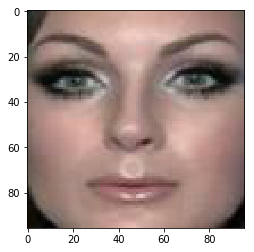

(96, 96, 3)


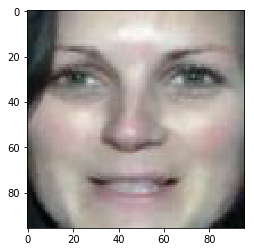

In [0]:
img = plt.imread("gan_makeup_data_96.zip_files/gan_makeup_data_96/with/001_1_y.jpg")
print(img.shape)
plt.imshow(img)
plt.show()
img = plt.imread("gan_makeup_data_96.zip_files/gan_makeup_data_96/without/001_1_n.jpg")
print(img.shape)
plt.imshow(img)
plt.show()